In [1]:
import os
import glob
import numpy as np
import xarray as xr
from scipy.ndimage import rotate
from scipy.integrate import cumtrapz

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
matplotlib.rcParams.update({'font.size':15})
import time
import cartopy.crs as ccrs
import cartopy
CMIP6_FOLDER = "/global/cfs/projectdirs/m3522/cmip6/"
SCRATCH="/global/cscratch1/sd/qnicolas/"

import sys
p = os.path.abspath('/global/homes/q/qnicolas/')
if p not in sys.path:
    sys.path.append(p)
    
from tools.e5tools import *
from orographicConvectionTheory.orographicConvectionTheory import *
from orographicPrecipitation.observationsAndERA5.mountainUtils import *
km_per_degreelat = 6370*np.pi/180
mnths=['jan','feb','mar','apr','may','jun','jul','aug','sep','oct','nov','dec']


import metpy.calc as mpcalc
from metpy.plots import SkewT
from metpy.units import units

xr.set_options(display_style='text') 

In [2]:
def compute_primes(region,varname,month=-1):
    if 'level' in region.vars_rot[varname].dims:
        varL = crossslope_avg(region.vars_rot[varname]).sel(level=slice(700.,900.)).mean('level')
    else:
        varL = crossslope_avg(region.vars_rot[varname])
    varLprime = (varL-varL.sel(x=slice(varL.x[0],varL.x[0]+200)).mean('x'))
    if month<0:
        return varLprime.sel(x=slice(-200,-50)).mean('x')
    else:
        return varLprime.sel(time=(varLprime['time.month']==month),x=slice(-200,-50)).mean('x')
def get_binned(a,b,bins):
    bins=bins[(bins>float(a.min()))&(bins<float(a.max()))]
    bin_centers=(bins[1:]+bins[:-1])/2
    digitized = np.digitize(np.array(a), bins)
    bin_means = np.array([np.array(b)[digitized == i].mean() for i in range(1, len(bins))])
    return bin_centers,bin_means
def sel_month(ds,m):
    return ds.sel(time=(ds['time.month']==m))

from scipy.optimize import curve_fit
def fit_coefs(pred,dep,model='linear'):
    predrange = np.linspace(np.min(pred),np.max(pred),41)
    if model=='linear':
        func = lambda x,a,b : a*x+b
    elif model=='exponential':
        func = lambda x,a,b : np.exp(a*x+b)
    elif model=='softplus':
        func = lambda x,a,b : np.log(1+np.exp(a*x+b))
    popt,_ = curve_fit(func,pred,dep)
    fitrange = func(predrange,*popt)
    residual = dep - func(pred,*popt)
    rss = np.sum(residual**2)
    tss = len(dep)*np.var(dep)
    rsq = 1-rss/tss
    return predrange,fitrange,rsq,popt

def sel_summer(var):
    return var.sel(time = ((var['time.month']>=7)&(var['time.month']<=9)))

In [3]:
from scipy import special
def linregress_xr_2(x,y,dim='time'):
    nt = len(x[dim])
    assert nt==len(y[dim])
    ssxm = nt*x.var(dim=dim)
    ssym = nt*y.var(dim=dim)
    ssxym = nt*xr.cov(x,y,dim=dim)       
    r = np.maximum(np.minimum(ssxym / np.sqrt(ssxm * ssym),1.),-1)
    slope = ssxym / ssxm
    
    df = nt - 2  # Number of degrees of freedom
    TINY = 1.0e-20
    t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
    
    pval = special.stdtr(df, -np.abs(t))*2 * x.isel({dim:0})**0
    
    return xr.merge([slope.rename('slope'),(r**2).rename('rsquared'),pval.rename('pvalue')])

def fdr(pvalues,alpha):
    sortidx = np.argsort(pvalues)
    psorted = pvalues[sortidx]
    psorted[np.isnan(psorted)]=1
    nval = len(pvalues)
    ifdr = np.argmax((psorted < alpha*np.arange(1,nval+1)/nval)[::-1])
    if ifdr == 0 and psorted[-1]>= alpha:
        ifdr=nval-1
    ifdr = nval - ifdr - 1
    return sortidx[:ifdr]

def fdr_xr_2d(pvalues,alpha):
    pvalues=np.array(pvalues)
    assert len(pvalues.shape)==2
    ntot = pvalues.shape[0]*pvalues.shape[1]
    idxs_1d = fdr(pvalues.reshape(-1),alpha)
    flags = np.zeros(ntot)
    flags[idxs_1d] = 1
    return flags.reshape(pvalues.shape)*pvalues**0

In [4]:
# Monthly data loading

orogm=xr.open_dataset(CMIP6_FOLDER+"ERA5/e5.oper.invariant/197901/e5.oper.invariant.128_129_z.ll025sc.1979010100_1979010100.nc").Z.isel(time=0)/9.81
landmask=xr.open_dataset(CMIP6_FOLDER+"ERA5/e5.oper.invariant/197901/e5.oper.invariant.128_172_lsm.ll025sc.1979010100_1979010100.nc").LSM.isel(time=0)
gpm_pr = xr.open_dataarray('/global/cscratch1/sd/qnicolas/temp/GPM-IMERG.monthly.2001-2018.nc')    


In [5]:
gpm_pr_seasmean=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/GPM-IMERG-seasonalmean-200101-201812.nc")
climcapst_climatology = xr.open_zarr("/global/cscratch1/sd/qnicolas/CLIMCAPS_V2/monthly/L3_CLIMCAPS_QCC.air_temp.monthly.zarr").air_temp.groupby('time.month').mean(['time','orbit_pass'])

In [6]:
era5pr_seasmean  =xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.climatology.128_228_tp.2001-2018.nc")
era5100u_seasmean=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.climatology.228_246_100u.2001-2018.nc")
era5100v_seasmean=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.climatology.228_247_100v.2001-2018.nc")

In [7]:
era5pr_monthly  =xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.128_228_tp.2001-2018.nc")
era5100u_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.228_246_100u.2001-2018.nc")
era5100v_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.228_247_100v.2001-2018.nc")

In [8]:
#era5psfc_seasmean =      e5_climatology("128_134_sp",     years=range(2001,2019)); era5psfc_seasmean.to_netcdf("/global/cscratch1/sd/qnicolas/temp/e5.climatology.128_134_sp.2001-2018.nc")
era5psfc_seasmean=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.climatology.128_134_sp.2001-2018.nc")


In [9]:
era5sst_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.128_034_sstk.2001-2018.nc")

# Monthly data

## Composite maps

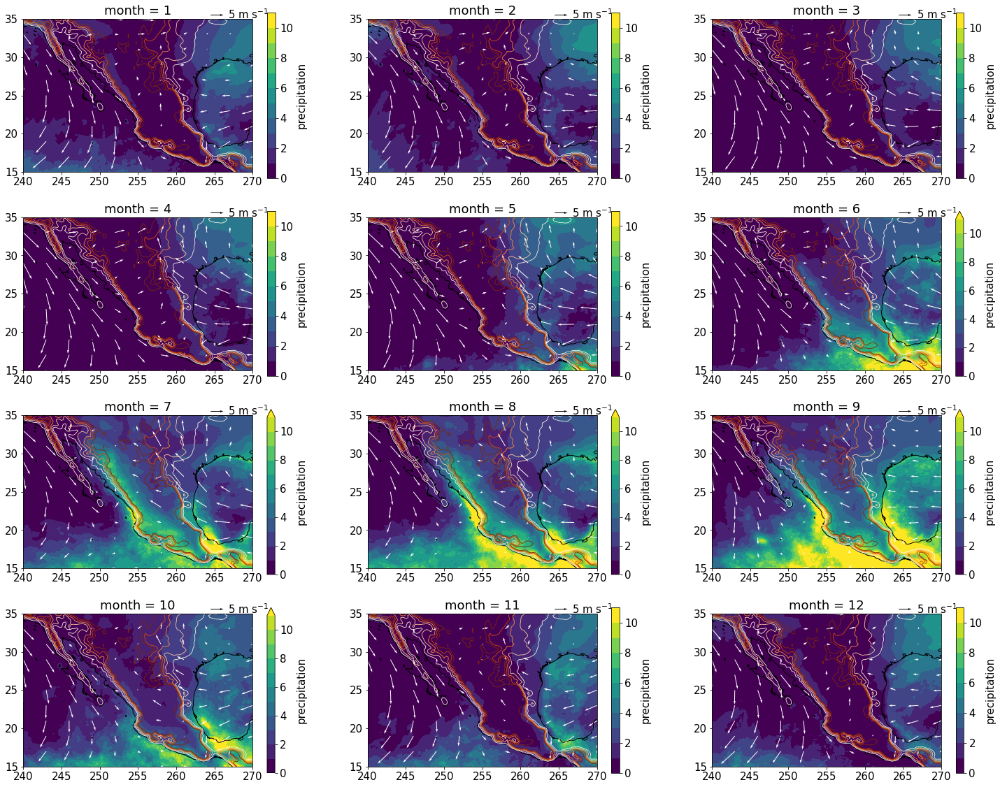

In [22]:
fig,axs = plt.subplots(4,3,figsize=(25,20),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
box = [240,270,15,35]
for m in range(12):
    topography_pr_wind_plot(axs[m],box,sel_box_month(orogm,box,0),
                                   sel_box_month(gpm_pr_seasmean,box,m+1),
                                   sel_box_month(era5100u_seasmean,box,m+1),
                                   sel_box_month(era5100v_seasmean,box,m+1),
                                   np.arange(0,12,1))

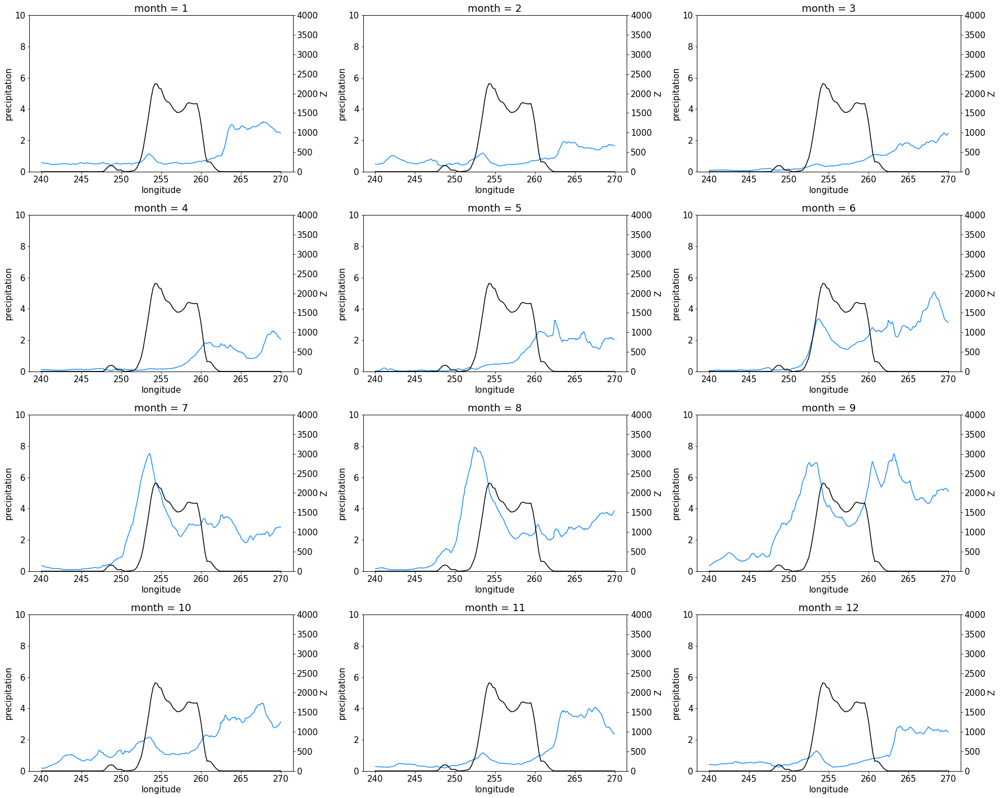

In [28]:
fig,axs = plt.subplots(4,3,figsize=(25,20))
axs=axs.reshape(-1)
box = [240,270,15,35]
for m in range(12):
    ax_mtn = axs[m].twinx()
    sel_box_month(orogm,box,0).sel(latitude=slice(26,24)).mean('latitude').plot(ax=ax_mtn,color='k')
    sel_box_month(gpm_pr_seasmean,box,m+1).sel(latitude=slice(26,24)).mean('latitude').plot(ax=axs[m],color='dodgerblue')
    ax_mtn.set_title('')
    ax_mtn.set_ylim(0,4e3)
    axs[m].set_ylim(0,10)
fig.tight_layout()

Text(0, 0.5, 'Normalized precipitation')

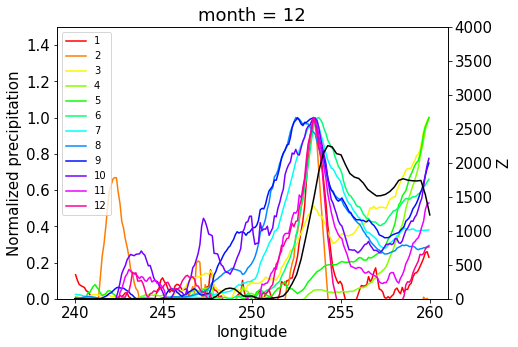

In [36]:
fig,ax = plt.subplots(1,1,figsize=(7,5))
box = [240,270,15,35]
ax_mtn = ax.twinx()
ax_mtn.set_ylim(0,4e3)
orogm.sel(latitude=slice(26,24),longitude=slice(240,260)).mean('latitude').plot(ax=ax_mtn,color='k')
ax_mtn.set_title('')
clrs=plt.cm.hsv(np.linspace(0,1,13))[:-1]
for m in range(12):
    pr = gpm_pr_seasmean.sel(latitude=slice(26,24),longitude=slice(240,260),month=m+1).mean('latitude')
    pprime = pr-pr.sel(longitude=slice(240,245)).mean('longitude')
    (pprime/pprime.max()).plot(ax=ax,color=clrs[m],label=m+1)
ax.set_ylim(0,1.5)
ax.legend(fontsize=10)
ax.set_ylabel('Normalized precipitation')

In [84]:
from orographicPrecipitation.observationsAndERA5.linearWaveModels import linear_w_1layer
from scipy.interpolate import interp1d
orog_smo = orogm.sel(latitude=slice(26,24),longitude=slice(240,270)).mean('latitude')
xx0 = 1e3*np.array((orog_smo.longitude-254)*100)
hx0 = np.array(orog_smo)
xx = np.arange(-6000e3,6000e3,1e3)
hx = interp1d(xx0,hx0,kind='quadratic',bounds_error=False,fill_value=0.)(xx)
#hx = np.interp(xx,xx0,hx0)
w_lineargw = linear_w_1layer(xx,hx,np.linspace(0,10e3,101),12,0.012)
tprime_lineargw,_ = linear_TdL_qdL(xx,hx,10)
tprime_lineargw = tprime_lineargw*w_lineargw.distance_from_mtn**0

In [116]:
_,_,p_smith = smith_theory(xx,hx,10,6e-3,6.5e-3,290)

using moist stability, N=0.004 s^-1


In [118]:
p_us = linear_precip_theory(xx,hx,10,tauT=7.5,tauq=27.5)

(-2000.0, 2000.0)

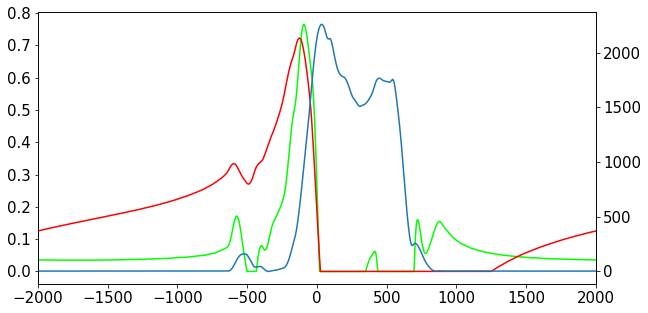

In [121]:
fig,ax = plt.subplots(1,1,figsize=(10,5))
ax_mtn = ax.twinx()
#w_lineargw.sel(altitude=slice(1,3)).mean('altitude').plot(ax=ax)
ax_mtn.plot(xx/1000,hx)

xx = np.arange(-2000e3,2000e3,1e3)
hx = interp1d(xx0,hx0,kind='quadratic',bounds_error=False,fill_value=0.)(xx)
#w_lineargw = linear_w_1layer(xx,hx,np.linspace(0,10e3,101),12,0.012)
#w_lineargw.sel(altitude=slice(1,3)).mean('altitude').plot(ax=ax)
#(10*w_lineargw*np.exp(-w_lineargw.altitude/0.5)).integrate('altitude').plot(ax=ax)
ax.plot(xx/1000,p_smith/200,color='lime')
ax.plot(xx/1000,p_us/90,color='r')

plt.xlim(-2000,2000)

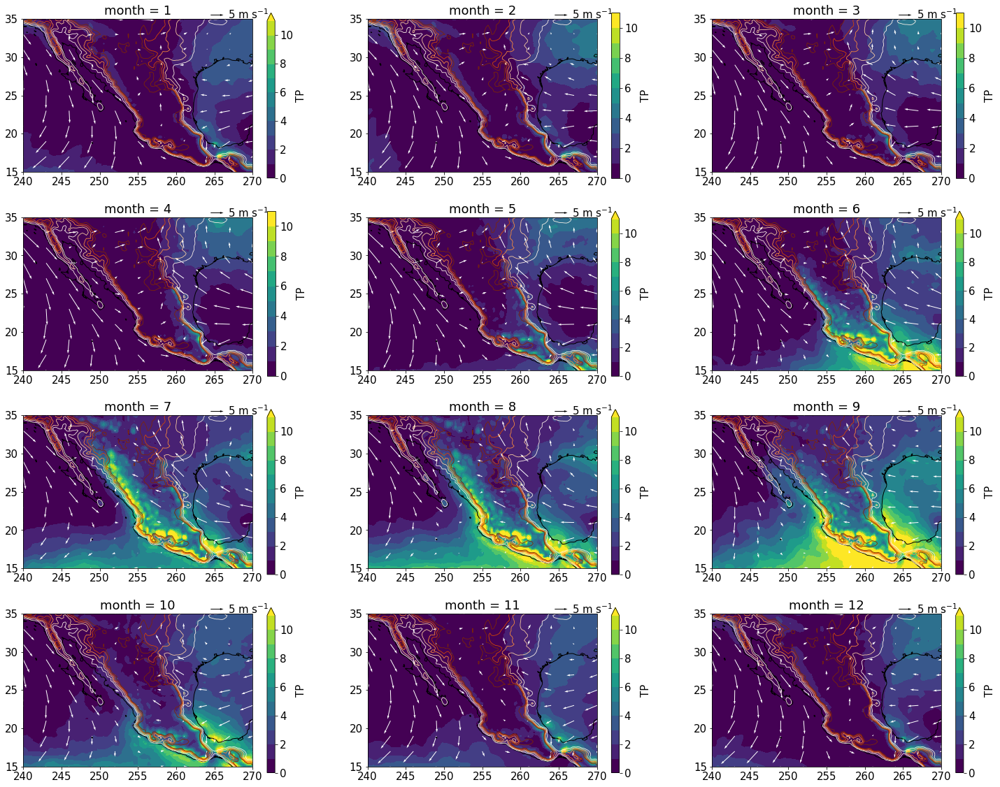

In [25]:
fig,axs = plt.subplots(4,3,figsize=(25,20),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
box = [240,270,15,35]
for m in range(12):
    topography_pr_wind_plot(axs[m],box,sel_box_month(orogm,box,0),
                                   sel_box_month(era5pr_seasmean,box,m+1),
                                   sel_box_month(era5100u_seasmean,box,m+1),
                                   sel_box_month(era5100v_seasmean,box,m+1),
                                   np.arange(0,12,1))

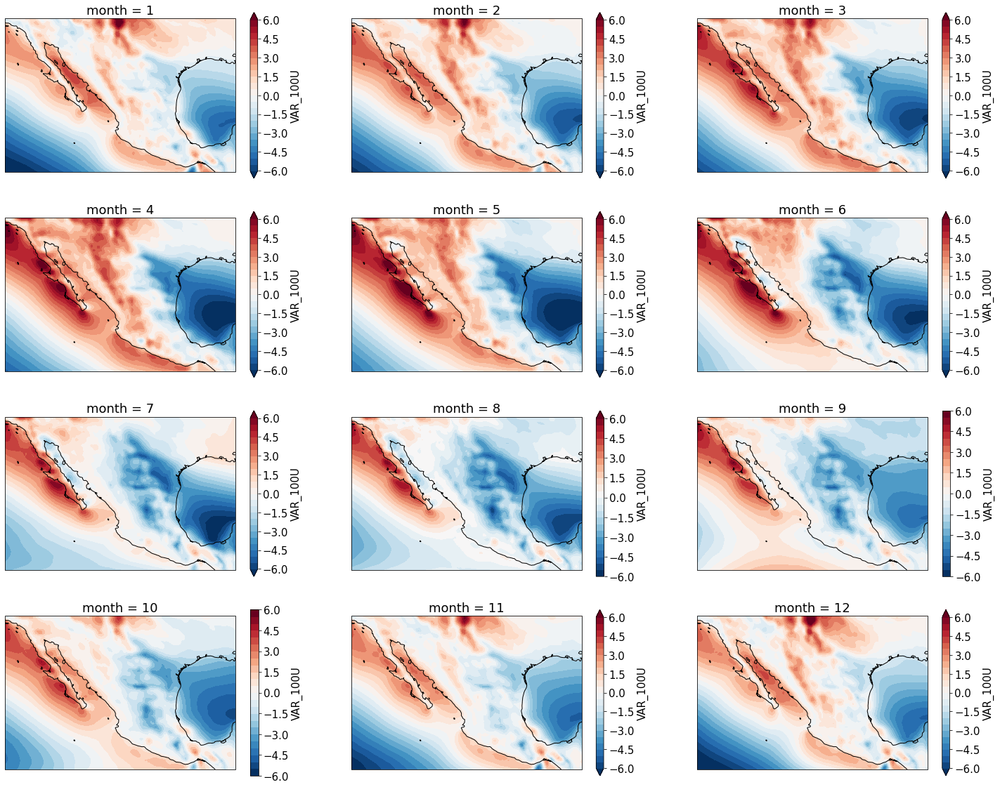

In [24]:
fig,axs = plt.subplots(4,3,figsize=(25,20),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
box = [240,270,15,35]
for m in range(12):
    sel_box_month(era5100u_seasmean,box,m+1).plot.contourf(ax=axs[m],levels=np.arange(-6,6.1,0.5))
    axs[m].coastlines()

## Data loading

In [10]:
#mountaintop=1700. # abscissa of mountain top within rotated frame
SMO = MountainRangeCustom("smo"      ,[240,270,15,35]   ,"Sierra Madre Occidental",60 ,[7,8,9]  ,[254, 21, 249, 27.5, 3],path = "/global/cscratch1/sd/qnicolas/regionsData/")

SMO.set_2dvar('GPM_PR',gpm_pr_seasmean)
SMO.set_2dvar('E5_PR',era5pr_seasmean)
SMO.set_2dvar('VAR_100U',era5100u_seasmean)
SMO.set_2dvar('VAR_100V',era5100v_seasmean)
SMO.set_2dvar('Z',orogm)
SMO.set_2dvar('SP',era5psfc_seasmean)
SMO.set_uperp()

SMO.set_3dvar('T',"128_130_t")
SMO.set_3dvar('W',"128_135_w")
SMO.set_3dvar('Q',"128_133_q")
SMO.set_3dvar('U',"128_131_u")
SMO.set_3dvar('V',"128_132_v")
SMO.set_uperp3d()

SMO.set_4dvar('T4D',"128_130_t")
SMO.set_4dvar('Q4D',"128_133_q")
SMO.set_4dvar('U4D',"128_131_u")
SMO.set_4dvar('V4D',"128_132_v")
SMO.set_othervar('GPM_PR_3D',sel_box(gpm_pr,SMO.box))
SMO.set_othervar('E5_PR_3D',sel_box(era5pr_monthly,SMO.box))
SMO.set_othervar('SST_3D',sel_box(era5sst_monthly,SMO.box))

box_climcaps = [240-360,270-360,15,30]
SMO.set_othervar('CLIMCAPS_T',sel_box_months(climcapst_climatology,box_climcaps,SMO.months).assign_coords(level=climcapst_climatology.air_pres/100).swap_dims({'air_pres':'level'}))

SMO.set_othervar('VAR_100U_3D',sel_box(era5100u_monthly,SMO.box))
SMO.set_othervar('VAR_100V_3D',sel_box(era5100v_monthly,SMO.box))
SMO.set_othervar('VAR_100U_3D_PERP',crossslopeflow(SMO.vars['VAR_100U_3D'], SMO.vars['VAR_100V_3D'],SMO.angle))
SMO.set_othervar('VAR_100U_3D_PARA',crossslopeflow(SMO.vars['VAR_100U_3D'], SMO.vars['VAR_100V_3D'],SMO.angle-90))

/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [11]:
SMO.precipmask = tilted_rect(SMO.vars['GPM_PR'],*SMO.box_tilted)*landmask.interp_like(SMO.vars['GPM_PR'])


In [12]:
from orographicPrecipitation.precip_model_functions import qsat
leveldim = SMO.vars['T4D'].level
tb = SMO.vars['T4D'].where((leveldim*1e2<=SMO.vars['SP'])&(leveldim>=850)).mean('level')
qb = SMO.vars['Q4D'].where((leveldim*1e2<=SMO.vars['SP'])&(leveldim>=850)).mean('level')
SMO.vars['EB4D'] = tb+2.5e3*qb
SMO.vars['TL4D'] = SMO.vars['T4D'].sel(level=slice(500,849)).mean('level')
SMO.vars['QL4D'] = SMO.vars['Q4D'].sel(level=slice(500,849)).mean('level')
qLstar = qsat(SMO.vars['T4D'].sel(level=slice(500,849)),SMO.vars['T4D'].sel(level=slice(500,849)).level).mean('level')
eL = SMO.vars['TL4D']+2.5e3*SMO.vars['QL4D']
eLstar = SMO.vars['TL4D']+2.5e3*qLstar

SMO.vars['BLSIMPLE4D'] = compute_BLsimple(SMO.vars['EB4D'],eL,eLstar,kind='deep')


In [13]:
SMO.vars['UL4D'] = SMO.vars['U4D'].sel(level=slice(500,849)).mean('level')
SMO.vars['VL4D'] = SMO.vars['V4D'].sel(level=slice(500,849)).mean('level')


## Maps

In [33]:
def topography_pr_wind_plot(ax,box,z,pr,u,v,prlevs=None,windvect_density=10,scale=90,**plot_kwargs):
    ax.coastlines(linewidth=2.5,color='gray')
    z.plot.contour(ax=ax,transform=ccrs.PlateCarree(),cmap=plt.cm.Oranges,levels=np.arange(250.,1500.,250.),linewidths=0.8)

    if prlevs is None:
        prlevs = np.linspace(0,np.ceil(pr.max()/10)*10,21)
    pr.plot.contourf(ax=ax,levels=prlevs,**plot_kwargs)
    
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = u.longitude.expand_dims({"latitude":u.latitude})
    n=int(len(u.latitude) *windvect_density)
    m=int(len(u.longitude)*windvect_density)
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=scale)
    qk = ax.quiverkey(q, 0.87, 1.03, 5, r'5 m s$^{-1}$', labelpos='E',
                           coordinates='axes',color='k')
    dl=5
    
    lats=range(dl*(1+(int(box[2])-1)//dl),dl*(int(box[3])//dl)+1,dl)
    lons=range(dl*(1+(int(box[0])-1)//dl),dl*(int(box[1])//dl)+1,dl)
    ax.set_xticks([(lon+180)%360-180 for lon in lons])
    ax.set_xticklabels(lons)
    ax.set_yticks(lats)
    ax.set_yticklabels(lats)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_ylim((box[2],box[3]))

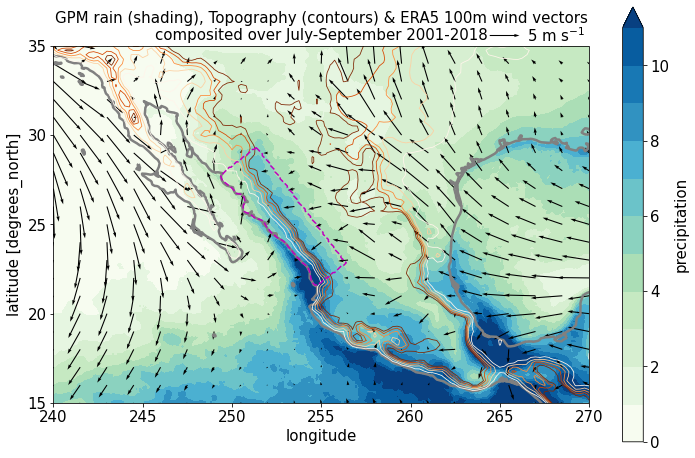

In [34]:
fig,ax = plt.subplots(1,1,figsize=(12,8),subplot_kw={"projection":ccrs.PlateCarree()})
topography_pr_wind_plot(ax,SMO.box,SMO.vars['Z'],SMO.vars['GPM_PR'],SMO.vars['VAR_100U'],SMO.vars['VAR_100V'],np.arange(0,12,1),windvect_density=0.05,cmap=plt.cm.GnBu)

SMO.precipmask.plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['m'])


ax.set_title("GPM rain (shading), Topography (contours) & ERA5 100m wind vectors\ncomposited over July-September 2001-2018",fontsize=15);None



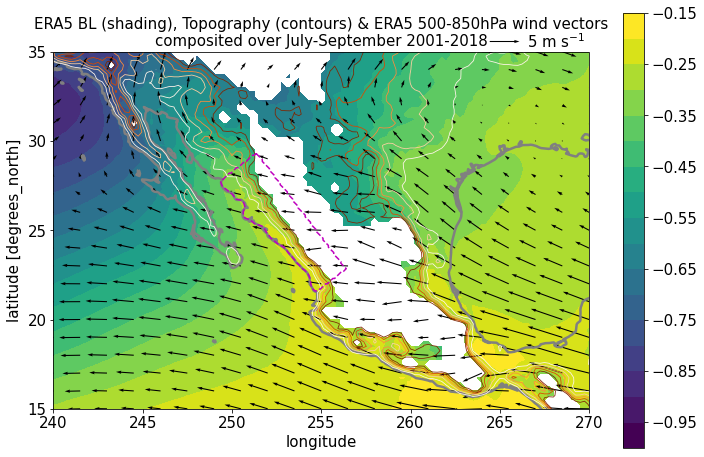

In [42]:
fig,ax = plt.subplots(1,1,figsize=(12,8),subplot_kw={"projection":ccrs.PlateCarree()})
topography_pr_wind_plot(ax,SMO.box,SMO.vars['Z'],sel_summer(SMO.vars['BLSIMPLE4D']).mean('time'),sel_summer(SMO.vars['UL4D']).mean('time'),sel_summer(SMO.vars['VL4D']).mean('time'),np.arange(-1,-0.1,0.05),windvect_density=0.05,cmap=plt.cm.viridis)

SMO.precipmask.plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['m'])

ax.set_title("ERA5 BL (shading), Topography (contours) & ERA5 500-850hPa wind vectors\ncomposited over July-September 2001-2018",fontsize=15);None



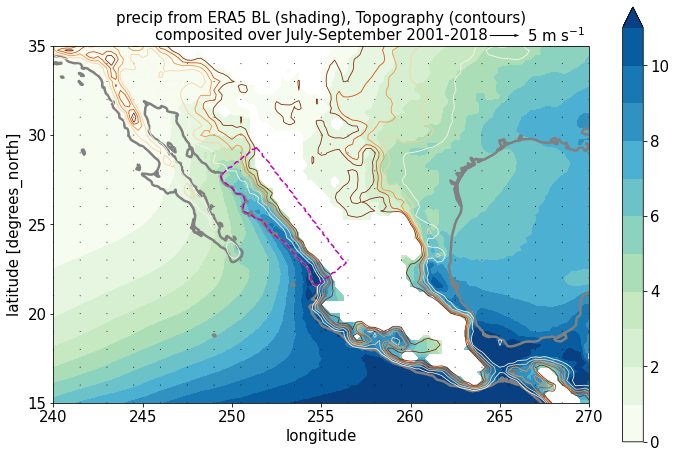

In [45]:
fig,ax = plt.subplots(1,1,figsize=(12,8),subplot_kw={"projection":ccrs.PlateCarree()})
topography_pr_wind_plot(ax,SMO.box,SMO.vars['Z'],fit_func_monthly(sel_summer(SMO.vars['BLSIMPLE4D']).mean('time')),0*sel_summer(SMO.vars['UL4D']).mean('time'),0*sel_summer(SMO.vars['VL4D']).mean('time'),np.arange(0,12,1),windvect_density=0.05,cmap=plt.cm.GnBu)

SMO.precipmask.plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['m'])

ax.set_title("precip from ERA5 BL (shading), Topography (contours)\ncomposited over July-September 2001-2018",fontsize=15);None



In [17]:
def plot_xz(ax,region,varname,pert=False,fact=1,center=0.5,halfwidth=0.25,**plot_kwargs):
    if pert:
        cv=crossslope_avg(fact*region.vars_rot[varname],center=center,halfwidth=halfwidth)
        (cv-cv.sel(x=slice(-400,-300)).mean('x')).plot.contourf(ax=ax,yincrease=False,**plot_kwargs)
    else:
        crossslope_avg(fact*region.vars_rot[varname],center=center,halfwidth=halfwidth).plot.contourf(ax=ax,yincrease=False,**plot_kwargs)
    p_sfc = crossslope_avg(999-region.vars_rot['Z']/(1.1*9.81),center=center,halfwidth=halfwidth)
    p_sfc.plot(ax=ax,color='k')
    ax.fill_between(p_sfc.x,0*p_sfc+1000.,p_sfc,color='w')

Text(0.5, 1.0, 'Perturbation q climatology (nondim)')

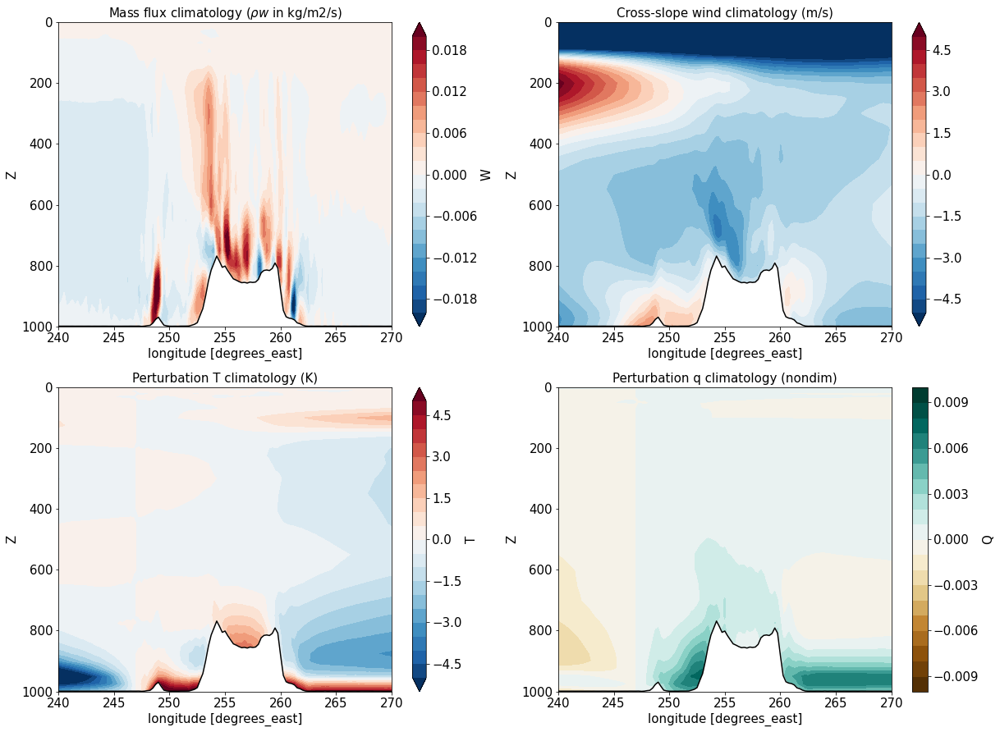

In [27]:
fig,axs = plt.subplots(2,2,figsize=(20,15))
axs=axs.reshape(-1)
lat0=25;lon0=247
(-1/9.81*SMO.vars['W']).sel(latitude=lat0).plot.contourf(ax=axs[0],levels=np.linspace(-0.02,0.02,21))
SMO.vars['U_PERP'].sel(latitude=lat0).plot.contourf(ax=axs[1],levels=np.linspace(-5,5,21))
(SMO.vars['T'].sel(latitude=lat0)-SMO.vars['T'].sel(latitude=lat0,longitude=lon0)).plot.contourf(ax=axs[2],levels=np.linspace(-5,5,21))
(SMO.vars['Q'].sel(latitude=lat0)-SMO.vars['Q'].sel(latitude=lat0,longitude=lon0)).plot.contourf(ax=axs[3],levels=np.linspace(-0.01,0.01,21),cmap=plt.cm.BrBG)

for ax in axs:
    ax.set_ylim(1000,0)
    p_sfc = 999-SMO.vars['Z'].sel(latitude=lat0)/(1.1*9.81)
    p_sfc.plot(ax=ax,color='k')
    ax.fill_between(p_sfc.longitude,0*p_sfc+1000.,p_sfc,color='w')

axs[0].set_title(r'Mass flux climatology ($\rho w$ in kg/m2/s)',fontsize=15)
axs[1].set_title(r'Cross-slope wind climatology (m/s)',fontsize=15)
axs[2].set_title(r'Perturbation T climatology (K)',fontsize=15)
axs[3].set_title(r'Perturbation q climatology (nondim)',fontsize=15)

Text(0.5, 1.0, 'Perturbation q climatology (nondim)')

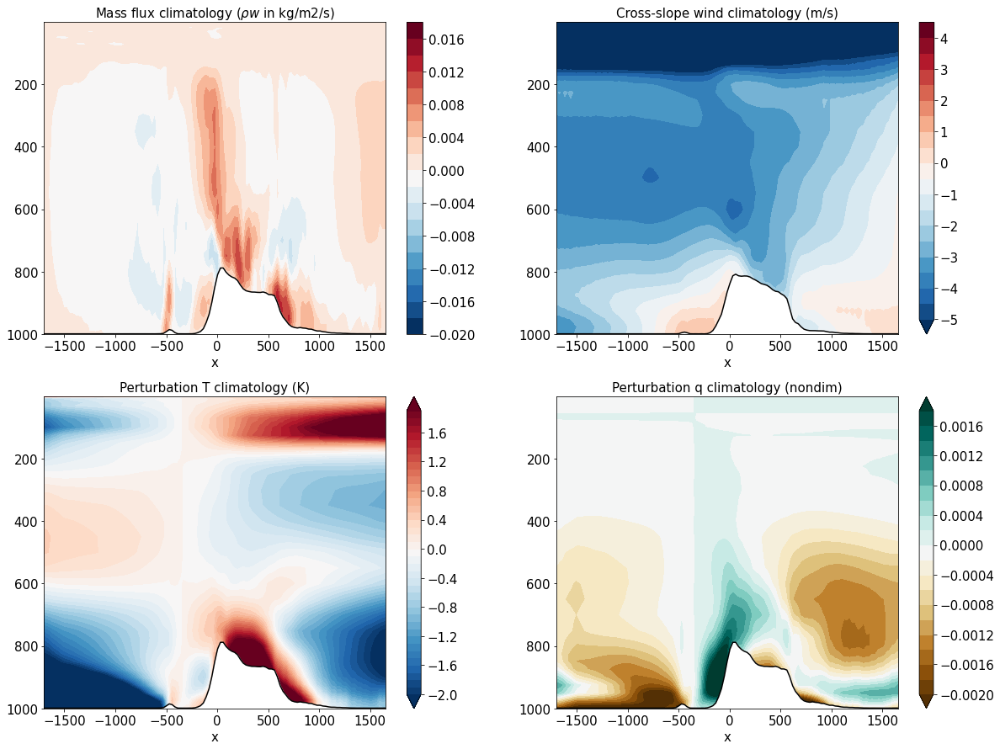

In [ ]:
fig,ax = plt.subplots(2,2,figsize=(20,15))
ax=ax.reshape(-1)
plot_xz(ax[0],SMO,'W',center=smo_center,levels=np.arange(-0.02,0.02,0.002),fact=-1/9.81)
plot_xz(ax[1],SMO,'U_PERP',levels=np.arange(-5,5,0.5))
plot_xz(ax[2],SMO,'T',center=smo_center,pert=True,levels=np.arange(-2,2,0.1))
plot_xz(ax[3],SMO,'Q',center=smo_center,pert=True,levels=np.arange(-0.002,0.002,0.0002),cmap=plt.cm.BrBG)

ax[0].set_title(r'Mass flux climatology ($\rho w$ in kg/m2/s)',fontsize=15)
ax[1].set_title(r'Cross-slope wind climatology (m/s)',fontsize=15)
ax[2].set_title(r'Perturbation T climatology (K)',fontsize=15)
ax[3].set_title(r'Perturbation q climatology (nondim)',fontsize=15)

## Seasonal cycle

In [49]:

gpm_pr_allmonths    = spatial_mean( SMO.vars['GPM_PR_3D'],mask=precipmask).load()
uperp100_allmonths    = spatial_mean(SMO.vars['VAR_100U_3D_PERP'],mask=windmask).load()


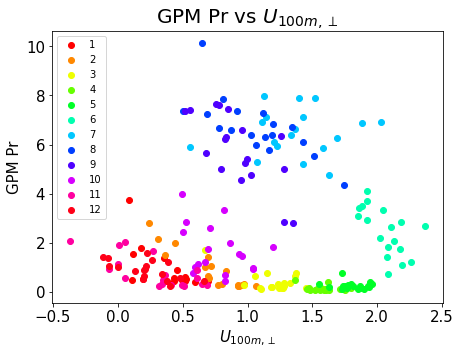

In [76]:
fig,ax = plt.subplots(1,1,figsize=(7,5))
colors=plt.cm.hsv(np.linspace(0,1,12))
for m in range(12):
    ax.scatter(sel_month(uperp100_allmonths,m+1),sel_month(gpm_pr_allmonths,m+1),color=colors[m],label=m+1)
    
#ax.plot(*get_binned(uperp100_allmonths,gpm_pr_allmonths,np.arange(-3,9,0.5)),'-x')


ax.set_title(r'GPM Pr vs $U_{100m,\perp}$' ,fontsize=20)
ax.set_xlabel(r"$U_{100m,\perp}$")
ax.set_ylabel(r"GPM Pr")
ax.legend(loc=2,fontsize=10)

In [154]:
u100_allmonths    = spatial_mean(SMO.vars['VAR_100U_3D'],mask=windmask).load()


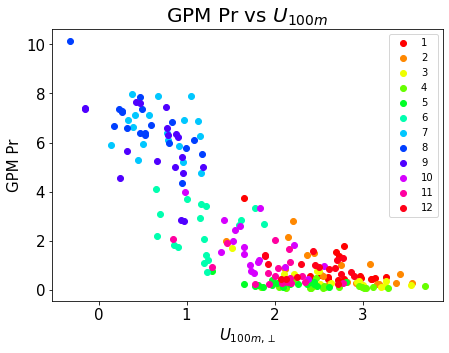

In [156]:
fig,ax = plt.subplots(1,1,figsize=(7,5))
colors=plt.cm.hsv(np.linspace(0,1,12))
for m in range(12):
    ax.scatter(sel_month(u100_allmonths,m+1),sel_month(gpm_pr_allmonths,m+1),color=colors[m],label=m+1)
    
#ax.plot(*get_binned(uperp100_allmonths,gpm_pr_allmonths,np.arange(-3,9,0.5)),'-x')


ax.set_title(r'GPM Pr vs $U_{100m}$' ,fontsize=20)
ax.set_xlabel(r"$U_{100m,\perp}$")
ax.set_ylabel(r"GPM Pr")
ax.legend(loc=1,fontsize=10)

In [77]:
upara100_allmonths    = spatial_mean(SMO.vars['VAR_100U_3D_PARA'],mask=windmask).load()


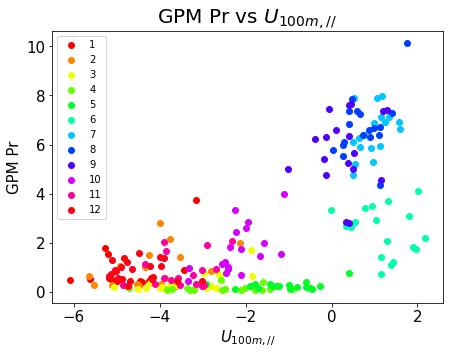

In [78]:
fig,ax = plt.subplots(1,1,figsize=(7,5))
colors=plt.cm.hsv(np.linspace(0,1,12))
for m in range(12):
    ax.scatter(sel_month(upara100_allmonths,m+1),sel_month(gpm_pr_allmonths,m+1),color=colors[m],label=m+1)
    
ax.set_title(r'GPM Pr vs $U_{100m,//}$' ,fontsize=20)
ax.set_xlabel(r"$U_{100m,//}$")
ax.set_ylabel(r"GPM Pr")
ax.legend(loc=2,fontsize=10)

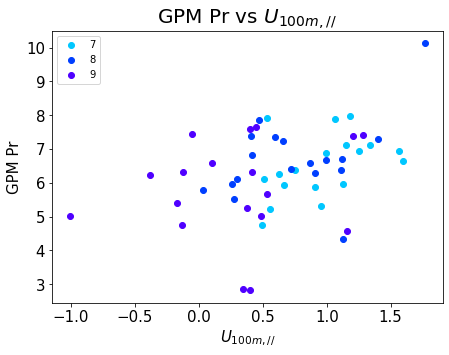

In [80]:
fig,ax = plt.subplots(1,1,figsize=(7,5))
colors=plt.cm.hsv(np.linspace(0,1,12))
for m in range(6,9):
    ax.scatter(sel_month(upara100_allmonths,m+1),sel_month(gpm_pr_allmonths,m+1),color=colors[m],label=m+1)
    
ax.set_title(r'GPM Pr vs $U_{100m,//}$' ,fontsize=20)
ax.set_xlabel(r"$U_{100m,//}$")
ax.set_ylabel(r"GPM Pr")
ax.legend(loc=2,fontsize=10)

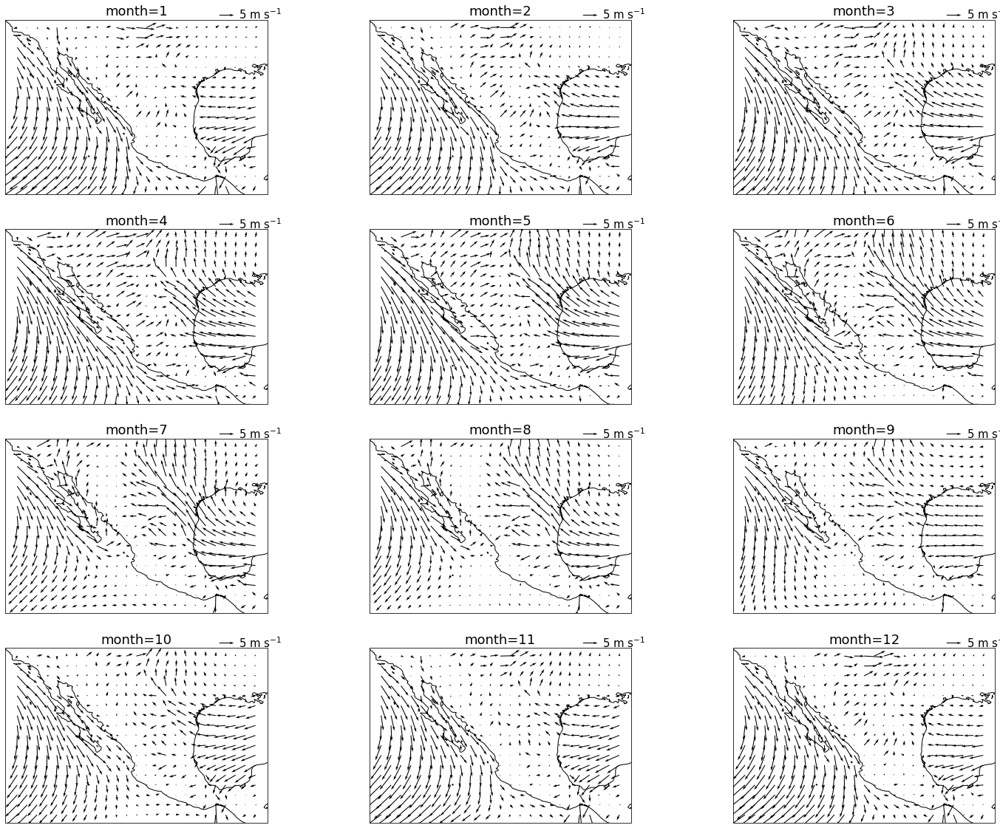

In [229]:
fig,axs = plt.subplots(4,3,figsize=(25,20),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
box = [240,270,15,35]
for mo in range(12):
    ax=axs[mo]
    u = sel_box_month(era5100u_seasmean,box,mo+1)
    v = sel_box_month(era5100v_seasmean,box,mo+1)
    
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = u.longitude.expand_dims({"latitude":u.latitude})
    windvect_density=100
    n=5#int(windvect_density*len(u.latitude))
    m=5#int(windvect_density*len(u.longitude))
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.003,scale=90)
    qk = ax.quiverkey(q, 0.87, 1.03, 5, r'5 m s$^{-1}$', labelpos='E',
                           coordinates='axes',color='k')
    dl=5
    axs[mo].coastlines()
    ax.set_title('month=%i'%(mo+1))

## BL seasonal cycle

In [186]:
pr_seascycle = spatial_mean(SMO.vars['GPM_PR_3D'].groupby('time.month').mean(),box=None,mask=SMO.precipmask)
tL_seascycle = spatial_mean(SMO.vars['TL4D'].groupby('time.month').mean(),box=None,mask=SMO.precipmask)
qL_seascycle = spatial_mean(SMO.vars['QL4D'].groupby('time.month').mean(),box=None,mask=SMO.precipmask)
eb_seascycle = spatial_mean(SMO.vars['EB4D'].groupby('time.month').mean(),box=None,mask=SMO.precipmask)
BL_seascycle = spatial_mean(SMO.vars['BLSIMPLE4D'].groupby('time.month').mean(),box=None,mask=SMO.precipmask)

a=6.69,b=3.82


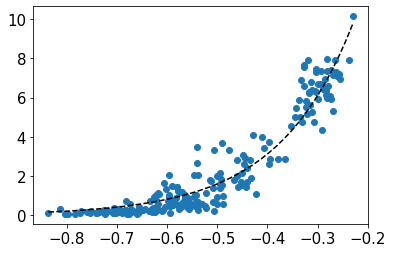

In [181]:
BL_allmonths = spatial_mean(SMO.vars['BLSIMPLE4D'],box=None,mask=SMO.precipmask)
pr_allmonths = spatial_mean(SMO.vars['GPM_PR_3D'],box=None,mask=SMO.precipmask)
x,y,_,popt = fit_coefs(np.array(BL_allmonths),np.array(pr_allmonths),'exponential')
plt.scatter(BL_allmonths,pr_allmonths)
plt.plot(x,y,color='k',linestyle='--')

fit_func = lambda bl: np.exp(popt[0]*bl+popt[1])
print("a=%.2f,b=%.2f"%(popt[0],popt[1]))

In [16]:
fit_func_monthly =  lambda bl: np.exp(6.69*bl+3.82)

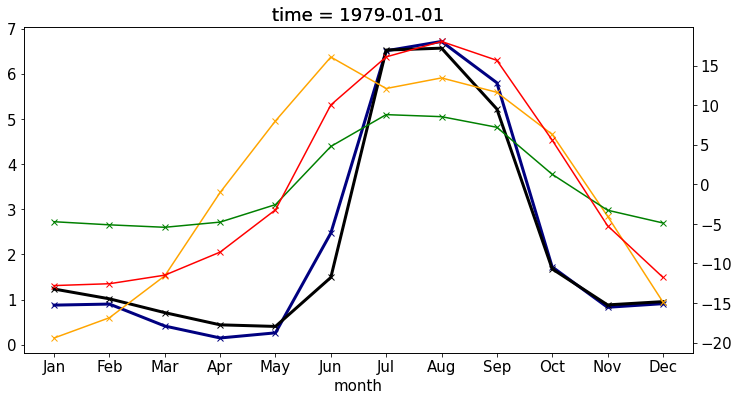

In [187]:
monthnames=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']
_,ax=plt.subplots(1,1,figsize=(12,6))
ax2=ax.twinx()
pr_seascycle.plot(ax=ax,color='navy',marker='x',linewidth=3)

(5*(tL_seascycle-tL_seascycle.mean())).plot(ax=ax2,marker='x',color='orange')
(2.5e3*(qL_seascycle-qL_seascycle.mean())).plot(ax=ax2,marker='x',color='g')
(eb_seascycle-eb_seascycle.mean()).plot(ax=ax2,marker='x',color='r')

#ax3=ax.twinx()
#BL_seascycle.plot(ax=ax3,marker='x',color='k',linewidth=3)

fit_func(BL_seascycle).plot(ax=ax,marker='x',color='k',linewidth=3)


ax.set_xticks(range(1,13))
ax.set_xticklabels(monthnames);None

In [94]:
uL = SMO.vars['U4D'].where(SMO.vars['Q4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').groupby('time.month').mean('time')
vL = SMO.vars['V4D'].where(SMO.vars['Q4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').groupby('time.month').mean('time')

In [101]:
u100 = SMO.vars['VAR_100U_3D'].groupby('time.month').mean('time')
v100 = SMO.vars['VAR_100V_3D'].groupby('time.month').mean('time')

In [111]:
tL_seasmean = tL.groupby('time.month').mean()
qL_seasmean = qL.groupby('time.month').mean()
eb_seasmean = eb.groupby('time.month').mean()
BL_seasmean = BLsimple.groupby('time.month').mean()
pr_seasmean = SMO.vars['GPM_PR_3D'].groupby('time.month').mean()

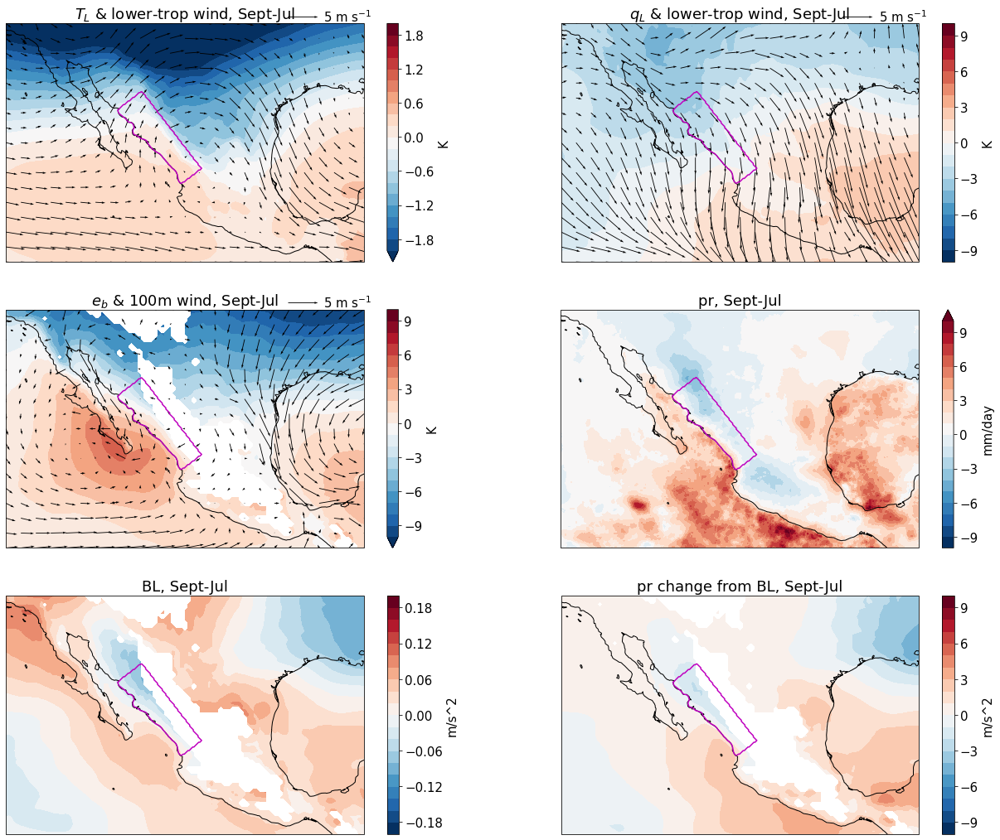

In [126]:


fig,axs = plt.subplots(3,2,figsize=(11*2,18),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs:
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')

ax=axs[0]
(tL_seasmean.sel(month=9)-tL_seasmean.sel(month=7)).plot.contourf(ax=ax,levels=np.linspace(-2,2,21),cbar_kwargs={'label':'K'})
ax.set_title(r'$T_L$ & lower-trop wind, Sept-Jul')

ax=axs[1]
(2.5e3*(qL_seasmean.sel(month=9)-qL_seasmean.sel(month=7))).plot.contourf(ax=ax,levels=np.linspace(-10,10,21),cbar_kwargs={'label':'K'})
ax.set_title(r'$q_L$ & lower-trop wind, Sept-Jul')

ax=axs[2]
(eb_seasmean.sel(month=9)-eb_seasmean.sel(month=7)).plot.contourf(ax=ax,levels=np.linspace(-10,10,21),cbar_kwargs={'label':'K'})
ax.set_title(r'$e_b$ & 100m wind, Sept-Jul')

ax=axs[3]
(pr_seasmean.sel(month=9)-pr_seasmean.sel(month=7)).plot.contourf(ax=ax,levels=np.linspace(-10,10,21),cbar_kwargs={'label':'mm/day'})
ax.set_title(r'pr, Sept-Jul')


ax=axs[4]
(BL_seasmean.sel(month=9)-BL_seasmean.sel(month=7)).plot.contourf(ax=ax,levels=np.linspace(-0.2,0.2,21),cbar_kwargs={'label':'m/s^2'})
ax.set_title(r'BL, Sept-Jul')

ax=axs[5]
(fit_func(BL_seasmean.sel(month=9))-fit_func(BL_seasmean.sel(month=7))).plot.contourf(ax=ax,levels=np.linspace(-10,10,21),cbar_kwargs={'label':'m/s^2'})
ax.set_title(r'pr change from BL, Sept-Jul')



for ax,u,v in zip(axs,
                  (uL.sel(month=9)-uL.sel(month=7),uL.sel(month=9)-uL.sel(month=7),u100.sel(month=9)-u100.sel(month=7)),
                  (vL.sel(month=9)-vL.sel(month=7),uL.sel(month=9)-vL.sel(month=7),v100.sel(month=9)-v100.sel(month=7))):
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color='k',width=0.002,scale=60)
    qk = ax.quiverkey(q, 0.87, 1.03, 5, r'5 m s$^{-1}$', labelpos='E',
                       coordinates='axes',color='k')



## Rainy months analysis & regression maps

In [15]:
windmask = tilted_rect(SMO.vars['VAR_100U'],*SMO.box_tilted)*(1-landmask.interp_like(SMO.vars['VAR_100U']))#[253, 22, 248.5, 27.5, 3]
gpm_pr_allmonths    = spatial_mean( SMO.vars['GPM_PR_3D'],mask=SMO.precipmask).load()
uperp100_allmonths    = spatial_mean(SMO.vars['VAR_100U_3D_PERP'],mask=windmask).load()

gpm_pr_summermonths = sel_summer(gpm_pr_allmonths)
gpm_pr_rainycond = gpm_pr_summermonths>float(gpm_pr_summermonths.quantile(0.9,"time"))

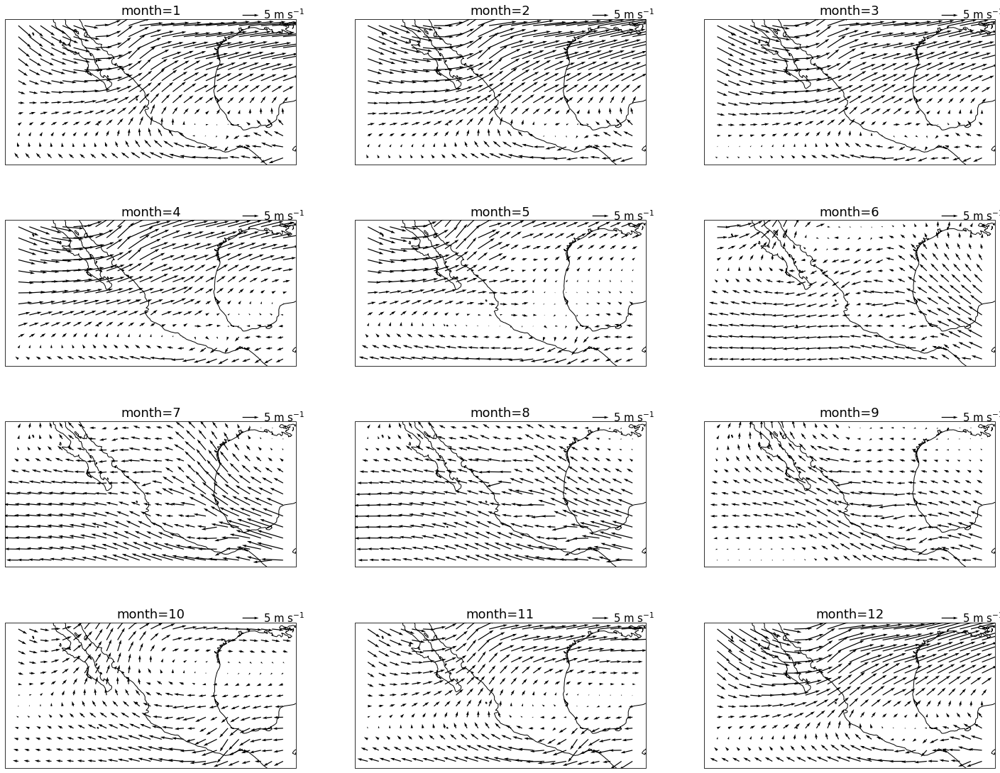

In [53]:
fig,axs = plt.subplots(4,3,figsize=(25,20),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
lev=700
u_seasmean=SMO.vars['U4D'].sel(level=lev).groupby('time.month').mean()
v_seasmean=SMO.vars['V4D'].sel(level=lev).groupby('time.month').mean()
for mo in range(12):
    ax=axs[mo]
    u = u_seasmean.sel(month=mo+1)
    v = v_seasmean.sel(month=mo+1)
    
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = u.longitude.expand_dims({"latitude":u.latitude})
    windvect_density=100
    n=5#int(windvect_density*len(u.latitude))
    m=5#int(windvect_density*len(u.longitude))
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.003,scale=90)
    qk = ax.quiverkey(q, 0.87, 1.03, 5, r'5 m s$^{-1}$', labelpos='E',
                           coordinates='axes',color='k')
    dl=5
    axs[mo].coastlines()
    ax.set_title('month=%i'%(mo+1))

In [47]:
lev=700.
uperp_z_allmonths    = spatial_mean(crossslopeflow(SMO.vars['U4D'].sel(level=lev),SMO.vars['V4D'].sel(level=lev),SMO.angle),
                                    mask=windmask).load()


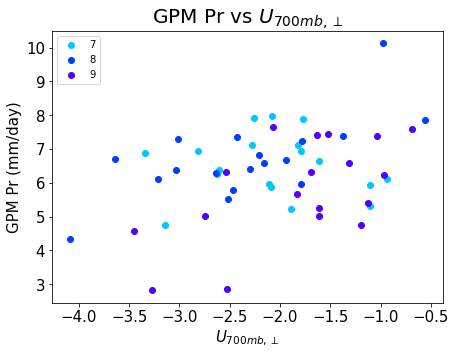

In [54]:
fig,ax = plt.subplots(1,1,figsize=(7,5))
colors=plt.cm.hsv(np.linspace(0,1,12))
for m in range(6,9):
    ax.scatter(sel_month(uperp_z_allmonths,m+1),sel_month(gpm_pr_allmonths,m+1),color=colors[m],label=m+1)
    
ax.set_title(r'GPM Pr vs $U_{700mb,\perp}$' ,fontsize=20)
ax.set_xlabel(r"$U_{700mb,\perp}$")
ax.set_ylabel(r"GPM Pr (mm/day)")
ax.legend(loc=2,fontsize=10)

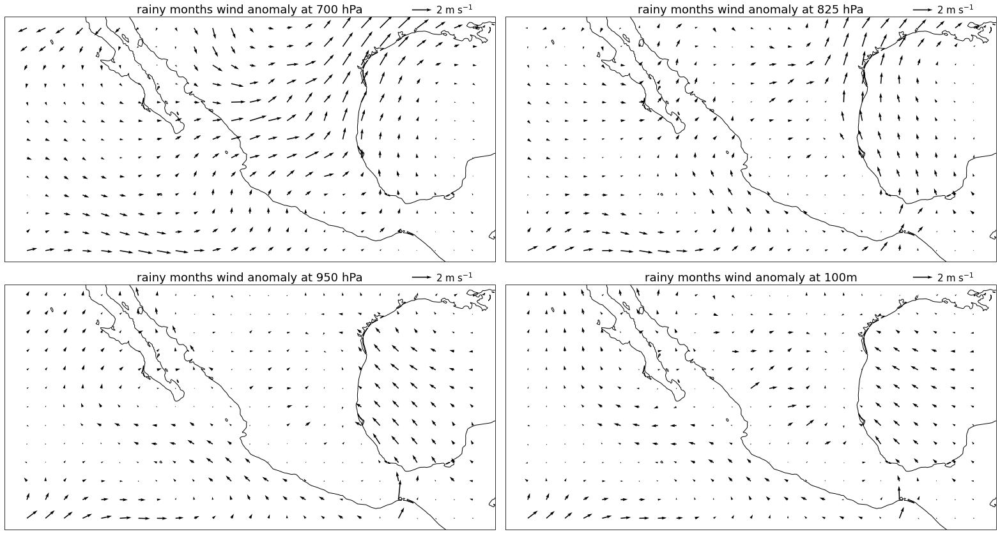

In [13]:
def plot_u_anom(condition,levs):
    fig,axs = plt.subplots(2,2,figsize=(11*2,6*2),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
    axs=axs.reshape(-1)
    levs.append(-1)
    for ax,lev in zip(axs,levs):
        if lev==-1:
            u_z_rainymonths = sel_summer(SMO.vars['VAR_100U_3D'])[np.array(condition)]
            v_z_rainymonths = sel_summer(SMO.vars['VAR_100V_3D'])[np.array(condition)]
            u = u_z_rainymonths.mean('time') - SMO.vars['VAR_100U']
            v = v_z_rainymonths.mean('time') - SMO.vars['VAR_100V']
        else:
            u_z_rainymonths = sel_summer(SMO.vars['U4D'].sel(level=lev))[np.array(condition)]
            v_z_rainymonths = sel_summer(SMO.vars['V4D'].sel(level=lev))[np.array(condition)]
            u = u_z_rainymonths.mean('time') - SMO.vars['U'].sel(level=lev)
            v = v_z_rainymonths.mean('time') - SMO.vars['V'].sel(level=lev)
        
        X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
        Y = u.longitude.expand_dims({"latitude":u.latitude})
        n=5
        m=5
        q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=50)
        qk = ax.quiverkey(q, 0.87, 1.03, 2, r'2 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
        ax.coastlines()
        if lev==-1:
            ax.set_title('rainy months wind anomaly at 100m')
        else:
            ax.set_title('rainy months wind anomaly at %i hPa'%lev)
    fig.tight_layout()

plot_u_anom(gpm_pr_rainycond,[700.,825.,950.])

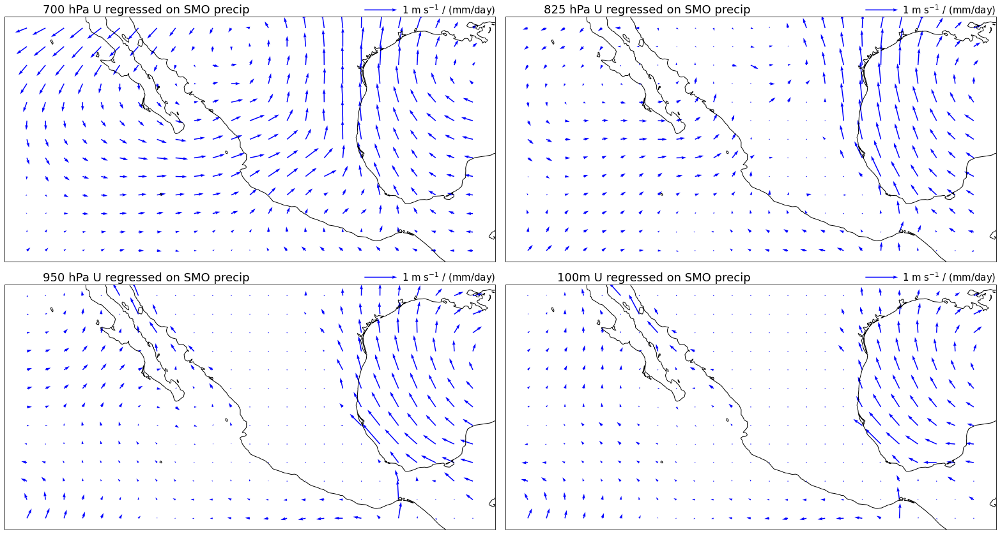

In [15]:
def plot_u_reg(levs):
    fig,axs = plt.subplots(2,2,figsize=(11*2,6*2),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
    axs=axs.reshape(-1)
    levs.append(-1)
    for ax,lev in zip(axs,levs):
        pr_index = gpm_pr_summermonths
        if lev==-1:
            filtr = SMO.vars['SP']>990e2
            ureg = filtr*sel_summer(SMO.vars['VAR_100U_3D']).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
            vreg = filtr*sel_summer(SMO.vars['VAR_100V_3D']).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients            
        else:
            filtr = SMO.vars['SP']>lev*1e2
            ureg = filtr*sel_summer(SMO.vars['U4D'].sel(level=lev)).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
            vreg = filtr*sel_summer(SMO.vars['V4D'].sel(level=lev)).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        
        u=ureg;v=vreg
        X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
        Y = v.longitude.expand_dims({"latitude":u.latitude})
        n=5
        m=5
        q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="b",width=0.002,scale=15)
        qk = ax.quiverkey(q, 0.8, 1.03, 1, r'1 m s$^{-1}$ / (mm/day)', labelpos='E',
                               coordinates='axes',color='b')
        ax.coastlines()
        if lev==-1:
            ax.set_title('100m U regressed on SMO precip',{'horizontalalignment': 'right'})
        else:
            ax.set_title('%i hPa U regressed on SMO precip'%lev,{'horizontalalignment': 'right'})
    fig.tight_layout()

plot_u_reg([700.,825.,950.])

In [14]:
SMO.vars['TL_YEARLY'] = sel_summer(SMO.vars['TL4D']).groupby('time.year').mean()
SMO.vars['QL_YEARLY'] = sel_summer(SMO.vars['QL4D']).groupby('time.year').mean()
SMO.vars['EB_YEARLY'] = sel_summer(SMO.vars['EB4D']).groupby('time.year').mean()
SMO.vars['BLSIMPLE_YEARLY'] = sel_summer(SMO.vars['BLSIMPLE4D']).groupby('time.year').mean()
SMO.vars['GPM_PR_YEARLY'] = sel_summer(SMO.vars['GPM_PR_3D']).groupby('time.year').mean()
SMO.vars['UL_YEARLY'] = sel_summer(SMO.vars['UL4D']).groupby('time.year').mean()
SMO.vars['VL_YEARLY'] = sel_summer(SMO.vars['VL4D']).groupby('time.year').mean()
SMO.vars['VAR_100U_YEARLY'] = sel_summer(SMO.vars['VAR_100U_3D']).groupby('time.year').mean()
SMO.vars['VAR_100V_YEARLY'] = sel_summer(SMO.vars['VAR_100V_3D']).groupby('time.year').mean()


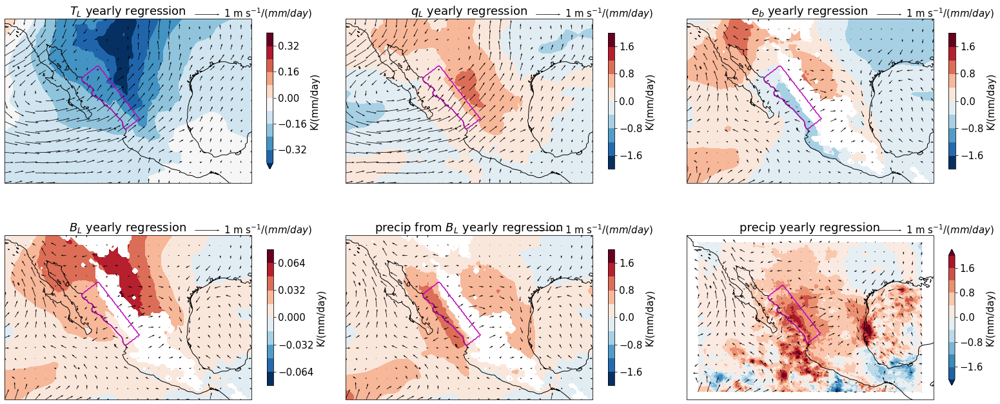

In [20]:
pr_index = gpm_pr_summermonths.groupby('time.year').mean()
fig,axs = plt.subplots(2,3,figsize=(22,10),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varname,scale in zip(axs,
                                (SMO.vars['TL_YEARLY'],2.5e3*SMO.vars['QL_YEARLY'],SMO.vars['EB_YEARLY'],SMO.vars['BLSIMPLE_YEARLY'],fit_func_monthly(SMO.vars['BLSIMPLE_YEARLY']),SMO.vars['GPM_PR_YEARLY']),
                                (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$","precip"),
                                (0.4,2,2,0.08,2,2)):
    reg = linregress_xr_2(pr_index,var,'year')
    reg.slope.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)','shrink':0.6})

    ax.set_title(varname+' yearly regression')

for i,ax in enumerate(axs):
    if i<2:
        u = SMO.vars['UL_YEARLY'].assign_coords({'pr':('year',np.array(pr_index))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        v = SMO.vars['VL_YEARLY'].assign_coords({'pr':('year',np.array(pr_index))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    else:
        u = SMO.vars['VAR_100U_YEARLY'].assign_coords({'pr':('year',np.array(pr_index))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        v = SMO.vars['VAR_100V_YEARLY'].assign_coords({'pr':('year',np.array(pr_index))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    ax.quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',
                               coordinates='axes',color='k')
fig.tight_layout()


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


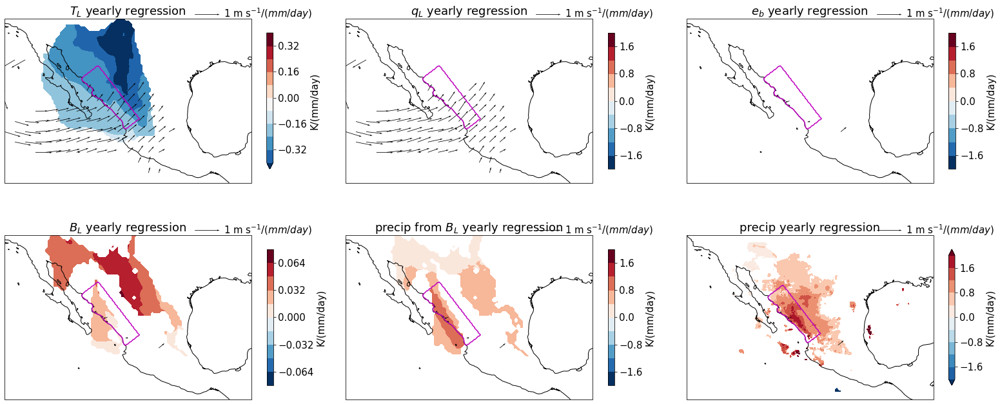

In [19]:
pr_index = gpm_pr_summermonths.groupby('time.year').mean()
fig,axs = plt.subplots(2,3,figsize=(22,10),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varname,scale in zip(axs,
                                (SMO.vars['TL_YEARLY'],2.5e3*SMO.vars['QL_YEARLY'],SMO.vars['EB_YEARLY'],SMO.vars['BLSIMPLE_YEARLY'],fit_func_monthly(SMO.vars['BLSIMPLE_YEARLY']),SMO.vars['GPM_PR_YEARLY']),
                                (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$","precip"),
                                (0.4,2,2,0.08,2,2)):
    reg = linregress_xr_2(pr_index,var,'year')
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)','shrink':0.6})

    ax.set_title(varname+' yearly regression')

for i,ax in enumerate(axs):
    if i<2:
        ureg = linregress_xr_2(pr_index,SMO.vars['UL_YEARLY'],'year')
        vreg = linregress_xr_2(pr_index,SMO.vars['VL_YEARLY'],'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
    else:
        ureg = linregress_xr_2(pr_index,SMO.vars['VAR_100U_YEARLY'],'year')
        vreg = linregress_xr_2(pr_index,SMO.vars['VAR_100V_YEARLY'],'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    ax.quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',
                               coordinates='axes',color='k')
fig.tight_layout()


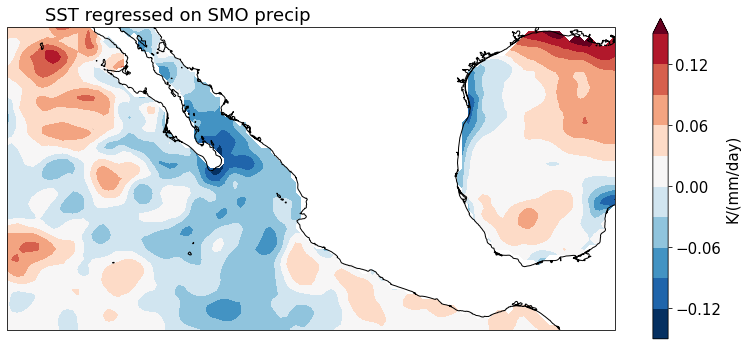

In [49]:

fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
pr_index = gpm_pr_summermonths
sstreg = sel_summer(SMO.vars['SST_3D']).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=0.15
sstreg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
ax.set_title('SST regressed on SMO precip',{'horizontalalignment': 'right'})
ax.coastlines()
fig.tight_layout()



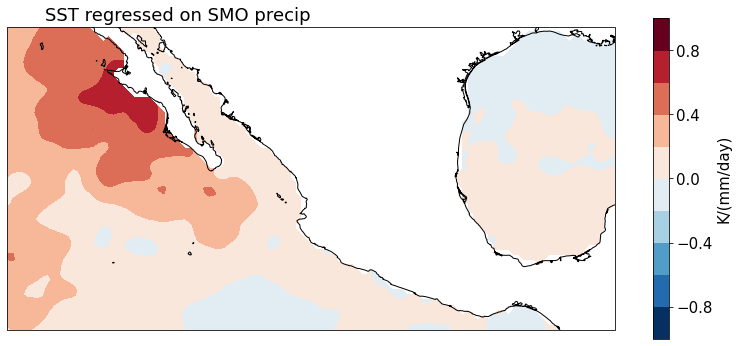

In [214]:

fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
pr_index = gpm_pr_summermonths.groupby('time.year').mean()
sstreg = sel_summer(SMO.vars['SST_3D']).groupby('time.year').mean().assign_coords({'pr':('year',np.array(pr_index))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=1
sstreg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
ax.set_title('SST regressed on SMO precip',{'horizontalalignment': 'right'})
ax.coastlines()
fig.tight_layout()



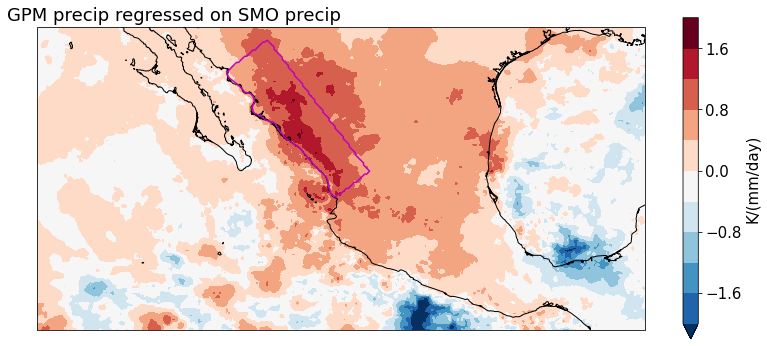

In [110]:

fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
pr_index = gpm_pr_summermonths
prreg = sel_summer(SMO.vars['GPM_PR_3D']).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=2
prreg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
ax.coastlines()
precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
ax.set_title('GPM precip regressed on SMO precip',{'horizontalalignment': 'right'})

fig.tight_layout()



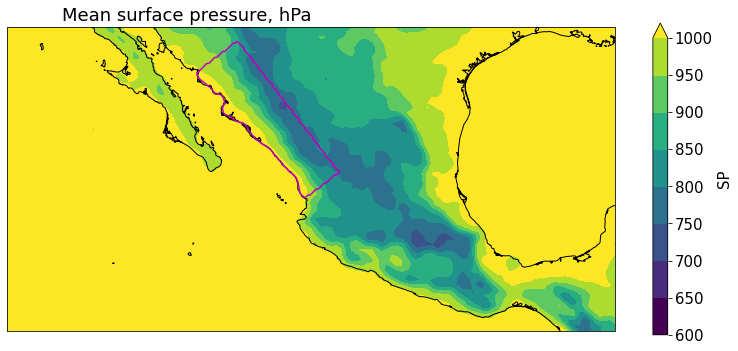

In [115]:

fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})
ax.coastlines()
(SMO.vars['SP']/100).plot.contourf(ax=ax,levels=np.arange(600,1050,50))
precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
ax.set_title('Mean surface pressure, hPa',{'horizontalalignment': 'right'})

fig.tight_layout()



## Larger-scale wind changes with FDR

In [15]:
import dask
dask.config.config["distributed"]["dashboard"]["link"] = "{JUPYTERHUB_SERVICE_PREFIX}proxy/{port}/status"
from dask.distributed import Client
client=Client(memory_limit="35GB")

In [19]:
pr_index = gpm_pr_summermonths.groupby('time.year').mean()


In [147]:
u_all = xr.open_mfdataset(["/global/cfs/projectdirs/m3310/wboos/era5monthlyQuentin/e5.moda.an.pl/e5.moda.an.pl.128_131_u.ll025uv.%i010100_%i120100.nc"%(year,year) for year in range(2001,2019)],parallel=True).U
v_all = xr.open_mfdataset(["/global/cfs/projectdirs/m3310/wboos/era5monthlyQuentin/e5.moda.an.pl/e5.moda.an.pl.128_132_v.ll025uv.%i010100_%i120100.nc"%(year,year) for year in range(2001,2019)],parallel=True).V
u_sub = sel_summer(u_all).sel(level=slice(500,849),latitude=slice(70,-10),longitude=slice(180,360)).groupby('time.year').mean().mean('level')
v_sub = sel_summer(v_all).sel(level=slice(500,849),latitude=slice(70,-10),longitude=slice(180,360)).groupby('time.year').mean().mean('level')
%time u_sub_reg = linregress_xr_2(pr_index,u_sub,'year').load()
%time v_sub_reg = linregress_xr_2(pr_index,v_sub,'year').load()

In [169]:
t_all = xr.open_mfdataset(["/global/cfs/projectdirs/m3310/wboos/era5monthlyQuentin/e5.moda.an.pl/e5.moda.an.pl.128_130_t.ll025sc.%i010100_%i120100.nc"%(year,year) for year in range(2001,2019)],parallel=True).T
t_sub = sel_summer(t_all).sel(level=slice(500,849),latitude=slice(70,-10),longitude=slice(180,360)).groupby('time.year').mean().mean('level')
%time t_sub_reg = linregress_xr_2(pr_index,t_sub,'year').load()

In [20]:
pv_all = xr.open_mfdataset(["/global/cfs/projectdirs/m3310/wboos/era5monthlyQuentin/e5.moda.an.pl/e5.moda.an.pl.128_060_pv.ll025sc.%i010100_%i120100.nc"%(year,year) for year in range(2001,2019)],parallel=True).PV
pv_sub = sel_summer(pv_all).sel(level=slice(300,500),latitude=slice(70,-10),longitude=slice(180,360)).groupby('time.year').mean().mean('level')
%time pv_sub_reg = linregress_xr_2(pr_index,pv_sub,'year').load()

CPU times: user 16.5 s, sys: 2.92 s, total: 19.4 s
Wall time: 2min 24s


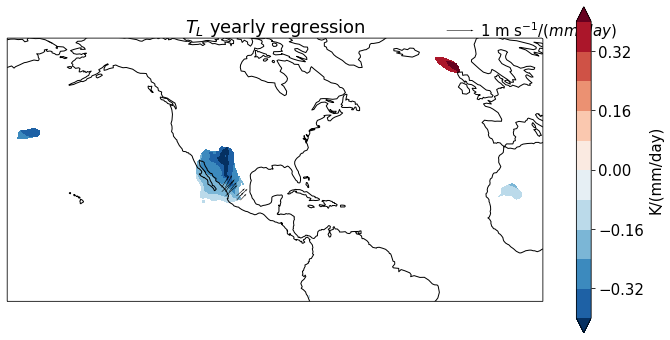

In [208]:
pr_index = gpm_pr_summermonths.groupby('time.year').mean()
fig,ax = plt.subplots(1,1,figsize=(12,6),subplot_kw={"projection":ccrs.Robinson(central_longitude=230)})
ax.coastlines()

varname = r"$T_L$"
scale = 0.4
plot = t_sub_reg.slope * 1/(t_sub_reg.pvalue<0.05)
plot.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'}, transform=ccrs.PlateCarree())
ax.set_title(varname+' yearly regression')


fdrfact = fdr_xr_2d(u_sub_reg.pvalue,0.2)+fdr_xr_2d(v_sub_reg.pvalue,0.2) >0#((u_sub_reg.pvalue<0.05) | (v_sub_reg.pvalue<0.05))#
u=u_sub_reg.slope/fdrfact;v=v_sub_reg.slope/fdrfact
X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
Y = v.longitude.expand_dims({"latitude":u.latitude})
n=5
m=5
q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.001,scale=20)
ax.quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',
                               coordinates='axes',color='k')
#ax.set_xlim(180,360)

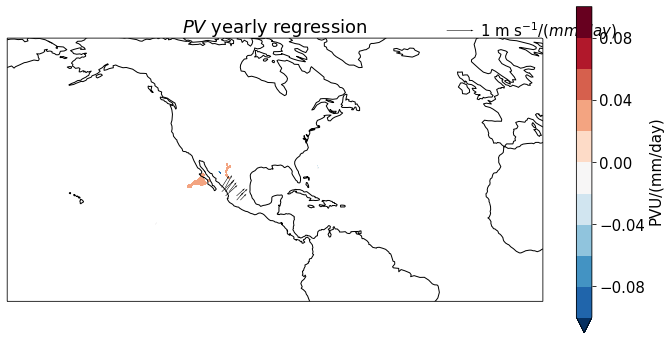

In [ ]:
pr_index = gpm_pr_summermonths.groupby('time.year').mean()
fig,ax = plt.subplots(1,1,figsize=(12,6),subplot_kw={"projection":ccrs.Robinson(central_longitude=230)})
ax.coastlines()

varname = r"$PV$"
scale = 0.1
plot = (1e6*pv_sub_reg.slope) *1/fdr_xr_2d(pv_sub_reg.pvalue,0.2)#* 1/(pv_sub_reg.pvalue<0.05)
plot.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'PVU/(mm/day)'}, transform=ccrs.PlateCarree())
ax.set_title(varname+' yearly regression')
fdrfact = fdr_xr_2d(u_sub_reg.pvalue,0.2)+fdr_xr_2d(v_sub_reg.pvalue,0.2) >0#((u_sub_reg.pvalue<0.05) | (v_sub_reg.pvalue<0.05))#
u=u_sub_reg.slope/fdrfact;v=v_sub_reg.slope/fdrfact
X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
Y = v.longitude.expand_dims({"latitude":u.latitude})
n=5
m=5
q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.001,scale=20)
ax.quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',
                               coordinates='axes',color='k')

## SST regressions with more years

In [172]:
SST_19501978 = e5_monthly_timeseries('128_034_sst',years=range(1950,1979),box=SMO.box)
SST_19792018 = e5_monthly_timeseries('128_034_sstk',years=range(1979,2019),box=SMO.box)
SST_all = xr.concat((SST_19501978,SST_19792018),dim='time')

0.5076863765716553
2.9734532833099365


In [19]:
pr_19501978 = 1e3*e5_monthly_timeseries('128_228_tp',years=range(1950,1979),box=SMO.box)
pr_19792018 = 1e3*e5_monthly_timeseries('128_228_tp',years=range(1979,2019),box=SMO.box)
pr_all = xr.concat((pr_19501978,pr_19792018),dim='time')

1.270585536956787
1.3241229057312012


In [175]:
precipmask = tilted_rect(pr_all,*SMO.box_tilted)*landmask.interp_like(pr_all)
pr_all_box    = spatial_mean( pr_all,mask=precipmask).load()
def sel_summer(var):
    return var.sel(time = ((var['time.month']>=7)&(var['time.month']<=9)))
pr_all_box_summermonths = sel_summer(pr_all_box)


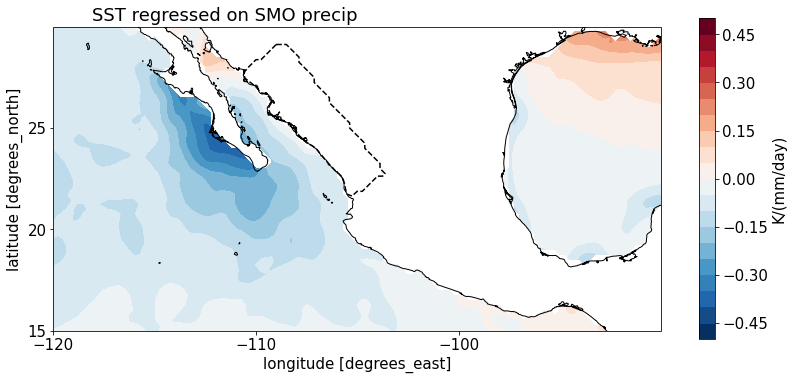

In [182]:
fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
pr_index = pr_all_box_summermonths
sstreg = sel_summer(SST_all).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=0.5
sstreg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,21),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
precipmask.plot.contour(ax=ax,linestyles='--',levels=[0.5],colors='k')
ax.set_title('SST regressed on SMO precip',{'horizontalalignment': 'right'})
ax.coastlines()
fig.tight_layout()
ax.set_xticks(range(-120,-90,10));ax.set_yticks(range(15,30,5))


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


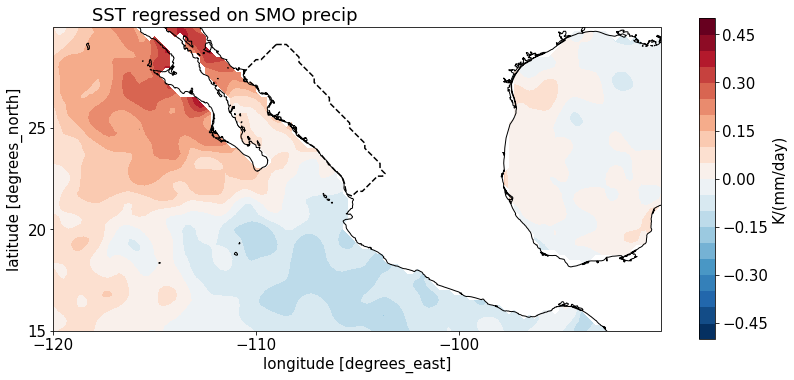

In [197]:
fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
pr_index = pr_all_box_summermonths.groupby('time.year').mean('time')[9:]
ssts = sel_summer(SST_all).groupby('time.year').mean('time')[9:]
sstreg = ssts.assign_coords({'pr':('year',np.array(pr_index))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=0.5
sstreg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,21),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
precipmask.plot.contour(ax=ax,linestyles='--',levels=[0.5],colors='k')
ax.set_title('SST regressed on SMO precip',{'horizontalalignment': 'right'})
ax.coastlines()
fig.tight_layout()
ax.set_xticks(range(-120,-90,10));ax.set_yticks(range(15,30,5))


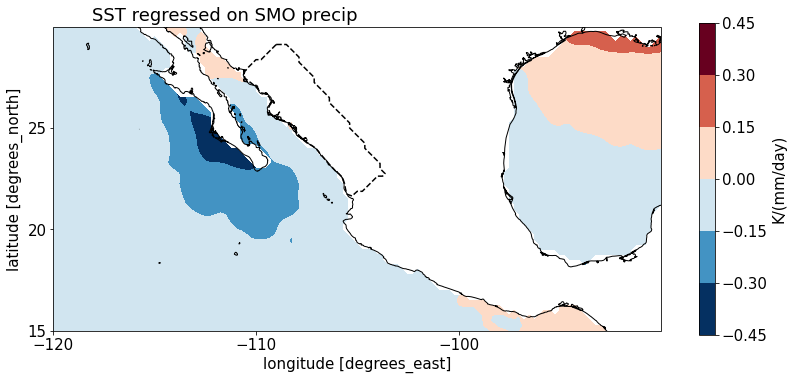

In [178]:
fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
pr_index = pr_all_box_summermonths
sstreg = sel_summer(SST_all).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=0.15
sstreg.plot.contourf(ax=ax,cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
precipmask.plot.contour(ax=ax,linestyles='--',levels=[0.5],colors='k')
ax.set_title('SST regressed on SMO precip',{'horizontalalignment': 'right'})
ax.coastlines()
fig.tight_layout()
ax.set_xticks(range(-120,-90,10));ax.set_yticks(range(15,30,5))


## T,Q,U,V regressions with more years

In [47]:
def set_4dvar_19602018(MR,varname,storage_name):
    stored_file=MR.path+'e5.monthly.%s.%s.1960-2018.nc'%(storage_name,MR.name)
    if os.path.isfile(stored_file):
        MR.vars[varname] = xr.open_dataarray(stored_file)
    else :
        print("Computing %s ..."%varname)
        part1 = e5_monthly_timeseries(storage_name,years=range(1960,1979),box=MR.box)
        part2 = e5_monthly_timeseries(storage_name,years=range(1979,2019),box=MR.box)
        full = xr.concat((part1,part2),dim='time')
        MR.vars[varname] = full
        MR.vars[varname].to_netcdf(stored_file)
        print("Done ! and stored in %s"%MR.path)
        
#import dask
#dask.config.config["distributed"]["dashboard"]["link"] = "{JUPYTERHUB_SERVICE_PREFIX}proxy/{port}/status"
#from dask.distributed import Client
#client=Client(memory_limit="35GB")
        
set_4dvar_19602018(SMO,'T4D',"128_130_t")
set_4dvar_19602018(SMO,'Q4D',"128_133_q")
set_4dvar_19602018(SMO,'U4D',"128_131_u")
set_4dvar_19602018(SMO,'V4D',"128_132_v")
set_4dvar_19602018(SMO,'VAR_100U_3D',"228_246_100u")
set_4dvar_19602018(SMO,'VAR_100V_3D',"228_247_100v")

In [48]:
pr_19601978 = 1e3*e5_monthly_timeseries('128_228_tp',years=range(1960,1979),box=SMO.box)
pr_19792018 = 1e3*e5_monthly_timeseries('128_228_tp',years=range(1979,2019),box=SMO.box)
pr_19602018 = xr.concat((pr_19601978,pr_19792018),dim='time')

0.5697429180145264
14.72474718093872


In [49]:
e5_pr_allmonths    = spatial_mean( pr_19602018,mask=SMO.precipmask).load()
e5_pr_summermonths = sel_summer(e5_pr_allmonths)

In [50]:
from orographicPrecipitation.precip_model_functions import qsat
leveldim = SMO.vars['T4D'].level
tb = SMO.vars['T4D'].where((leveldim*1e2<=SMO.vars['SP'])&(leveldim>=850)).mean('level')
qb = SMO.vars['Q4D'].where((leveldim*1e2<=SMO.vars['SP'])&(leveldim>=850)).mean('level')
SMO.vars['EB4D'] = tb+2.5e3*qb
SMO.vars['TL4D'] = SMO.vars['T4D'].sel(level=slice(500,849)).mean('level')
SMO.vars['QL4D'] = SMO.vars['Q4D'].sel(level=slice(500,849)).mean('level')
qLstar = qsat(SMO.vars['T4D'].sel(level=slice(500,849)),SMO.vars['T4D'].sel(level=slice(500,849)).level).mean('level')
eL = SMO.vars['TL4D']+2.5e3*SMO.vars['QL4D']
eLstar = SMO.vars['TL4D']+2.5e3*qLstar

SMO.vars['BLSIMPLE4D'] = compute_BLsimple(SMO.vars['EB4D'],eL,eLstar,kind='deep')

SMO.vars['UL4D'] = SMO.vars['U4D'].sel(level=slice(500,849)).mean('level')
SMO.vars['VL4D'] = SMO.vars['V4D'].sel(level=slice(500,849)).mean('level')


SMO.vars['TL_YEARLY'] = sel_summer(SMO.vars['TL4D']).groupby('time.year').mean()
SMO.vars['QL_YEARLY'] = sel_summer(SMO.vars['QL4D']).groupby('time.year').mean()
SMO.vars['EB_YEARLY'] = sel_summer(SMO.vars['EB4D']).groupby('time.year').mean()
SMO.vars['BLSIMPLE_YEARLY'] = sel_summer(SMO.vars['BLSIMPLE4D']).groupby('time.year').mean()
SMO.vars['E5_PR_YEARLY'] = sel_summer(pr_19602018).groupby('time.year').mean()
SMO.vars['UL_YEARLY'] = sel_summer(SMO.vars['UL4D']).groupby('time.year').mean()
SMO.vars['VL_YEARLY'] = sel_summer(SMO.vars['VL4D']).groupby('time.year').mean()
SMO.vars['VAR_100U_YEARLY'] = sel_summer(SMO.vars['VAR_100U_3D']).groupby('time.year').mean()
SMO.vars['VAR_100V_YEARLY'] = sel_summer(SMO.vars['VAR_100V_3D']).groupby('time.year').mean()


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))


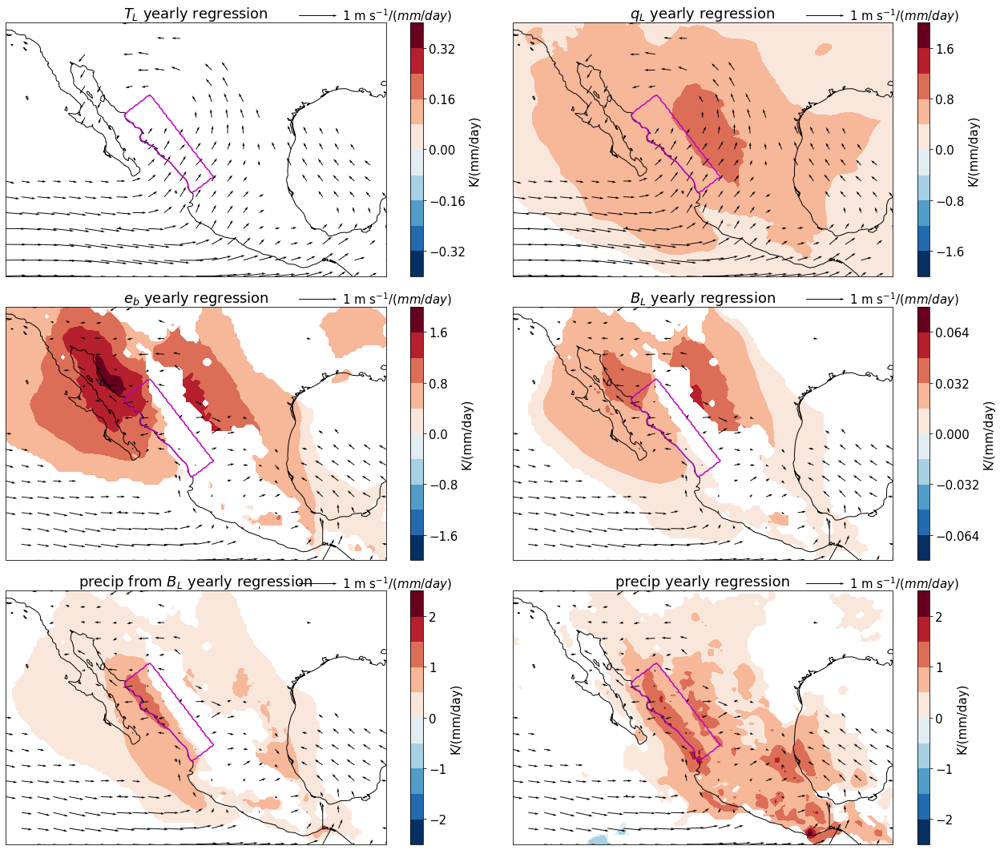

In [120]:
pr_index = e5_pr_summermonths.groupby('time.year').mean()
fig,axs = plt.subplots(3,2,figsize=(18,15),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varname,scale in zip(axs,
                                (SMO.vars['TL_YEARLY'],2.5e3*SMO.vars['QL_YEARLY'],SMO.vars['EB_YEARLY'],SMO.vars['BLSIMPLE_YEARLY'],fit_func_monthly(SMO.vars['BLSIMPLE_YEARLY']),SMO.vars['E5_PR_YEARLY']),
                                (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$","precip"),
                                (0.4,2,2,0.08,2.5,2.5)):
    reg = linregress_xr_2(pr_index,var,'year')
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})

    ax.set_title(varname+' yearly regression')

for i,ax in enumerate(axs):
    if i<2:
        ureg = linregress_xr_2(pr_index,SMO.vars['UL_YEARLY'],'year')
        vreg = linregress_xr_2(pr_index,SMO.vars['VL_YEARLY'],'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
    else:
        ureg = linregress_xr_2(pr_index,SMO.vars['VAR_100U_YEARLY'],'year')
        vreg = linregress_xr_2(pr_index,SMO.vars['VAR_100V_YEARLY'],'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    ax.quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',
                               coordinates='axes',color='k')
fig.tight_layout()


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))


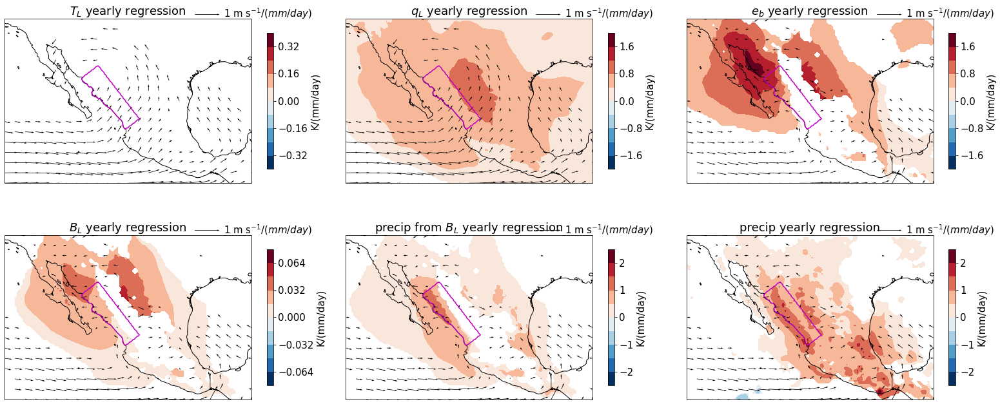

In [53]:
pr_index = e5_pr_summermonths.groupby('time.year').mean()
fig,axs = plt.subplots(2,3,figsize=(22,10),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varname,scale in zip(axs,
                                (SMO.vars['TL_YEARLY'],2.5e3*SMO.vars['QL_YEARLY'],SMO.vars['EB_YEARLY'],SMO.vars['BLSIMPLE_YEARLY'],fit_func_monthly(SMO.vars['BLSIMPLE_YEARLY']),SMO.vars['E5_PR_YEARLY']),
                                (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$","precip"),
                                (0.4,2,2,0.08,2.5,2.5)):
    reg = linregress_xr_2(pr_index,var,'year')
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)','shrink':0.6})

    ax.set_title(varname+' yearly regression')

for i,ax in enumerate(axs):
    if i<2:
        ureg = linregress_xr_2(pr_index,SMO.vars['UL_YEARLY'],'year')
        vreg = linregress_xr_2(pr_index,SMO.vars['VL_YEARLY'],'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
    else:
        ureg = linregress_xr_2(pr_index,SMO.vars['VAR_100U_YEARLY'],'year')
        vreg = linregress_xr_2(pr_index,SMO.vars['VAR_100V_YEARLY'],'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    ax.quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',
                               coordinates='axes',color='k')
fig.tight_layout()


## Comparing GPM and ERA5 regressions on a short record

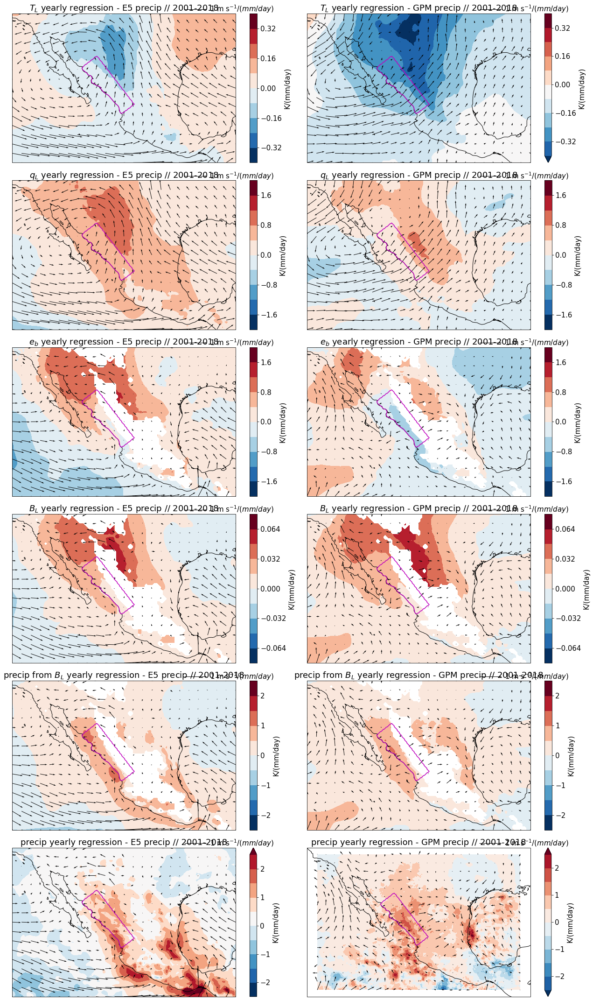

In [41]:
pr_index_e5 = e5_pr_summermonths.groupby('time.year').mean().sel(year=slice(2001,2019))
pr_index_gpm = gpm_pr_summermonths.groupby('time.year').mean().sel(year=slice(2001,2019))

fig,axss = plt.subplots(6,2,figsize=(18,30),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
for ax in axss.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for axs,var,varname,scale in zip(axss,
                                (SMO.vars['TL_YEARLY'].sel(year=slice(2001,2019)),2.5e3*SMO.vars['QL_YEARLY'].sel(year=slice(2001,2019)),SMO.vars['EB_YEARLY'].sel(year=slice(2001,2019)),SMO.vars['BLSIMPLE_YEARLY'].sel(year=slice(2001,2019)),fit_func_monthly(SMO.vars['BLSIMPLE_YEARLY'].sel(year=slice(2001,2019))),SMO.vars['E5_PR_YEARLY'].sel(year=slice(2001,2019))),
                                (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$","precip"),
                                (0.4,2,2,0.08,2.5,2.5)):
    varreg = var.assign_coords({'pr':('year',np.array(pr_index_e5))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    varreg.plot.contourf(ax=axs[0],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
    
    if varname !='precip':
        varreg = var.assign_coords({'pr':('year',np.array(pr_index_gpm))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        varreg.plot.contourf(ax=axs[1],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
    else:
        varreg = SMO.vars['GPM_PR_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_gpm))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        varreg.plot.contourf(ax=axs[1],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})


    axs[0].set_title(varname+' yearly regression - E5 precip // 2001-2018')
    axs[1].set_title(varname+' yearly regression - GPM precip // 2001-2018')  


for i,axs in enumerate(axss):
    if i<2:
        u = SMO.vars['UL_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_e5))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        v = SMO.vars['VL_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_e5))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        u2 = SMO.vars['UL_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_gpm))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        v2 = SMO.vars['VL_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_gpm))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    else:
        u = SMO.vars['VAR_100U_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_e5))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        v = SMO.vars['VAR_100V_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_e5))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        u2 = SMO.vars['VAR_100U_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_gpm))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        v2 = SMO.vars['VAR_100V_YEARLY'].sel(year=slice(2001,2019)).assign_coords({'pr':('year',np.array(pr_index_gpm))}).swap_dims({'year':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=axs[0].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    axs[0].quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',coordinates='axes',color='k')
    q=axs[1].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u2)[::n,::m], np.array(v2)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    axs[1].quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',coordinates='axes',color='k')
fig.tight_layout()


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matpl

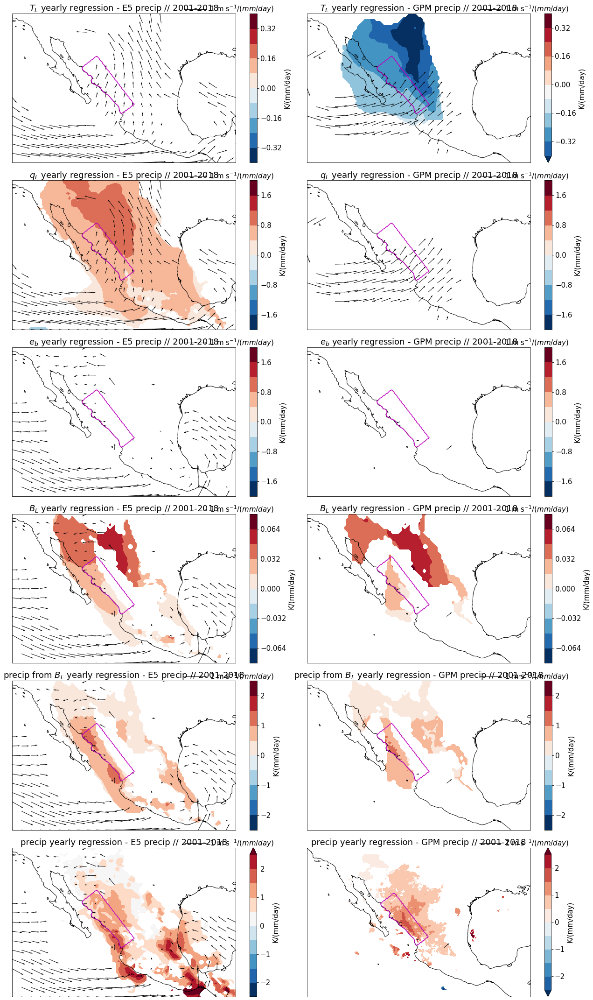

In [34]:
pr_index_e5 = e5_pr_summermonths.groupby('time.year').mean().sel(year=slice(2001,2019))
pr_index_gpm = gpm_pr_summermonths.groupby('time.year').mean().sel(year=slice(2001,2019))

fig,axss = plt.subplots(6,2,figsize=(18,30),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
for ax in axss.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for axs,var,varname,scale in zip(axss,
                                (SMO.vars['TL_YEARLY'].sel(year=slice(2001,2019)),2.5e3*SMO.vars['QL_YEARLY'].sel(year=slice(2001,2019)),SMO.vars['EB_YEARLY'].sel(year=slice(2001,2019)),SMO.vars['BLSIMPLE_YEARLY'].sel(year=slice(2001,2019)),fit_func_monthly(SMO.vars['BLSIMPLE_YEARLY'].sel(year=slice(2001,2019))),SMO.vars['E5_PR_YEARLY'].sel(year=slice(2001,2019))),
                                (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$","precip"),
                                (0.4,2,2,0.08,2.5,2.5)):
    reg = linregress_xr_2(pr_index_e5,var,'year')
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=axs[0],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})

    if varname !='precip':
        reg = linregress_xr_2(pr_index_gpm,var,'year')
        plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
        plot.plot.contourf(ax=axs[1],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
    else:
        reg = linregress_xr_2(pr_index_gpm,SMO.vars['GPM_PR_YEARLY'],'year')
        plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
        plot.plot.contourf(ax=axs[1],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})

    axs[0].set_title(varname+' yearly regression - E5 precip // 2001-2018')
    axs[1].set_title(varname+' yearly regression - GPM precip // 2001-2018')  


for i,axs in enumerate(axss):
    if i<2:
        ureg = linregress_xr_2(pr_index_e5,SMO.vars['UL_YEARLY'].sel(year=slice(2001,2019)),'year')
        vreg = linregress_xr_2(pr_index_e5,SMO.vars['VL_YEARLY'].sel(year=slice(2001,2019)),'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
        ureg = linregress_xr_2(pr_index_gpm,SMO.vars['UL_YEARLY'].sel(year=slice(2001,2019)),'year')
        vreg = linregress_xr_2(pr_index_gpm,SMO.vars['VL_YEARLY'].sel(year=slice(2001,2019)),'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u2=ureg.slope/fdrfact;v2=vreg.slope/fdrfact
    else:
        ureg = linregress_xr_2(pr_index_e5,SMO.vars['VAR_100U_YEARLY'].sel(year=slice(2001,2019)),'year')
        vreg = linregress_xr_2(pr_index_e5,SMO.vars['VAR_100V_YEARLY'].sel(year=slice(2001,2019)),'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u=ureg.slope/fdrfact;v=vreg.slope/fdrfact
        ureg = linregress_xr_2(pr_index_gpm,SMO.vars['VAR_100U_YEARLY'].sel(year=slice(2001,2019)),'year')
        vreg = linregress_xr_2(pr_index_gpm,SMO.vars['VAR_100V_YEARLY'].sel(year=slice(2001,2019)),'year')
        fdrfact = fdr_xr_2d(ureg.pvalue,0.1)+fdr_xr_2d(vreg.pvalue,0.1) >0
        u2=ureg.slope/fdrfact;v2=vreg.slope/fdrfact
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=axs[0].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    axs[0].quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',coordinates='axes',color='k')
    q=axs[1].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u2)[::n,::m], np.array(v2)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=10)
    axs[1].quiverkey(q, 0.87, 1.03, 1, r'1 m s$^{-1}/(mm/day)$', labelpos='E',coordinates='axes',color='k')
fig.tight_layout()


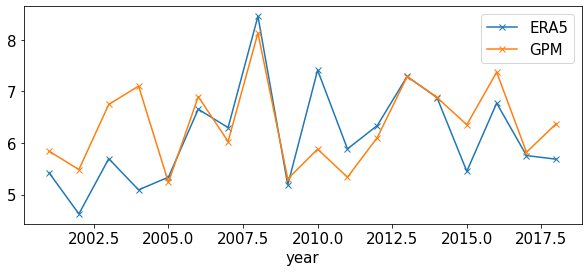

In [44]:
_,ax=plt.subplots(1,1,figsize=(10,4))
pr_index_e5.plot(ax=ax,marker='x',label='ERA5')
pr_index_gpm.plot(ax=ax,marker='x',label='GPM')
ax.legend()

## Solving a steady-state advection-diffusion eqn

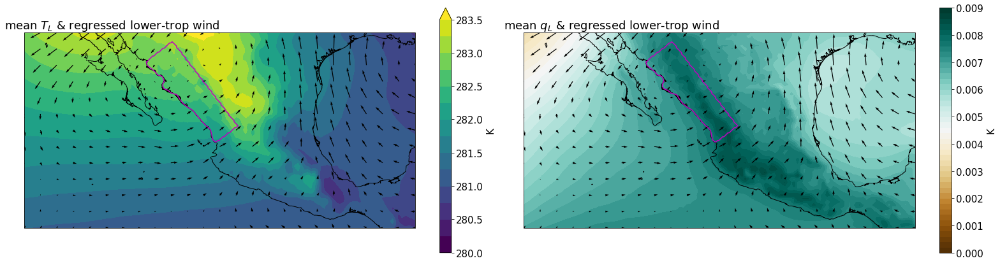

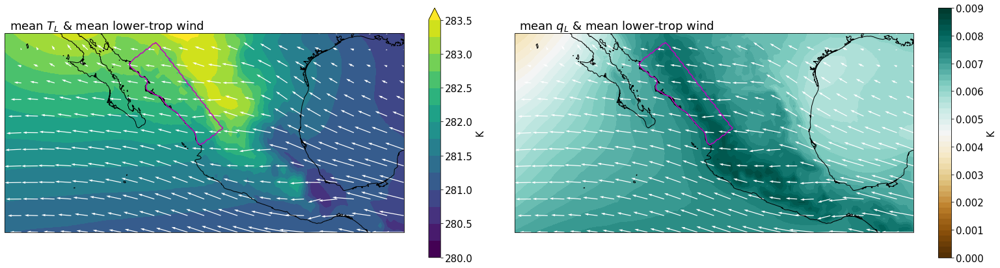

In [108]:
ureg = sel_summer(SMO.vars['U4D']).where(SMO.vars['Q4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
vreg = sel_summer(SMO.vars['V4D']).where(SMO.vars['Q4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
umean = SMO.vars['U'].sel(level=slice(500,849)).mean('level')
vmean = SMO.vars['V'].sel(level=slice(500,849)).mean('level')
for u,v,c,desc,sc in ((ureg,vreg,'k','regressed',15),(umean,vmean,'w','mean',100)):
    fig,axs = plt.subplots(1,2,figsize=(11*2,6),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
    
    for ax in axs:
        ax.coastlines()
        precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
    ax=axs[0]
    SMO.vars['T'].sel(level=slice(500,849)).mean('level').plot.contourf(ax=ax,levels=np.arange(280,283.6,0.25),cbar_kwargs={'label':'K'})
    ax.set_title(r'mean $T_L$ & %s lower-trop wind'%desc,{'horizontalalignment': 'right'})
    
    ax=axs[1]
    SMO.vars['Q'].sel(level=slice(500,849)).mean('level').plot.contourf(ax=ax,levels=np.arange(0e-3,0.91e-2,0.2e-3),cmap=plt.cm.BrBG,cbar_kwargs={'label':'K'})
    ax.set_title(r'mean $q_L$ & %s lower-trop wind'%desc,{'horizontalalignment': 'right'})
    
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    for ax in axs:
        q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color=c,width=0.002,scale=sc)
        
    fig.tight_layout()




In [156]:
def der1(nx,dx):
    D = -np.diag(np.ones(nx-1),-1) + np.diag(np.ones(nx-1),1)
    #D[0,0] = -3; D[-1,-1] = 3
    #D[0,1] = 4 ; D[-1,-2] = -4
    #D[0,2] = -1; D[-1,-3] = 1
    return D/2/dx

def der2(nx,dx):
    return (np.diag(np.ones(nx-1),-1) - 2*np.diag(np.ones(nx),0) + np.diag(np.ones(nx-1),1))/dx**2

def transform_2d(M,nx,ny,applies_on='x'):
    if applies_on=='x':
        assert M.shape==(nx,nx)
        return np.kron(np.eye(ny,dtype=int),M)  # block diagonal matrix
    elif applies_on=='y':
        assert M.shape==(ny,ny)
        temp = np.kron(np.eye(nx,dtype=int),M)
        reindex = np.zeros(nx*ny,dtype=int)
        for j in range(ny):
            reindex[j*nx:(j+1)*nx] = j + ny*np.arange(nx)
        return temp[reindex][:,reindex]

def Mmatrix(u,v,kappa,bc='dirichlet'):
    dx = 110e3/4
    dy=dx
    ny,nx = u.shape
    Dx = der1(nx,dx)
    Dy = der1(ny,dy)
    Dx2 = der2(nx,dx)
    Dy2 = der2(ny,dy)
    U = np.diag(np.array(u).reshape(-1))
    V = np.diag(np.array(v).reshape(-1))
    M = np.dot(U,transform_2d(Dx,nx,ny,'x'))+np.dot(V,transform_2d(Dy,nx,ny,'y')) - kappa*(transform_2d(Dx2,nx,ny,'x')+transform_2d(Dy2,nx,ny,'y'))
    if bc=='dirichlet':
        M[:nx,:nx] = np.eye(nx); M[:nx,nx:]= 0.
        M[-nx:,-nx:] = np.eye(nx); M[-nx:,:-nx] = 0.
        for k in range(1,ny-1):
            M[k*nx] = 0.; M[k*nx,k*nx] = 1.
            M[k*nx + nx-1] = 0.; M[k*nx+ nx-1,k*nx+ nx-1] = 1.
    elif bc=='neumann':
        M[:nx,]= 0. ; M[:nx,:nx] = np.eye(nx)/2/dx; M[:nx,nx:2*nx] = -np.eye(nx)/2/dx
        M[-nx:] = 0.; M[-nx:,-nx:] = -np.eye(nx)/2/dx; M[-nx:,-2*nx:-nx] = np.eye(nx)/2/dx; 
        for k in range(1,ny-1):
            M[k*nx] = 0.; M[k*nx,k*nx] = -1./2/dx; M[k*nx,k*nx+1] = 1./2/dx
            M[k*nx + nx-1] = 0.; M[k*nx+ nx-1,k*nx+ nx-1] = 1./2/dx; M[k*nx+ nx-1,k*nx+ nx-2] = -1./2/dx
    
    return M
    
def solve_advdiff(u,v,kappa,upgradT,bc='dirichlet'):
    ny,nx = u.shape
    rhs = -np.array(upgradT).reshape(-1)
    rhs[:nx]=0.;rhs[-nx:]=0.;rhs[::nx] = 0.; rhs[nx-1::nx] = 0.
    M = Mmatrix(u,v,kappa,bc)
    tprime = np.linalg.solve(M,rhs)
    return (tprime.reshape(u.shape) * u**0).rename("T'")

Text(0.5, 1.0, "$T'$ from $U\\cdot\\nabla T' = - U'\\cdot\\nabla T$")

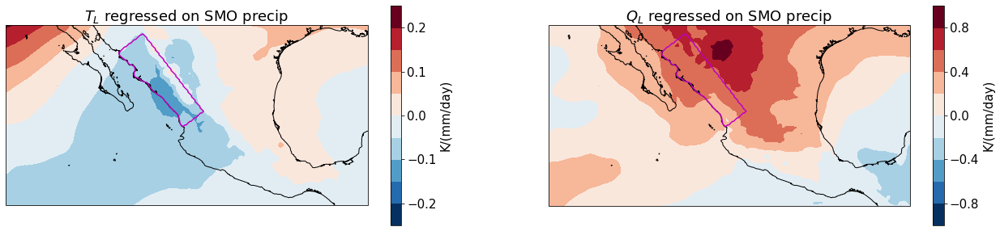

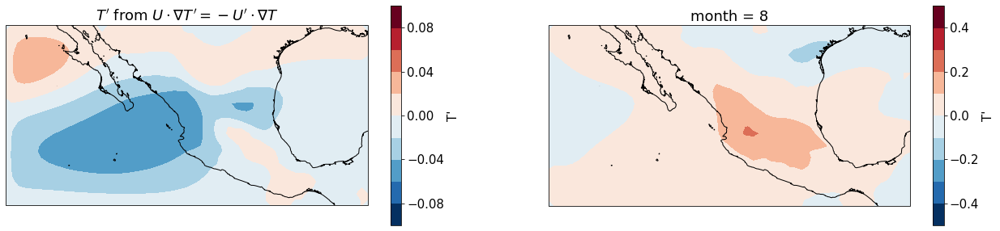

In [164]:
fig,axs = plt.subplots(1,2,figsize=(11*2,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1

for ax in axs:
    ax.coastlines()
    precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')

ax=axs[0]
treg = sel_summer(SMO.vars['T4D']).where(SMO.vars['T4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=0.25
treg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
ax.set_title(r'$T_L$ regressed on SMO precip')

ax=axs[1]
qreg = 2.5e3*sel_summer(SMO.vars['Q4D']).where(SMO.vars['Q4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=1
qreg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
ax.set_title(r'$Q_L$ regressed on SMO precip')

kappa = 1e5
upgradt = ureg * tmean.differentiate('longitude')/110e3 + vreg * tmean.differentiate('latitude')/110e3
tprime = solve_advdiff(umean[::down,::down],vmean[::down,::down],kappa,upgradt[::down,::down],bc='dirichlet')
upgradq = ureg * qmean.differentiate('longitude')/110e3 + vreg * qmean.differentiate('latitude')/110e3
qprime = 2.5e3*solve_advdiff(umean[::down,::down],vmean[::down,::down],kappa,upgradq[::down,::down],bc='dirichlet')

fig,axs = plt.subplots(1,2,figsize=(11*2,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
tprime.plot.contourf(ax=axs[0],levels=np.linspace(-0.1,0.1,11))
qprime.plot.contourf(ax=axs[1],levels=np.linspace(-0.5,0.5,11))
axs[0].coastlines();axs[1].coastlines()
axs[0].set_title(r"$T'$ from $U\cdot\nabla T' = - U'\cdot\nabla T$")

Text(0.5, 1.0, "$T'$ from $U\\cdot\\nabla T' = - U'\\cdot\\nabla T$")

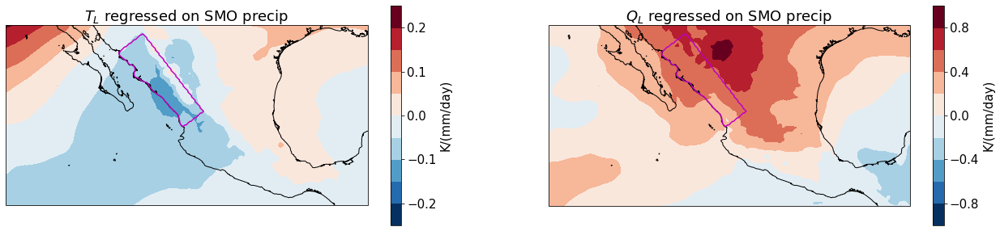

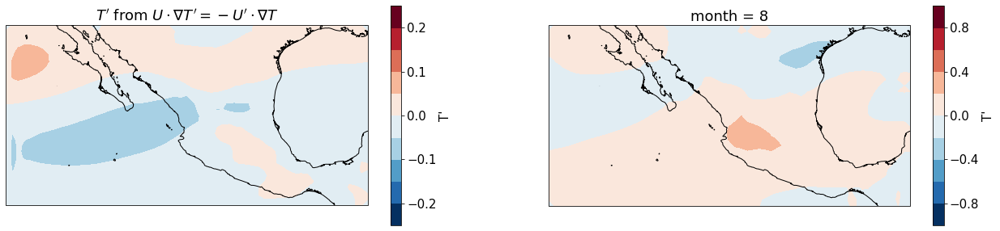

In [171]:
fig,axs = plt.subplots(1,2,figsize=(11*2,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1

for ax in axs:
    ax.coastlines()
    precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')

ax=axs[0]
treg = sel_summer(SMO.vars['T4D']).where(SMO.vars['T4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=0.25
treg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
ax.set_title(r'$T_L$ regressed on SMO precip')

ax=axs[1]
qreg = 2.5e3*sel_summer(SMO.vars['Q4D']).where(SMO.vars['Q4D'].level*100<SMO.vars['SP']).sel(level=slice(500,849)).mean('level').assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
scale=1
qreg.plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
ax.set_title(r'$Q_L$ regressed on SMO precip')

kappa = 4e4
upgradt = ureg * tmean.differentiate('longitude')/110e3 + vreg * tmean.differentiate('latitude')/110e3
tprime = solve_advdiff(umean[::down,::down],vmean[::down,::down],kappa,upgradt[::down,::down],bc='dirichlet')
upgradq = ureg * qmean.differentiate('longitude')/110e3 + vreg * qmean.differentiate('latitude')/110e3
qprime = 2.5e3*solve_advdiff(umean[::down,::down],vmean[::down,::down],kappa,upgradq[::down,::down],bc='dirichlet')

fig,axs = plt.subplots(1,2,figsize=(11*2,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
scale=0.25
tprime.plot.contourf(ax=axs[0],levels=np.linspace(-scale,scale,11))
scale=1
qprime.plot.contourf(ax=axs[1],levels=np.linspace(-scale,scale,11))
axs[0].coastlines();axs[1].coastlines()
axs[0].set_title(r"$T'$ from $U\cdot\nabla T' = - U'\cdot\nabla T$")

# Daily data

In [11]:
%%time
SMO.vars['GPM_PR_DAILY'] = xr.open_dataarray("/global/cscratch1/sd/qnicolas/regionsData/gpm_imerg_v06.2001-2020.07-08-09.smo.nc")
pr_timeseries = spatial_mean(SMO.vars['GPM_PR_DAILY'],mask=SMO.precipmask).load()
for varname,varcode in (('T','128_130_t'),('U','128_131_u'),('V','128_132_v'),('Q','128_133_q'),('W','128_135_w')):
    SMO.vars[varname+'_DAILY'] = xr.open_dataarray("/global/cscratch1/sd/qnicolas/regionsData/e5.oper.an.pl.{}.ll025sc.2001-2020.07-08-09.smo.nc".format(varcode))
SMO.vars['U_PERP_DAILY'] = crossslopeflow(SMO.vars['U_DAILY'],SMO.vars['V_DAILY'],SMO.angle)
SMO.set_daily_Blsimple_vars('deep')
SMO.set_daily_uLvL()



CPU times: user 6.79 s, sys: 16.4 s, total: 23.2 s
Wall time: 1min 55s


In [30]:
SMO.vars['TL_DAILY']=SMO.vars['TLDEEP_DAILY']
SMO.vars['QL_DAILY']=SMO.vars['QLDEEP_DAILY']
SMO.vars['EB_DAILY']=SMO.vars['EBDEEP_DAILY']
SMO.vars['BLSIMPLE_DAILY']=SMO.vars['BLDEEPSIMPLE_DAILY']

In [31]:
%%time
def lowextreme_days(exvar,percentile):
    p99 = exvar.where(exvar<float(exvar.quantile(percentile/100,"time")),drop=True)
    return list(pd.to_datetime(np.array(p99.time)).strftime("%Y%m%d"))

pctile=90
for varname in ('T','U','V','Q','W','U_PERP','TL','QL','EB','BLSIMPLE','GPM_PR','UL','VL'):
    SMO.vars['%s_PR%i'%(varname,pctile)] = SMO.vars[varname+'_DAILY'].sel(time = timesel(SMO.vars[varname+'_DAILY'].time,extreme_days(pr_timeseries,pctile))).mean('time').load()
for varname in ('T','U','V','Q','W','U_PERP','TL','QL','EB','BLSIMPLE','GPM_PR','UL','VL'):
    SMO.vars['%s_PR90_P2'%(varname)] = SMO.vars[varname+'_DAILY'].isel(time = timesel(SMO.vars[varname+'_DAILY'].time,extreme_days(pr_timeseries,pctile))[1:]+[False]).mean('time').load()
pctile=10
for varname in ('T','U','V','Q','W','U_PERP','TL','QL','EB','BLSIMPLE','GPM_PR','UL','VL'):
    SMO.vars['%s_PR%i'%(varname,pctile)] = SMO.vars[varname+'_DAILY'].sel(time = timesel(SMO.vars[varname+'_DAILY'].time,lowextreme_days(pr_timeseries,pctile))).mean('time').load()


CPU times: user 7.8 s, sys: 7.87 s, total: 15.7 s
Wall time: 1min 39s


In [32]:
for varname in ('TL','QL','EB','BLSIMPLE','UL','VL'):
    SMO.vars[varname] = SMO.vars[varname+'_DAILY'].mean('time')

In [33]:
SMO.set_daily_sfc_var('228_246_100u','VAR_100U')
SMO.set_daily_sfc_var('228_247_100v','VAR_100V')

In [34]:
for varname in ('VAR_100U','VAR_100V'):
    pctile=90
    SMO.vars['%s_PR%i'%(varname,pctile)] = SMO.vars[varname+'_DAILY'].sel(time = timesel(SMO.vars[varname+'_DAILY'].time,extreme_days(pr_timeseries,pctile))).mean('time').load()
    pctile=10
    SMO.vars['%s_PR%i'%(varname,pctile)] = SMO.vars[varname+'_DAILY'].sel(time = timesel(SMO.vars[varname+'_DAILY'].time,lowextreme_days(pr_timeseries,pctile))).mean('time').load()
    SMO.vars['%s_PR90_P2'%(varname)] = SMO.vars[varname+'_DAILY'].isel(time = timesel(SMO.vars[varname+'_DAILY'].time,extreme_days(pr_timeseries,pctile))[1:]+[False]).mean('time').load()

In [156]:
%%time
def betweenextreme_days(exvar,percentile1,percentile2):
    p99 = exvar.where((exvar>=float(exvar.quantile(percentile1/100,"time")))&(exvar<float(exvar.quantile(percentile2/100,"time"))),drop=True)
    return list(pd.to_datetime(np.array(p99.time)).strftime("%Y%m%d"))

pctile1=80
pctile2=95
for varname in ('TL','QL','EB','BLSIMPLE','GPM_PR','UL','VL','VAR_100U','VAR_100V'):
    SMO.vars['%s_PR%i%i'%(varname,pctile1,pctile2)] = SMO.vars[varname+'_DAILY'].sel(time = timesel(SMO.vars[varname+'_DAILY'].time,betweenextreme_days(pr_timeseries,pctile1,pctile2))).mean('time').load()

CPU times: user 592 ms, sys: 160 ms, total: 752 ms
Wall time: 2.91 s


## BL to precip relationship

In [95]:
SMO.precipmask_e5 = SMO.precipmask.interp_like(SMO.vars['VAR_100U'])

/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: Mean of empty slice.
  from ipykernel import kernelapp as app
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


a=21.7,b=6.0
CPU times: user 39.1 s, sys: 27 s, total: 1min 6s
Wall time: 1min 5s


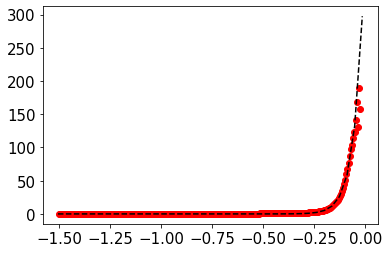

In [111]:
%%time
BL_alldays = np.array(SMO.vars['BLDEEPSIMPLE_DAILY'].transpose('time','latitude','longitude')).reshape(-1)
pr_alldays = np.array(SMO.vars['GPM_PR_DAILY'].interp_like(SMO.vars['BLDEEPSIMPLE_DAILY'][0]).transpose('time','latitude','longitude')).reshape(-1)
idx = (~np.isnan(BL_alldays))&(~np.isnan(pr_alldays))
BL_alldays = BL_alldays[idx];pr_alldays = pr_alldays[idx]


bin_centers,bin_means = get_binned(BL_alldays,pr_alldays,np.arange(-2,0.1,0.005))
plt.scatter(bin_centers,bin_means,color='r')

x,y,_,popt = fit_coefs(BL_alldays,pr_alldays,'exponential')
plt.plot(x,y,color='k',linestyle='--')

fit_func_daily = lambda bl: np.exp(popt[0]*bl+popt[1])
print("a=%.1f,b=%.1f"%(popt[0],popt[1]))


In [ ]:
fit_func_daily_e5 = lambda bl: np.exp(21.7*bl+6.)

a=12.296,b=4.633
CPU times: user 8.65 s, sys: 1.33 s, total: 9.97 s
Wall time: 9.96 s


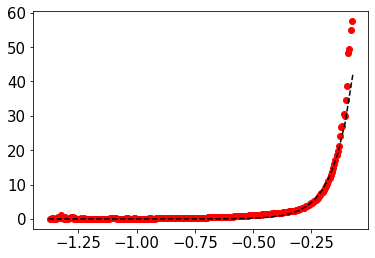

In [144]:
%%time
def resample_ndaily(ds,ndays=5):
    """performs the same job as resample(time="[ndays]D") but keeps missing months out"""
    dsm = ds.resample(time='%iD'%ndays).mean()
    return dsm.dropna('time')
BL_alldays = np.array(resample_ndaily(SMO.vars['BLDEEPSIMPLE_DAILY']).transpose('time','latitude','longitude')).reshape(-1)
pr_alldays = np.array(resample_ndaily(SMO.vars['GPM_PR_DAILY']).interp_like(SMO.vars['BLDEEPSIMPLE_DAILY'][0]).transpose('time','latitude','longitude')).reshape(-1)
idx = (~np.isnan(BL_alldays))&(~np.isnan(pr_alldays))
BL_alldays = BL_alldays[idx];pr_alldays = pr_alldays[idx]


bin_centers,bin_means = get_binned(BL_alldays,pr_alldays,np.arange(-2,0.1,0.005))
plt.scatter(bin_centers,bin_means,color='r')

x,y,_,popt = fit_coefs(BL_alldays,pr_alldays,'exponential')
plt.plot(x,y,color='k',linestyle='--')

print("a=%.3f,b=%.3f"%(popt[0],popt[1]))


In [145]:
fit_func_5daily = lambda bl: np.exp(12.296*bl+4.633)

a=22.2,b=6.1
CPU times: user 3min 31s, sys: 2min 3s, total: 5min 34s
Wall time: 5min 34s


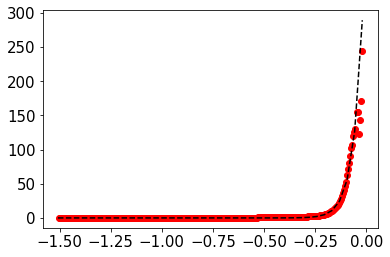

In [134]:
%%time
BL_alldays = np.array(SMO.vars['BLDEEPSIMPLE_DAILY'].interp_like(SMO.vars['GPM_PR_DAILY'][0]).transpose('time','latitude','longitude')).reshape(-1)
pr_alldays = np.array(SMO.vars['GPM_PR_DAILY'].transpose('time','latitude','longitude')).reshape(-1)
idx = (~np.isnan(BL_alldays))&(~np.isnan(pr_alldays))
BL_alldays = BL_alldays[idx];pr_alldays = pr_alldays[idx]


bin_centers,bin_means = get_binned(BL_alldays,pr_alldays,np.arange(-2,0.1,0.005))
plt.scatter(bin_centers,bin_means,color='r')

x,y,_,popt = fit_coefs(BL_alldays,pr_alldays,'exponential')
plt.plot(x,y,color='k',linestyle='--')

fit_func_daily = lambda bl: np.exp(popt[0]*bl+popt[1])
print("a=%.1f,b=%.1f"%(popt[0],popt[1]))


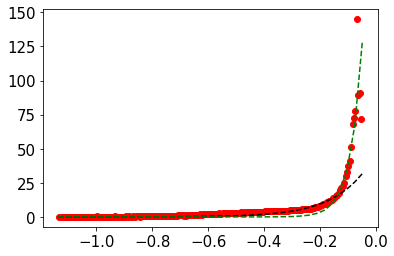

In [131]:
#%time BL_alldays_land = np.array(SMO.vars['BLDEEPSIMPLE_DAILY'].where(SMO.precipmask_e5).transpose('time','latitude','longitude')).reshape(-1)
#%time pr_alldays_land = np.array(SMO.vars['GPM_PR_DAILY'].interp_like(SMO.vars['BLDEEPSIMPLE_DAILY'][0]).where(SMO.precipmask_e5).transpose('time','latitude','longitude')).reshape(-1)
#idx = (~np.isnan(BL_alldays_land))&(~np.isnan(pr_alldays_land))
#BL_alldays_land = BL_alldays_land[idx];pr_alldays_land = pr_alldays_land[idx]


#bin_centers,bin_means = get_binned(BL_alldays_land,pr_alldays_land,np.arange(-2,0.1,0.005))
plt.scatter(bin_centers,bin_means,color='r')

x,y,_,popt = fit_coefs(BL_alldays_land,pr_alldays_land,'exponential')
plt.plot(x,y,color='k',linestyle='--')

fit_func_smo = lambda bl: np.exp(24*(bl+0.25))
plt.plot(x,fit_func_smo(x),color='g',linestyle='--')

## Precip CDFs

In [149]:
def plot_cdf(pr,ax,lbl=None):
    pctiles=100*np.concatenate([(1-10.**(-i+1))+10.**(-i)*np.arange(1,10,1) for i in range(1,4)])
    pctages = [float((100*pr.where(pr>float(pr.quantile(pctile/100,"time"))).sum()/pr.sum())) for pctile in pctiles]
    ax.plot(pctiles/100,pctages,'-x',label=lbl)
    ax.legend()
    ax.set_xscale('logit')
    ax.set_xticks([0.1,0.5,0.9,0.99,0.999])
    ax.set_xticklabels([0.1,0.5,0.9,0.99,0.999])  
    ax.set_title("Cumulative fraction of total precipitation by percentile",fontsize=20)
    ax.set_xlabel("Percentile")
    ax.set_ylabel("Precip fraction")
    ax.grid()

CPU times: user 88 ms, sys: 0 ns, total: 88 ms
Wall time: 86.2 ms


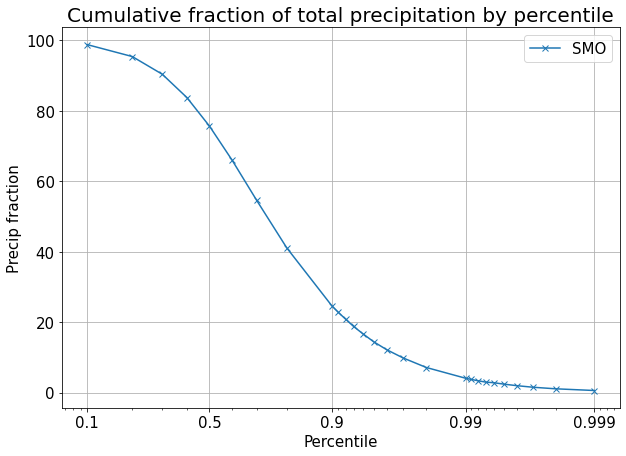

In [153]:
%%time
fig,ax=plt.subplots(1,1,figsize=(10,7))
plot_cdf(pr_timeseries,ax,'SMO')


CPU times: user 418 ms, sys: 419 µs, total: 419 ms
Wall time: 417 ms


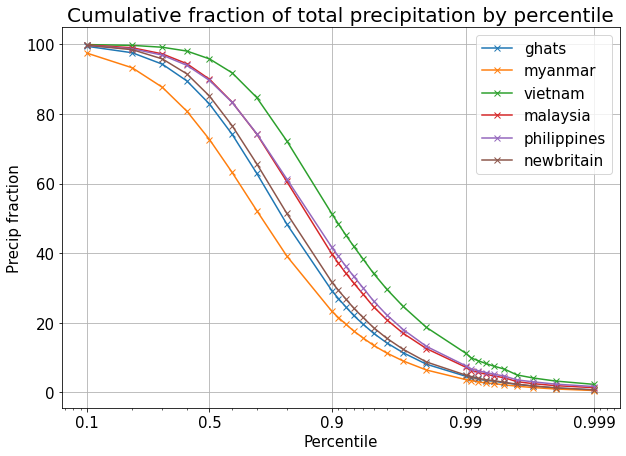

In [59]:
%%time
fig,ax=plt.subplots(1,1,figsize=(10,7))

for MR in MRs:
    plot_cdf(MR.vars['GPM_PR_ABOVE_DAILY'],ax,MR.name)
#plot_cdf(mtnprecip.isel(Time=slice(200,800)).load(),ax,'6-hourly')
#plot_cdf(hourlymtnprecip.isel(Time=slice(1200,4800)).load(),ax,'hourly')

ax.grid()

## U,W, etc on highly rainy days vs mean

Text(0.5, 1.0, 'Perturbation q climatology (nondim)')

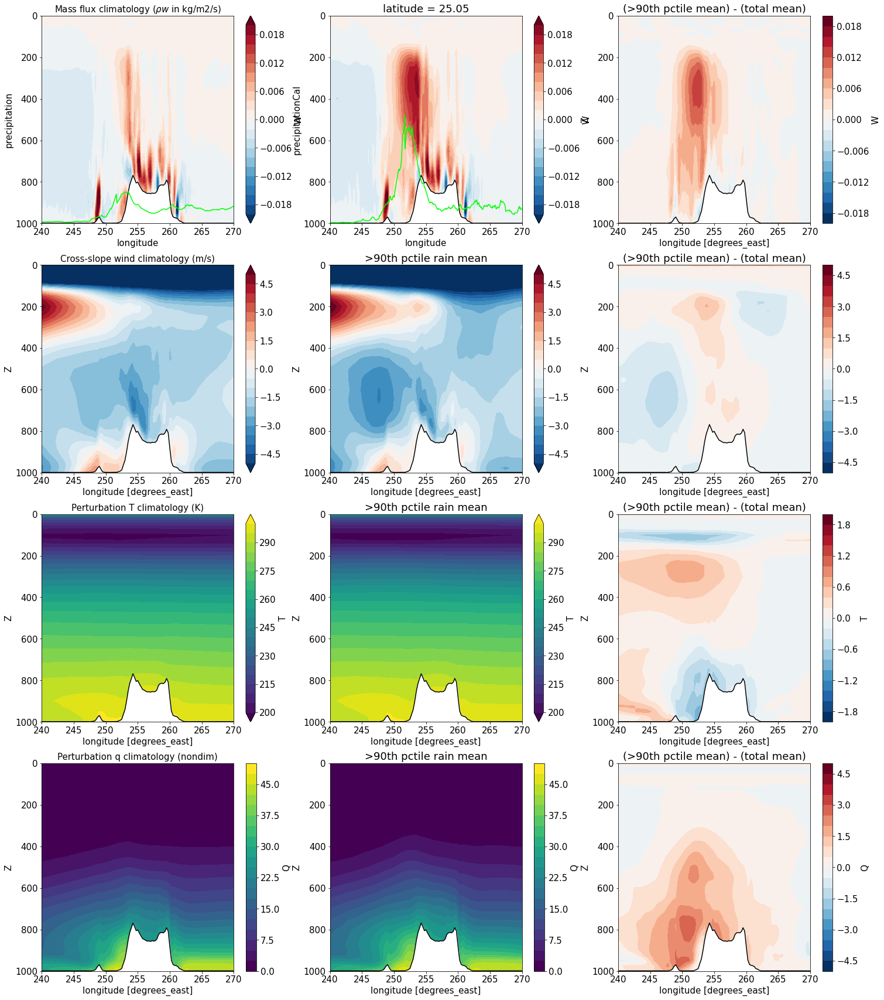

In [24]:
fig,axs = plt.subplots(4,3,figsize=(25,30))
lat0=25;lon0=247

for i,(varbase,varpr90,levs,levsdiff) in enumerate(((-1/9.81*SMO.vars['W'],-1/9.81*SMO.vars['W_PR90'],np.linspace(-0.02,0.02,21),np.linspace(-0.02,0.02,21)),
                                     (SMO.vars['U_PERP'],SMO.vars['U_PERP_PR90'],np.linspace(-5,5,21),np.linspace(-5,5,21)),
                                     (SMO.vars['T'],SMO.vars['T_PR90'],np.linspace(200,300,21),np.linspace(-2,2,21)),
                                     (2.5e3*SMO.vars['Q'],2.5e3*SMO.vars['Q_PR90'],np.linspace(0,50,21),np.linspace(-5,5,21)),
                                    )):
    varbase.sel(latitude=lat0).plot.contourf(ax=axs[i,0],levels=levs)
    varpr90.sel(latitude=lat0).plot.contourf(ax=axs[i,1],levels=levs)
    (varpr90-varbase).sel(latitude=lat0).plot.contourf(ax=axs[i,2],levels=levsdiff)

for ax in axs.reshape(-1):
    ax.set_ylim(1000,0)
    p_sfc = 999-SMO.vars['Z'].sel(latitude=lat0)/(1.1*9.81)
    p_sfc.plot(ax=ax,color='k')
    ax.fill_between(p_sfc.longitude,0*p_sfc+1000.,p_sfc,color='w')

for ax in axs:
    ax[1].set_title(">90th pctile rain mean")
    ax[2].set_title("(>90th pctile mean) - (total mean)")
    
(1000-20*SMO.vars['GPM_PR'].sel(latitude=lat0,method='nearest')).plot(ax=axs[0,0],color='lime')
(1000-20*SMO.vars['GPM_PR_PR90'].sel(latitude=lat0,method='nearest')).plot(ax=axs[0,1],color='lime')
    
axs[0,0].set_title(r'Mass flux climatology ($\rho w$ in kg/m2/s)',fontsize=15)
axs[1,0].set_title(r'Cross-slope wind climatology (m/s)',fontsize=15)
axs[2,0].set_title(r'Perturbation T climatology (K)',fontsize=15)
axs[3,0].set_title(r'Perturbation q climatology (nondim)',fontsize=15)

Text(0.5, 1.0, 'Perturbation q climatology (nondim)')

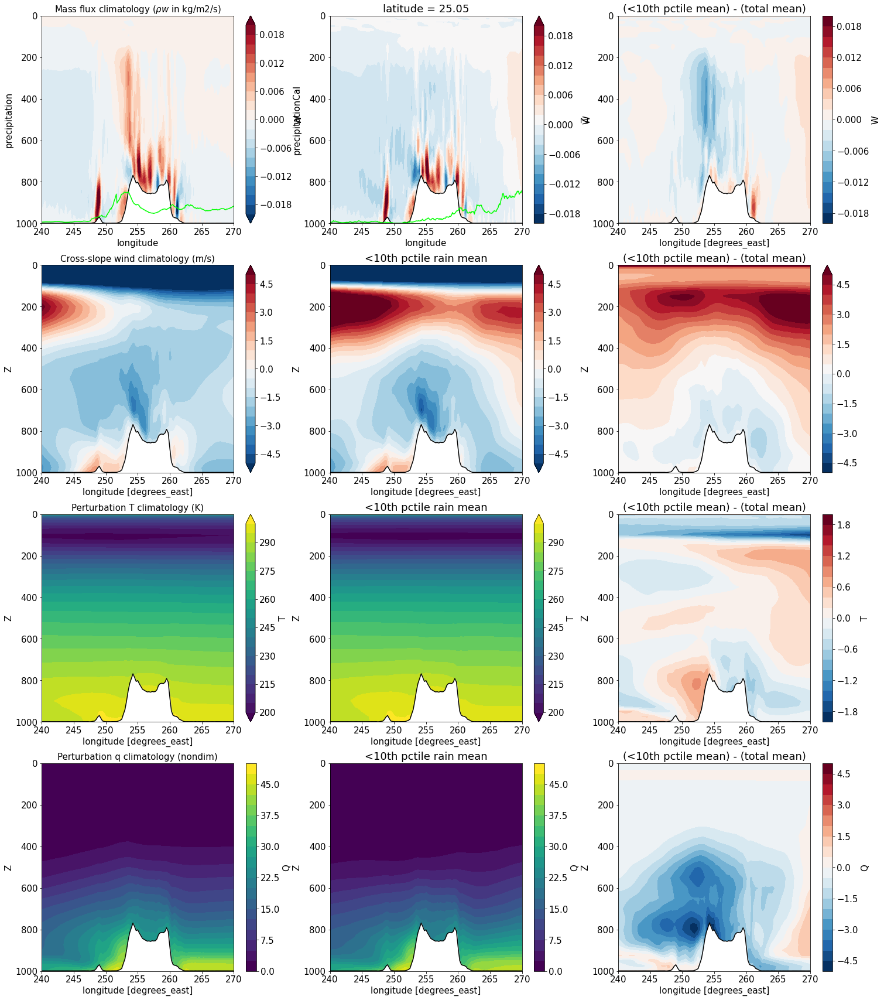

In [25]:
fig,axs = plt.subplots(4,3,figsize=(25,30))
lat0=25;lon0=247

for i,(varbase,varpr90,levs,levsdiff) in enumerate(((-1/9.81*SMO.vars['W'],-1/9.81*SMO.vars['W_PR10'],np.linspace(-0.02,0.02,21),np.linspace(-0.02,0.02,21)),
                                     (SMO.vars['U_PERP'],SMO.vars['U_PERP_PR10'],np.linspace(-5,5,21),np.linspace(-5,5,21)),
                                     (SMO.vars['T'],SMO.vars['T_PR10'],np.linspace(200,300,21),np.linspace(-2,2,21)),
                                     (2.5e3*SMO.vars['Q'],2.5e3*SMO.vars['Q_PR10'],np.linspace(0,50,21),np.linspace(-5,5,21)),
                                    )):
    varbase.sel(latitude=lat0).plot.contourf(ax=axs[i,0],levels=levs)
    varpr90.sel(latitude=lat0).plot.contourf(ax=axs[i,1],levels=levs)
    (varpr90-varbase).sel(latitude=lat0).plot.contourf(ax=axs[i,2],levels=levsdiff)
    
for ax in axs.reshape(-1):
    ax.set_ylim(1000,0)
    p_sfc = 999-SMO.vars['Z'].sel(latitude=lat0)/(1.1*9.81)
    p_sfc.plot(ax=ax,color='k')
    ax.fill_between(p_sfc.longitude,0*p_sfc+1000.,p_sfc,color='w')
    
for ax in axs:
    ax[1].set_title("<10th pctile rain mean")
    ax[2].set_title("(<10th pctile mean) - (total mean)")
(1000-20*SMO.vars['GPM_PR'].sel(latitude=lat0,method='nearest')).plot(ax=axs[0,0],color='lime')
(1000-20*SMO.vars['GPM_PR_PR10'].sel(latitude=lat0,method='nearest')).plot(ax=axs[0,1],color='lime')
      

axs[0,0].set_title(r'Mass flux climatology ($\rho w$ in kg/m2/s)',fontsize=15)
axs[1,0].set_title(r'Cross-slope wind climatology (m/s)',fontsize=15)
axs[2,0].set_title(r'Perturbation T climatology (K)',fontsize=15)
axs[3,0].set_title(r'Perturbation q climatology (nondim)',fontsize=15)

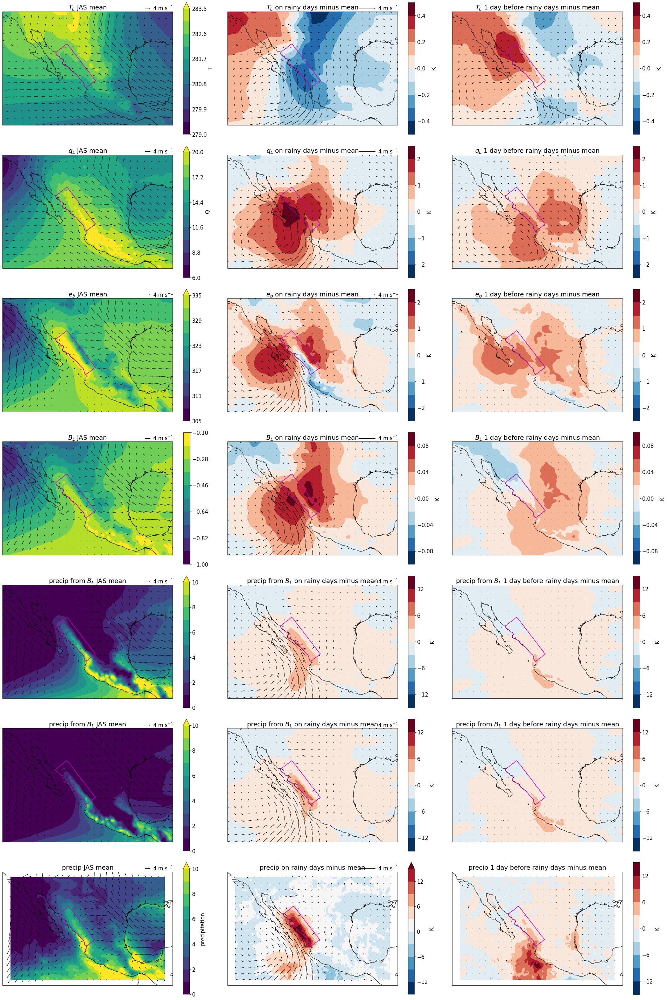

In [204]:
fig,axss = plt.subplots(7,3,figsize=(27,40),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1

for ax in axss.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for axs,var,var2,varref,varname,bounds,scale in zip(axss,
                                                    (SMO.vars['TL_PR90'],2.5e3*SMO.vars['QL_PR90'],SMO.vars['EB_PR90'],SMO.vars['BLSIMPLE_PR90'],fit_func_5daily(SMO.vars['BLSIMPLE_PR90']),fit_func_daily_e5(SMO.vars['BLSIMPLE_PR90']),SMO.vars['GPM_PR_PR90'].transpose()),
                                                    (SMO.vars['TL_PR90_P2'],2.5e3*SMO.vars['QL_PR90_P2'],SMO.vars['EB_PR90_P2'],SMO.vars['BLSIMPLE_PR90_P2'],fit_func_5daily(SMO.vars['BLSIMPLE_PR90_P2']),fit_func_daily_e5(SMO.vars['BLSIMPLE_PR90_P2']),SMO.vars['GPM_PR_PR90_P2'].transpose()),
                                                    (SMO.vars['TL'],2.5e3*SMO.vars['QL'],SMO.vars['EB'],SMO.vars['BLSIMPLE'],fit_func_5daily(SMO.vars['BLSIMPLE']),fit_func_daily_e5(SMO.vars['BLSIMPLE']),SMO.vars['GPM_PR']),
                                                    (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$",r"precip from $B_L$","precip"),
                                                    ((279,283.5),(6,20),(305,335),(-1,-0.1),(0,10),(0,10),(0,10)),
                                                    (0.5,2.5,2.5,0.1,15,15,15)):
    varref.plot.contourf(ax=axs[0],levels=np.linspace(*bounds,11),transform=ccrs.PlateCarree())
    (var-varref).plot.contourf(ax=axs[1],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    (var2-varref).plot.contourf(ax=axs[2],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    axs[0].set_title(varname+' JAS mean')
    axs[1].set_title(varname+' on rainy days minus mean')
    axs[2].set_title(varname+' 1 day before rainy days minus mean')


for i,axs in enumerate(axss):
    if i<2:
        u = SMO.vars['UL_PR90'];u2 = SMO.vars['UL_PR90_P2'];uref = SMO.vars['UL']
        v = SMO.vars['VL_PR90'];v2 = SMO.vars['VL_PR90_P2'];vref = SMO.vars['VL']
    else:
        u = SMO.vars['VAR_100U_PR90'];u2 = SMO.vars['VAR_100U_PR90_P2'];uref = SMO.vars['VAR_100U']
        v = SMO.vars['VAR_100V_PR90'];v2 = SMO.vars['VAR_100V_PR90_P2'];vref = SMO.vars['VAR_100V']
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q0=axs[0].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(uref)[::n,::m], np.array(vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=120)
    q1=axs[1].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u-uref)[::n,::m], np.array(v-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=40)
    q2=axs[2].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u2-uref)[::n,::m], np.array(v2-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=40)
    axs[0].quiverkey(q0, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
    axs[1].quiverkey(q1, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
fig.tight_layout()


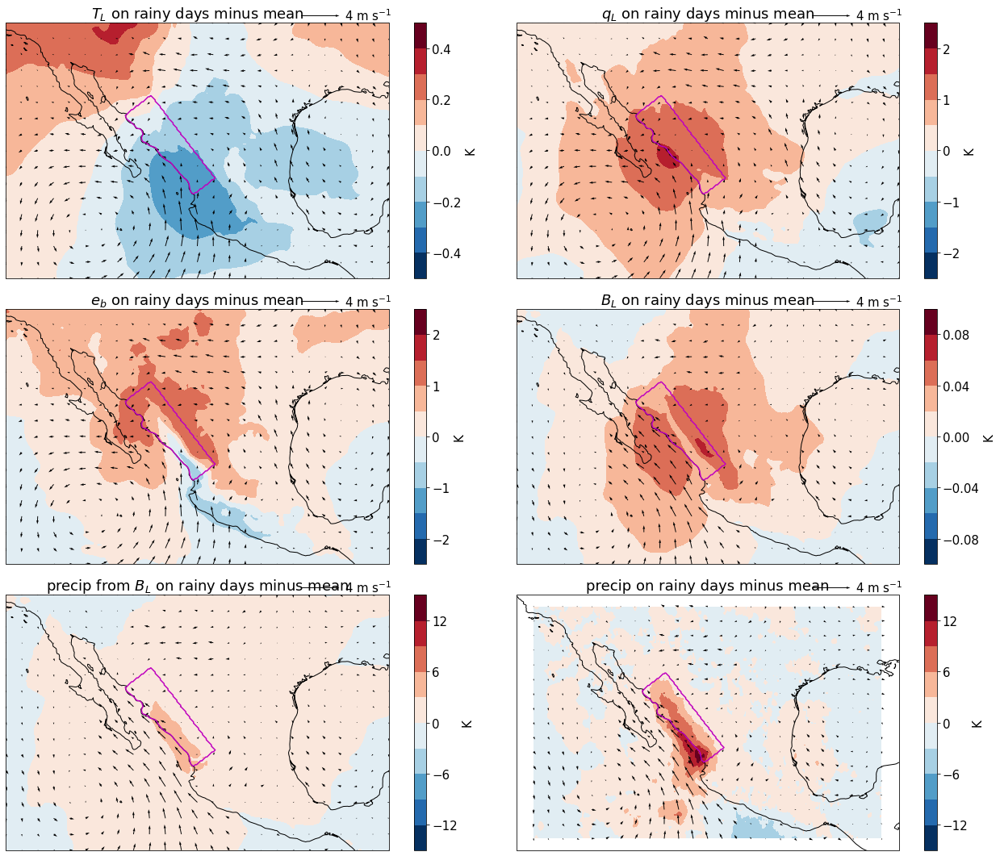

In [167]:
fig,axs = plt.subplots(3,2,figsize=(18,15),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varref,varname,scale in zip(axs,
                                                    (SMO.vars['TL_PR8095'],2.5e3*SMO.vars['QL_PR8095'],SMO.vars['EB_PR8095'],SMO.vars['BLSIMPLE_PR8095'],fit_func_5daily(SMO.vars['BLSIMPLE_PR8095']),SMO.vars['GPM_PR_PR8095'].transpose()),
                                                    (SMO.vars['TL'],2.5e3*SMO.vars['QL'],SMO.vars['EB'],SMO.vars['BLSIMPLE'],fit_func_5daily(SMO.vars['BLSIMPLE']),SMO.vars['GPM_PR']),
                                                    (r"$T_L$",r"$q_L$",r"$e_b$",r"$B_L$",r"precip from $B_L$","precip"),
                                                    (0.5,2.5,2.5,0.1,15,15)):
    (var-varref).plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    ax.set_title(varname+' on rainy days minus mean')

for i,ax in enumerate(axs):
    if i<3:
        u = SMO.vars['UL_PR8095'];uref = SMO.vars['UL']
        v = SMO.vars['VL_PR8095'];vref = SMO.vars['VL']
    else:
        u = SMO.vars['VAR_100U_PR8095'];uref = SMO.vars['VAR_100U']
        v = SMO.vars['VAR_100V_PR8095'];vref = SMO.vars['VAR_100V']
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u-uref)[::n,::m], np.array(v-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=40)
    ax.quiverkey(q, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
fig.tight_layout()


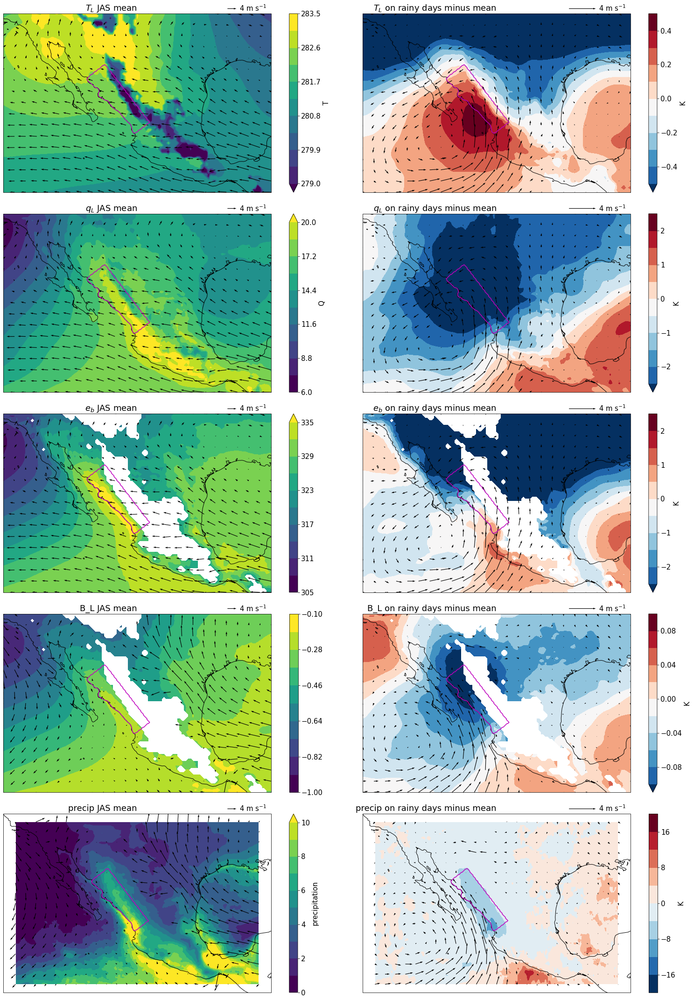

In [53]:
fig,axss = plt.subplots(5,2,figsize=(11*2,30),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1

for ax in axss.reshape(-1):
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for axs,var,varref,varname,bounds,scale in zip(axss,
                                               (SMO.vars['TL_PR10'],SMO.vars['QL_PR10'],SMO.vars['EB_PR10'],SMO.vars['BLSIMPLE_PR10'],SMO.vars['GPM_PR_PR10'].transpose()),
                                               (SMO.vars['TL'],SMO.vars['QL'],SMO.vars['EB'],SMO.vars['BLSIMPLE'],SMO.vars['GPM_PR']),
                                               (r"$T_L$",r"$q_L$",r"$e_b$",r"B_L","precip"),
                                               ((279,283.5),(6,20),(305,335),(-1,-0.1),(0,10)),
                                               (0.5,2.5,2.5,0.1,20)):
    varref.plot.contourf(ax=axs[0],levels=np.linspace(*bounds,11),transform=ccrs.PlateCarree())
    (var-varref).plot.contourf(ax=axs[1],levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    axs[0].set_title(varname+' JAS mean',{'horizontalalignment': 'right'})
    axs[1].set_title(varname+' on rainy days minus mean',{'horizontalalignment': 'right'})

for i,axs in enumerate(axss):
    if i<3:
        u = SMO.vars['UL_PR90'];uref = SMO.vars['UL']
        v = SMO.vars['VL_PR90'];vref = SMO.vars['VL']
    else:
        u = SMO.vars['UB_PR90'];uref = SMO.vars['UB']
        v = SMO.vars['VB_PR90'];vref = SMO.vars['VB']
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q0=axs[0].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(uref)[::n,::m], np.array(vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=120)
    q1=axs[1].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u-uref)[::n,::m], np.array(v-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=40)
    axs[0].quiverkey(q0, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
    axs[1].quiverkey(q1, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
fig.tight_layout()


## Individual days

In [58]:
ags = np.argsort(pr_timeseries)


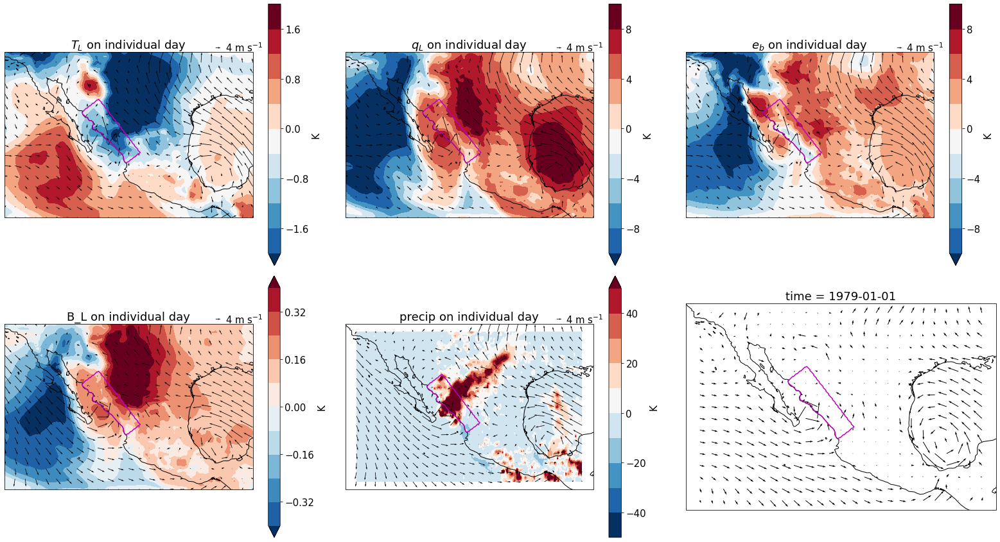

In [78]:
idx = ags[-1]
fig,axs = plt.subplots(2,3,figsize=(11*2,12),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs:
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varref,varname,scale in zip(axs,
                                       (SMO.vars['TL_DAILY'][idx],2.5e3*SMO.vars['QL_DAILY'][idx],SMO.vars['EB_DAILY'][idx],SMO.vars['BLSIMPLE_DAILY'][idx],SMO.vars['GPM_PR_DAILY'][idx].transpose()),
                                       (SMO.vars['TL'],2.5e3*SMO.vars['QL'],SMO.vars['EB'],SMO.vars['BLSIMPLE'],SMO.vars['GPM_PR']),
                                       (r"$T_L$",r"$q_L$",r"$e_b$",r"B_L","precip"),
                                       (2,10,10,0.4,50)):
    (var-varref).plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    ax.set_title(varname+' on individual day')

for i,ax in enumerate(axs[:5]):
    if i<3:
        u = SMO.vars['UL_DAILY'][idx];uref = SMO.vars['UL']
        v = SMO.vars['VL_DAILY'][idx];vref = SMO.vars['VL']
    else:
        u = SMO.vars['VAR_100U_DAILY'][idx];uref = SMO.vars['VAR_100U']
        v = SMO.vars['VAR_100V_DAILY'][idx];vref = SMO.vars['VAR_100V']
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q1=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
    ax.quiverkey(q1, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
axs[5].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u-uref)[::n,::m], np.array(v-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
    
fig.tight_layout()


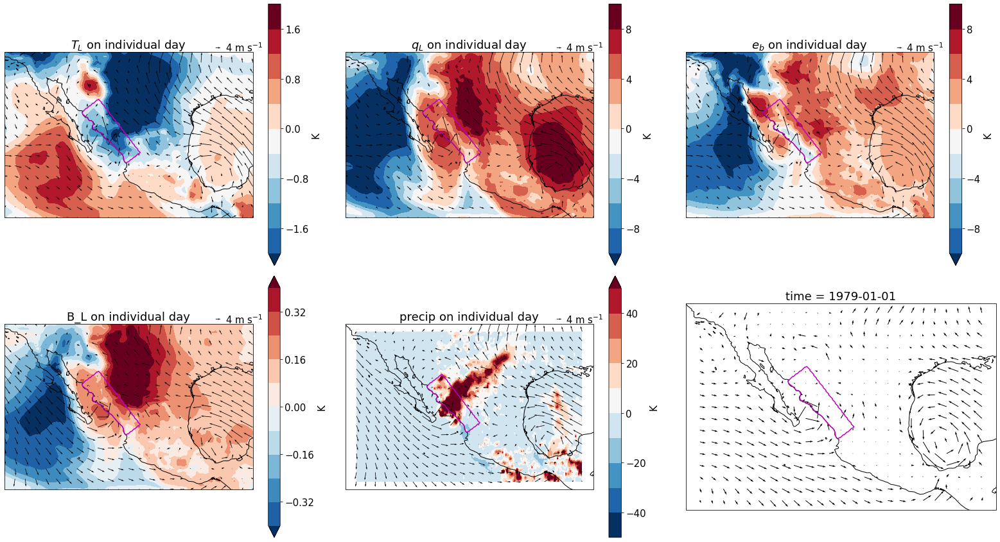

In [78]:
idx = ags[-1]
fig,axs = plt.subplots(2,3,figsize=(11*2,12),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs:
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varref,varname,scale in zip(axs,
                                       (SMO.vars['TL_DAILY'][idx],2.5e3*SMO.vars['QL_DAILY'][idx],SMO.vars['EB_DAILY'][idx],SMO.vars['BLSIMPLE_DAILY'][idx],SMO.vars['GPM_PR_DAILY'][idx].transpose()),
                                       (SMO.vars['TL'],2.5e3*SMO.vars['QL'],SMO.vars['EB'],SMO.vars['BLSIMPLE'],SMO.vars['GPM_PR']),
                                       (r"$T_L$",r"$q_L$",r"$e_b$",r"B_L","precip"),
                                       (2,10,10,0.4,50)):
    (var-varref).plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    ax.set_title(varname+' on individual day')

for i,ax in enumerate(axs[:5]):
    if i<3:
        u = SMO.vars['UL_DAILY'][idx];uref = SMO.vars['UL']
        v = SMO.vars['VL_DAILY'][idx];vref = SMO.vars['VL']
    else:
        u = SMO.vars['VAR_100U_DAILY'][idx];uref = SMO.vars['VAR_100U']
        v = SMO.vars['VAR_100V_DAILY'][idx];vref = SMO.vars['VAR_100V']
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q1=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
    ax.quiverkey(q1, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
axs[5].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u-uref)[::n,::m], np.array(v-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
    
fig.tight_layout()


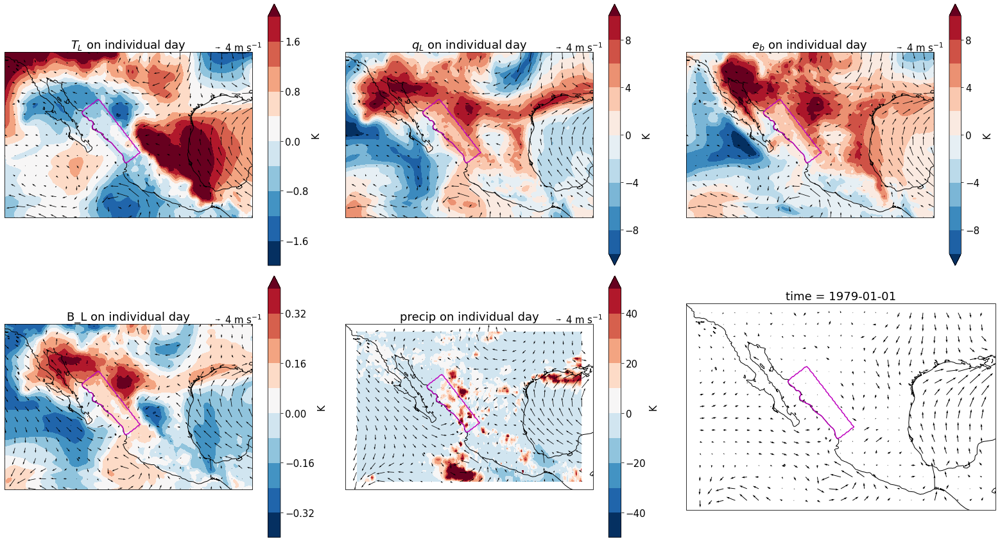

In [79]:
idx = ags[1700]
fig,axs = plt.subplots(2,3,figsize=(11*2,12),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs:
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varref,varname,scale in zip(axs,
                                       (SMO.vars['TL_DAILY'][idx],2.5e3*SMO.vars['QL_DAILY'][idx],SMO.vars['EB_DAILY'][idx],SMO.vars['BLSIMPLE_DAILY'][idx],SMO.vars['GPM_PR_DAILY'][idx].transpose()),
                                       (SMO.vars['TL'],2.5e3*SMO.vars['QL'],SMO.vars['EB'],SMO.vars['BLSIMPLE'],SMO.vars['GPM_PR']),
                                       (r"$T_L$",r"$q_L$",r"$e_b$",r"B_L","precip"),
                                       (2,10,10,0.4,50)):
    (var-varref).plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    ax.set_title(varname+' on individual day')

for i,ax in enumerate(axs[:5]):
    if i<3:
        u = SMO.vars['UL_DAILY'][idx];uref = SMO.vars['UL']
        v = SMO.vars['VL_DAILY'][idx];vref = SMO.vars['VL']
    else:
        u = SMO.vars['VAR_100U_DAILY'][idx];uref = SMO.vars['VAR_100U']
        v = SMO.vars['VAR_100V_DAILY'][idx];vref = SMO.vars['VAR_100V']
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q1=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
    ax.quiverkey(q1, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
axs[5].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u-uref)[::n,::m], np.array(v-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
   
fig.tight_layout()


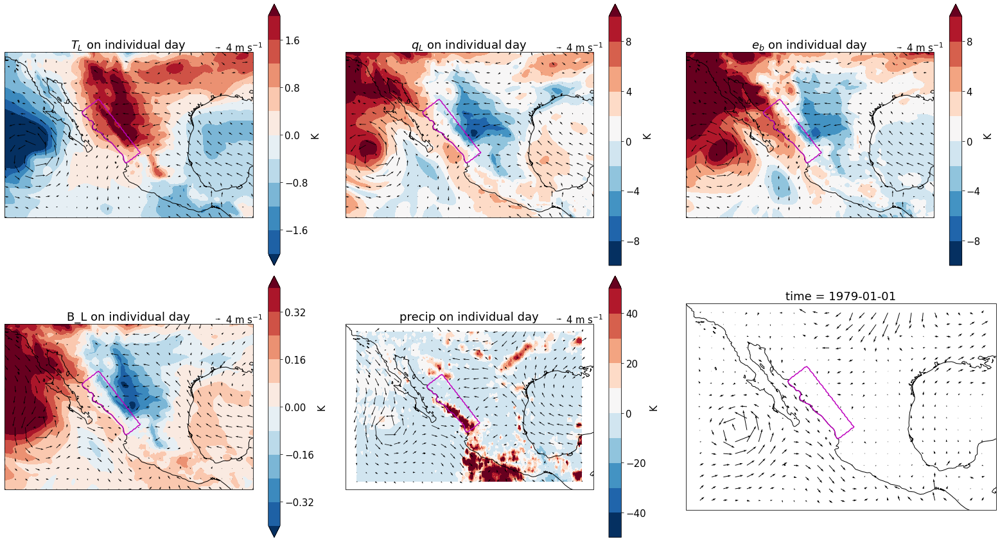

In [80]:
idx = ags[1800]
fig,axs = plt.subplots(2,3,figsize=(11*2,12),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
axs=axs.reshape(-1)
for ax in axs:
    ax.coastlines()
    SMO.precipmask.plot.contour(ax=ax,levels=[0.5],colors='m')
    
for ax,var,varref,varname,scale in zip(axs,
                                       (SMO.vars['TL_DAILY'][idx],2.5e3*SMO.vars['QL_DAILY'][idx],SMO.vars['EB_DAILY'][idx],SMO.vars['BLSIMPLE_DAILY'][idx],SMO.vars['GPM_PR_DAILY'][idx].transpose()),
                                       (SMO.vars['TL'],2.5e3*SMO.vars['QL'],SMO.vars['EB'],SMO.vars['BLSIMPLE'],SMO.vars['GPM_PR']),
                                       (r"$T_L$",r"$q_L$",r"$e_b$",r"B_L","precip"),
                                       (2,10,10,0.4,50)):
    (var-varref).plot.contourf(ax=ax,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K'},transform=ccrs.PlateCarree())
    ax.set_title(varname+' on individual day')

for i,ax in enumerate(axs[:5]):
    if i<3:
        u = SMO.vars['UL_DAILY'][idx];uref = SMO.vars['UL']
        v = SMO.vars['VL_DAILY'][idx];vref = SMO.vars['VL']
    else:
        u = SMO.vars['VAR_100U_DAILY'][idx];uref = SMO.vars['VAR_100U']
        v = SMO.vars['VAR_100V_DAILY'][idx];vref = SMO.vars['VAR_100V']
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q1=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
    ax.quiverkey(q1, 0.87, 1.03, 4, r'4 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
axs[5].quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u-uref)[::n,::m], np.array(v-vref)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=200)
   
fig.tight_layout()


## Regressions

(-1.0, 3.0)

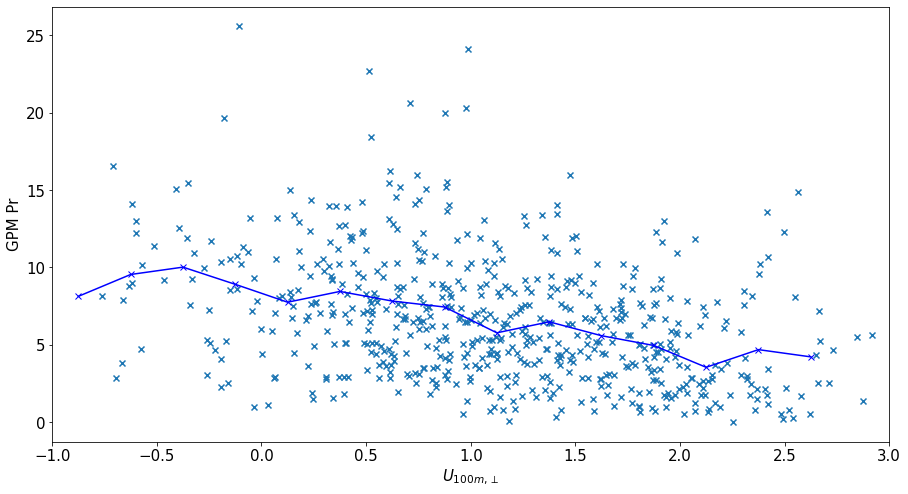

In [68]:
_,ax=plt.subplots(1,1,figsize=(15,8))
ax.scatter(upslopeflow_timeseries,pr_timeseries,marker='x')
ax.plot(*get_binned(upslopeflow_timeseries,pr_timeseries,np.arange(-1,4,0.25)),'-xb')
ax.set_xlabel(r"$U_{100m,\perp}$")
ax.set_ylabel(r"GPM Pr")
ax.set_xlim(-1,3)

/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: Mean of empty slice.
  from ipykernel import kernelapp as app
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Text(0, 0.5, 'GPM Pr')

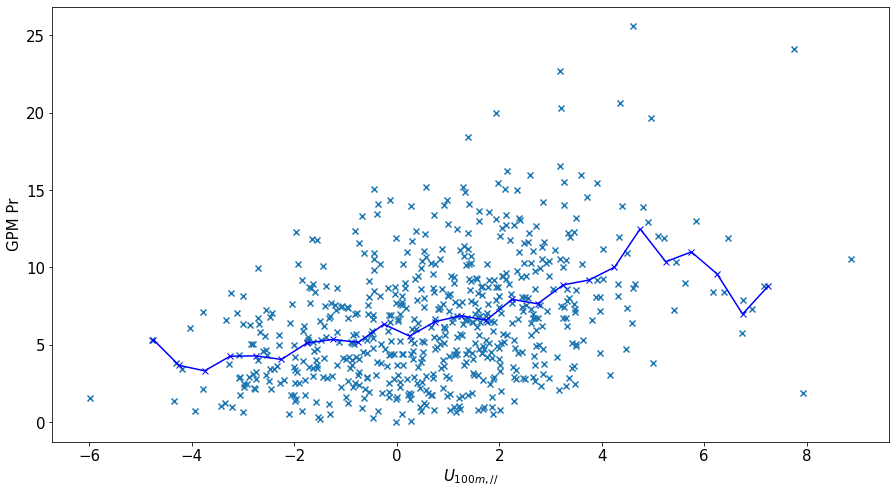

In [72]:
_,ax=plt.subplots(1,1,figsize=(15,8))
ax.scatter(alongslopeflow_timeseries,pr_timeseries,marker='x')
ax.plot(*get_binned(alongslopeflow_timeseries,pr_timeseries,np.arange(-6,8,0.5)),'-xb')
ax.set_xlabel(r"$U_{100m,//}$")
ax.set_ylabel(r"GPM Pr")
#ax.set_xlim(-1,3)

Text(0, 0.5, 'GPM Pr')

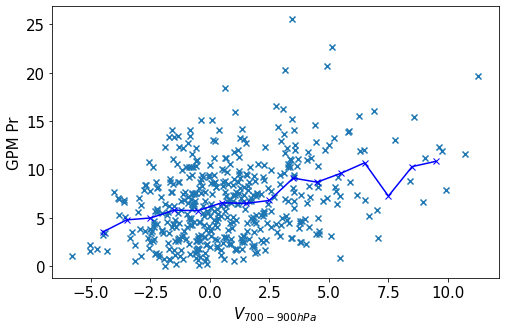

In [102]:
_,ax=plt.subplots(1,1,figsize=(8,5))
ax.scatter(v_timeseries_z.sel(level=slice(700.,900.)).mean('level'),pr_timeseries_2001_2015,marker='x')
ax.plot(*get_binned(v_timeseries_z.sel(level=slice(700.,900.)).mean('level'),pr_timeseries_2001_2015,np.arange(-5,11,1)),'-xb')
ax.set_xlabel(r"$V_{700-900 hPa}$")
ax.set_ylabel(r"GPM Pr")
#ax.set_xlim(-1,3)

/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: Mean of empty slice.
  from ipykernel import kernelapp as app
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Text(0, 0.5, 'GPM Pr')

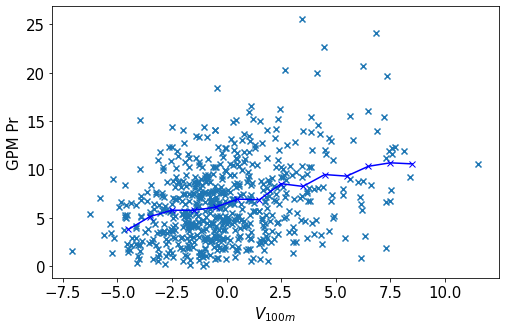

In [103]:
_,ax=plt.subplots(1,1,figsize=(8,5))
ax.scatter(v_timeseries,pr_timeseries,marker='x')
ax.plot(*get_binned(v_timeseries,pr_timeseries,np.arange(-5,11,1)),'-xb')
ax.set_xlabel(r"$V_{100m}$")
ax.set_ylabel(r"GPM Pr")
#ax.set_xlim(-1,3)

(-2.0, 4.0)

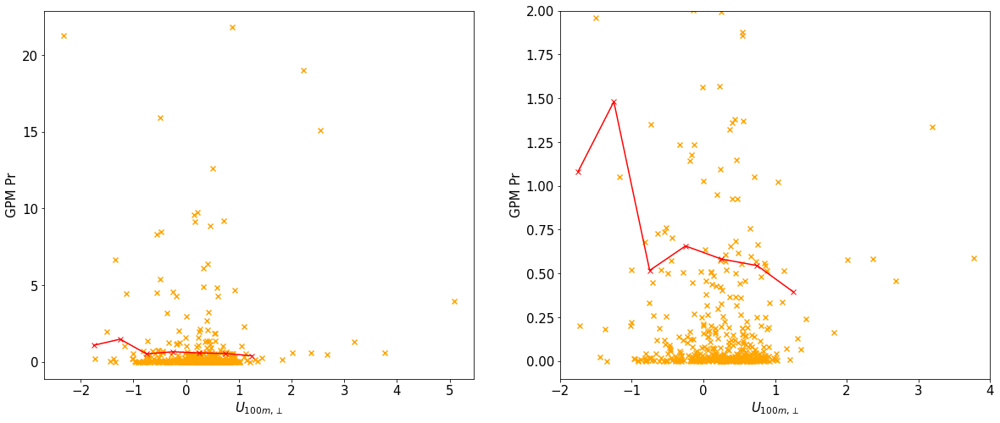

In [66]:
_,axs=plt.subplots(1,2,figsize=(20,8))
for ax in axs:
    ax.scatter(upslopeflow_timeseries_dec,pr_timeseries_dec,marker='x',color='orange')
    ax.plot(*get_binned(upslopeflow_timeseries_dec,pr_timeseries_dec,np.arange(-2,2,0.5)),'-xr')
    ax.set_xlabel(r"$U_{100m,\perp}$")
    ax.set_ylabel(r"GPM Pr")
ax.set_ylim(-0.1,2)
ax.set_xlim(-2,4)

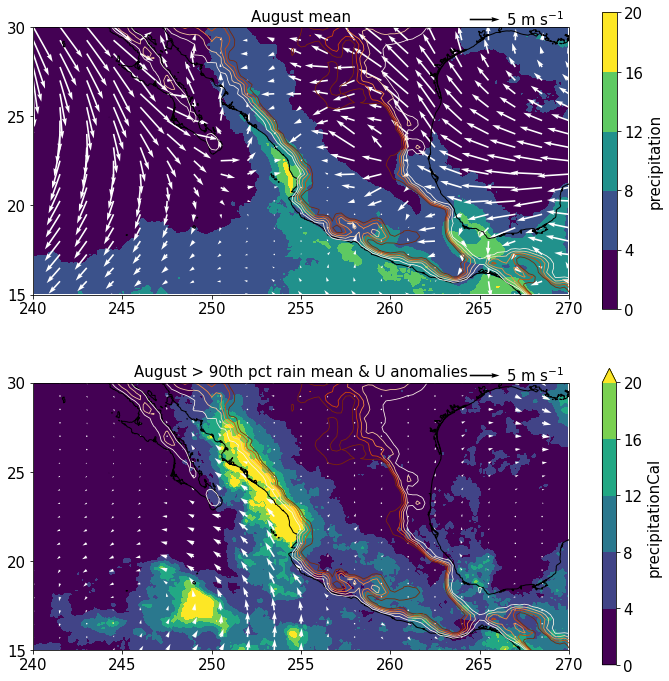

In [70]:
fig,axs = plt.subplots(2,1,figsize=(12,12),subplot_kw={"projection":ccrs.PlateCarree()})

topography_pr_wind_plot(axs[0],SMO.box,SMO.vars['Z'],SMO.vars['GPM_PR'],SMO.vars['VAR_100U'],SMO.vars['VAR_100V'],np.arange(0,21,4),windvect_density=0.05)
axs[0].set_title("August mean",fontsize=15);None

topography_pr_wind_plot(axs[1],SMO.box,SMO.vars['Z'],SMO.vars['GPM_PR_PR90'],SMO.vars['VAR_100U_PR90']-SMO.vars['VAR_100U'],SMO.vars['VAR_100V_PR90']-SMO.vars['VAR_100V'],np.arange(0,21,4),windvect_density=0.05)
axs[1].set_title("August > 90th pct rain mean & U anomalies",fontsize=15);None



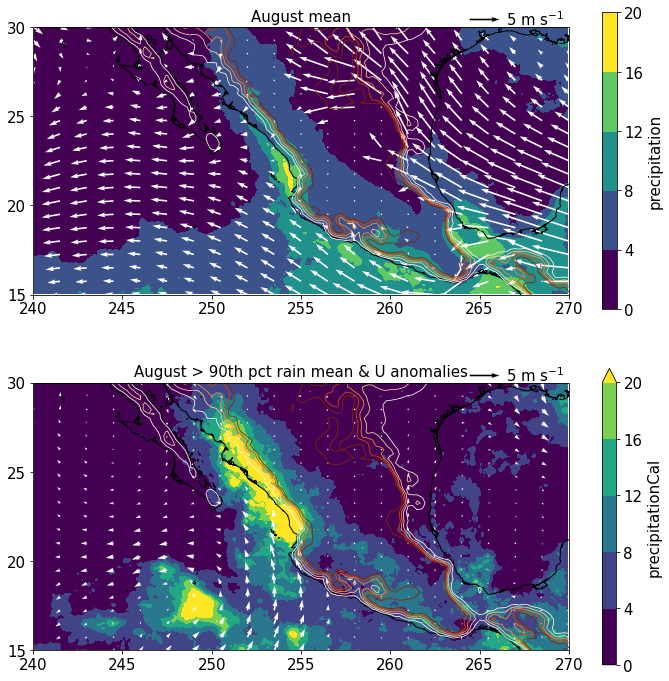

In [39]:
fig,axs = plt.subplots(2,1,figsize=(12,12),subplot_kw={"projection":ccrs.PlateCarree()})
lev=825.
filtr=SMO.vars['SP']>lev*1e2
topography_pr_wind_plot(axs[0],SMO.box,SMO.vars['Z'],SMO.vars['GPM_PR'],filtr*SMO.vars['U'].sel(level=lev),filtr*SMO.vars['V'].sel(level=lev),np.arange(0,21,4),windvect_density=0.05)
axs[0].set_title("August mean",fontsize=15);None

topography_pr_wind_plot(axs[1],SMO.box,SMO.vars['Z'],SMO.vars['GPM_PR_PR90'],filtr*(SMO.vars['U_PR90'].sel(level=lev)-SMO.vars['U'].sel(level=lev)),filtr*(SMO.vars['V_PR90'].sel(level=lev)-SMO.vars['V'].sel(level=lev)),np.arange(0,21,4),windvect_density=0.05)
axs[1].set_title("August > 90th pct rain mean & U anomalies",fontsize=15);None



In [23]:
from orographicPrecipitation.precip_model_functions import qsat
Tsurf=np.array(SMO.vars['T'].sel(level=1000.))
qsurf=np.array(SMO.vars['Q'].sel(level=1000.))
psurf = 1000*qsurf**0
qsatsurf = qsat(Tsurf,1000.)
thetae_ar = np.array(mpcalc.equivalent_potential_temperature(psurf*units.hPa,
                                                             Tsurf*units.K,
                                                             mpcalc.dewpoint_from_relative_humidity(Tsurf*units.K,qsurf/qsatsurf)
                                                            ))
thetae = thetae_ar * SMO.vars['T'].sel(level=1000.)**0

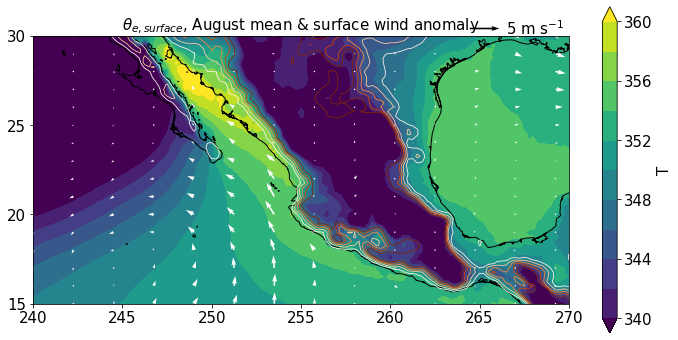

In [66]:
fig,ax = plt.subplots(1,1,figsize=(12,6),subplot_kw={"projection":ccrs.PlateCarree()})
topography_pr_wind_plot(ax,SMO.box,SMO.vars['Z'],thetae,SMO.vars['VAR_100U_PR90']-SMO.vars['VAR_100U'],SMO.vars['VAR_100V_PR90']-SMO.vars['VAR_100V'],np.arange(340.,360.1,2.),windvect_density=0.08,cmap=plt.cm.viridis)
ax.set_title(r"$\theta_{e,surface}$, August mean & surface wind anomaly",fontsize=15);None



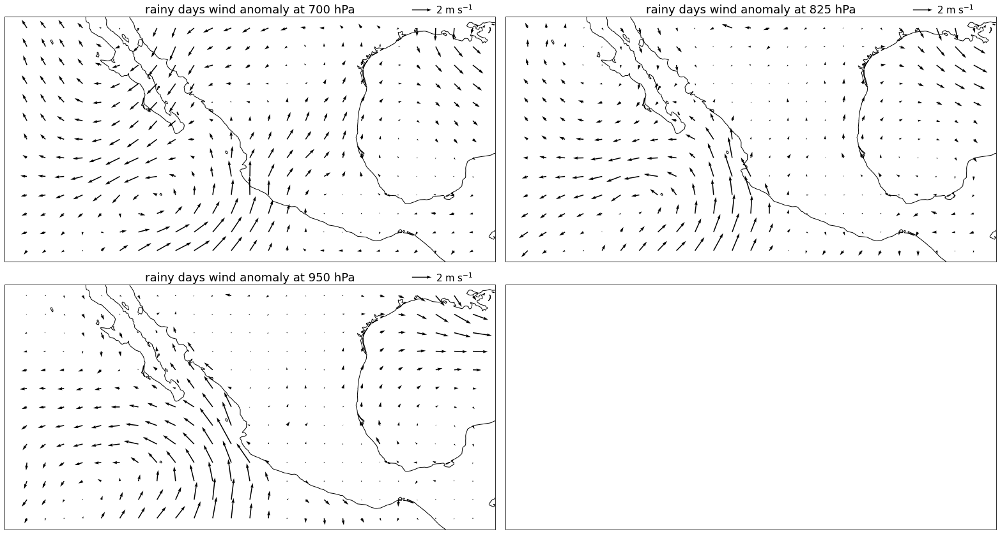

In [82]:
def plot_u_anom_daily(condition,levs):
    fig,axs = plt.subplots(2,2,figsize=(11*2,6*2),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
    axs=axs.reshape(-1)
    for i,lev in enumerate(levs):
        ax=axs[i]

        u = (SMO.vars['U_PR90']-SMO.vars['U']).sel(level=lev)
        v = (SMO.vars['V_PR90']-SMO.vars['V']).sel(level=lev)
        
        X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
        Y = u.longitude.expand_dims({"latitude":u.latitude})
        n=5
        m=5
        q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="k",width=0.002,scale=50)
        qk = ax.quiverkey(q, 0.87, 1.03, 2, r'2 m s$^{-1}$', labelpos='E',
                               coordinates='axes',color='k')
        ax.coastlines()
        ax.set_title('rainy days wind anomaly at %i hPa'%lev)
    fig.tight_layout()

plot_u_anom_daily(gpm_pr_rainycond,[700.,825.,950.])

In [132]:
def resample_daily(ds):
    """performs the same job as resample(time="1D") but keeps missing days out"""
    ds.coords['time'] = ds.time.dt.floor('1D')
    return ds.groupby('time').mean()
%time era5u_smo_augd = resample_daily(era5u_smo_augdaily).load()
%time era5v_smo_augd = resample_daily(era5v_smo_augdaily).load()

CPU times: user 1min 6s, sys: 2min 4s, total: 3min 11s
Wall time: 16.4 s


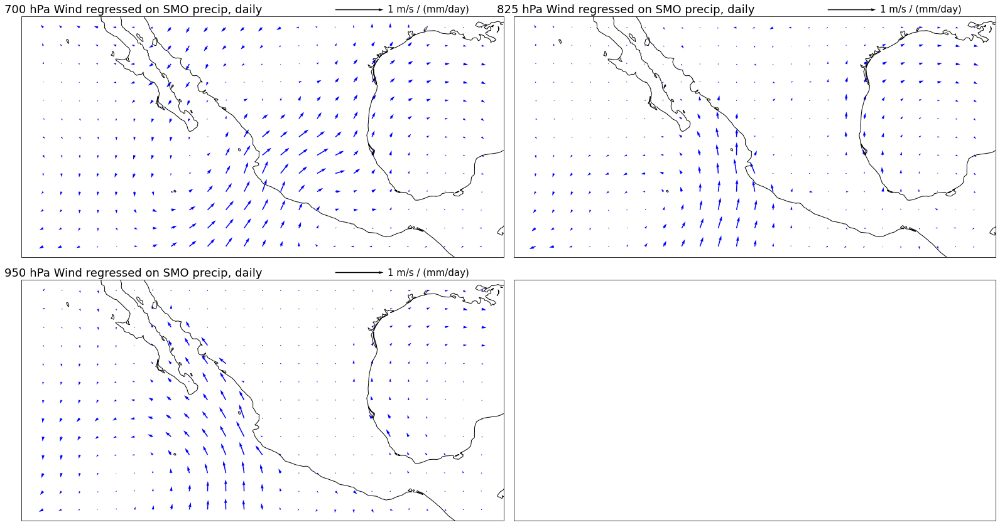

In [136]:
def plot_u_reg_daily(levs):
    fig,axs = plt.subplots(2,2,figsize=(11*2,6*2),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
    axs=axs.reshape(-1)
    for i,lev in enumerate(levs):
        ax=axs[i]
        pr_index = pr_timeseries_2001_2015
        filtr = SMO.vars['SP']>lev*1e2
        ureg = filtr*era5u_smo_augd.sel(level=lev).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        vreg = filtr*era5v_smo_augd.sel(level=lev).assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
        
        u = ureg
        v = vreg
        
        X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
        Y = u.longitude.expand_dims({"latitude":u.latitude})
        n=5
        m=5
        q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="b",width=0.002,scale=10)
        qk = ax.quiverkey(q, 0.75, 1.03, 1, r'1 m/s / (mm/day)', labelpos='E',
                               coordinates='axes',color='k')
        ax.set_title('%i hPa Wind regressed on SMO precip, daily'%lev,{'horizontalalignment': 'right'})
        ax.coastlines()
    fig.tight_layout()

plot_u_reg_daily([700.,825.,950.])

Text(0.5, 1.0, 'q anomaly on days where Pr>90th pctile (nondim)')

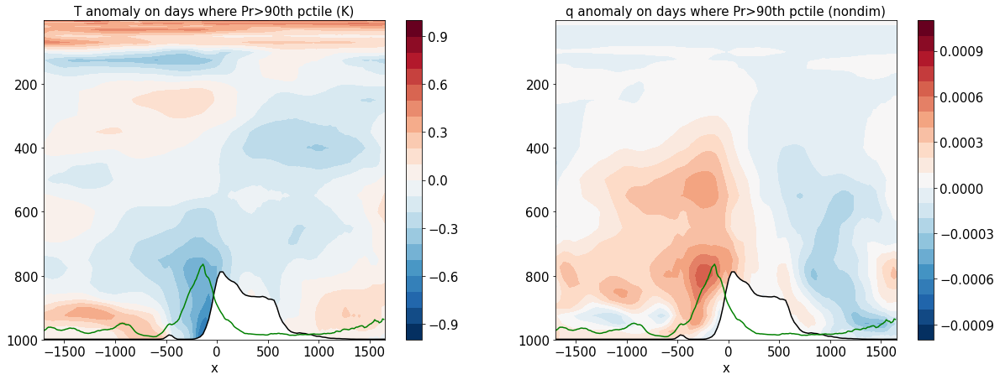

In [75]:
fig,axs = plt.subplots(1,2,figsize=(20,7))
axs=axs.reshape(-1)
crossslope_avg(SMO.vars_rot['T_PR90']-SMO.vars_rot['T'],center=smo_center).plot.contourf(ax=axs[0],yincrease=False,levels=np.arange(-1,1.1,0.1)   )
crossslope_avg(SMO.vars_rot['Q_PR90']-SMO.vars_rot['Q'],center=smo_center).plot.contourf(ax=axs[1],yincrease=False,levels=np.arange(-1e-3,1.1e-3,0.1e-3))
p_sfc = crossslope_avg(999-SMO.vars_rot['Z']/(1.1*9.81),center=smo_center)
for ax in axs:
    p_sfc.plot(ax=ax,color='k')
    ax.fill_between(p_sfc.x,0*p_sfc+1000.,p_sfc,color='w')
    (999-10*crossslope_avg(SMO.vars_rot['GPM_PR_PR90'],center=smo_center)).plot(ax=ax,color='g')


axs[0].set_title(r'T anomaly on days where Pr>90th pctile (K)',fontsize=15)
axs[1].set_title(r'q anomaly on days where Pr>90th pctile (nondim)',fontsize=15)

## Diurnal cycle

In [255]:
trmmpr_smo_augdaily = xr.open_zarr("/global/cscratch1/sd/qnicolas/regionsData/trmm.2001-2013.08.smo.zarr").pr*86400
trmmpr_smo_decdaily = xr.open_zarr("/global/cscratch1/sd/qnicolas/regionsData/trmm.2001-2013.12.smo.zarr").pr*86400


In [256]:
precipmask_trmm = tilted_rect(trmmpr_smo_augdaily,*SMO.box_tilted)*landmask.interp_like(trmmpr_smo_augdaily)
trmmpr_diurnalcycle_aug = spatial_mean(trmmpr_smo_augdaily,mask=precipmask_trmm).load().groupby('time.hour').mean()
trmmpr_diurnalcycle_dec = spatial_mean(trmmpr_smo_decdaily,mask=precipmask_trmm).load().groupby('time.hour').mean()

In [260]:
upslopeflow_hourly_dec.groupby('time.hour').mean()

<xarray.DataArray (time: 11160)>
dask.array<truediv, shape=(11160,), dtype=float64, chunksize=(744,), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 2001-12-01 ... 2015-12-31T23:00:00

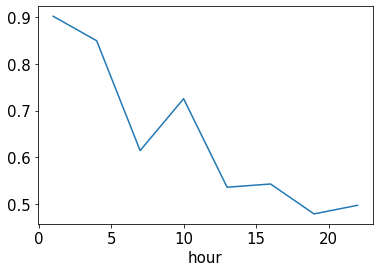

In [259]:
#trmmpr_diurnalcycle_aug.plot()
trmmpr_diurnalcycle_dec.plot()

In [268]:
uaug = upslopeflow_hourly.groupby('time.hour').mean().load()
udec = upslopeflow_hourly_dec.groupby('time.hour').mean().load()

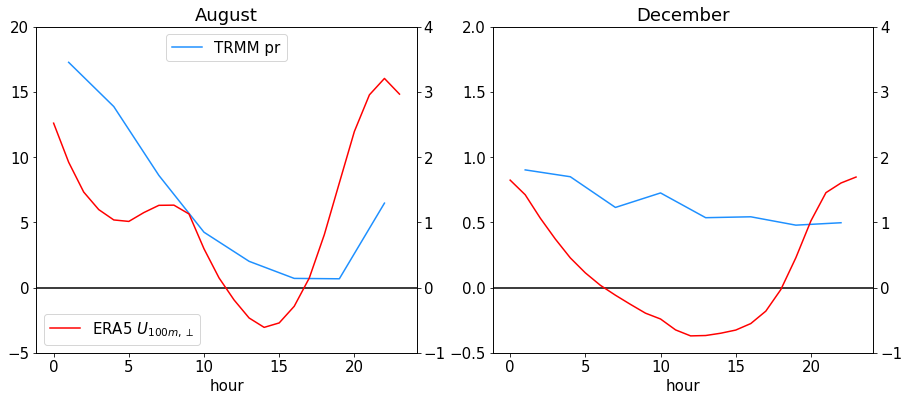

In [271]:
_,axs=plt.subplots(1,2,figsize=(15,6))

ax = axs[0]
ax2 = ax.twinx()
trmmpr_diurnalcycle_aug.plot(ax=ax,color='dodgerblue',label='TRMM pr')
uaug.plot(ax=ax2,color='r',label=r'ERA5 $U_{100m,\perp}$')
ax.set_title('August')
ax.legend(loc=9)
ax2.legend(loc=3)
ax.set_ylim(-5,20)
ax2.set_ylim(-1,4)
ax.axhline(0.,color='k')

ax = axs[1]
ax2 = ax.twinx()
trmmpr_diurnalcycle_dec.plot(ax=ax,color='dodgerblue')
udec.plot(ax=ax2,color='r')
ax.set_title('December')

ax.set_ylim(-0.5,2)
ax2.set_ylim(-1,4)
ax.axhline(0.,color='k')

## Daily B_L stuff

In [13]:
%%time
MR=SMO
MR.set_daily_sfc_var('228_246_100u','VAR_100U')
MR.set_daily_sfc_var('228_247_100v','VAR_100V')
MR.set_uperp_sfc()

MR.set_daily_uLvL()
MR.set_uperp_L(SMO.angle)

MR.set_daily_imerg()
MR.set_daily_Bl_vars()
MR.set_daily_Blsimple_vars()
MR.set_daily_Bl_vars('deep')
MR.set_daily_Blsimple_vars('deep')

for varname in 'TL','QL','EB','BL','BLSIMPLE','TLDEEP','QLDEEP','EBDEEP','BLDEEP','BLDEEPSIMPLE','GPM_PR':
    grid = MR.vars[varname+'_DAILY']
    MR.set_spatialmean(varname,'above',tilted_rect(grid,*MR.box_tilted,reverse=False),box=None)
    #MR.set_spatialmean(varname,'abovesea',tilted_rect(grid,*MR.box_tilted,reverse=False)*(landmask.interp_like(grid)<0.5),box=None)
    #MR.set_spatialmean(varname,'aboveland',tilted_rect(grid,*MR.box_tilted,reverse=False)*(landmask.interp_like(grid)>0.5),box=None)
    

#for varname in 'VAR_100U_PERP','UL_PERP','U900_PERP':
#    grid = MR.vars['VAR_100U_DAILY']
#    MR.set_spatialmean(varname,'interval',tilted_rect_distance(grid,*MR.box_tilted[:-1],0,-3),box=None)
#    MR.set_spatialmean(varname,'closeinterval',tilted_rect_distance(grid,*MR.box_tilted[:-1],0,-1),box=None)
#print('%is'%(time.time()-ti));ti = time.time()


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


CPU times: user 11.3 s, sys: 18.6 s, total: 29.9 s
Wall time: 33.7 s


Text(0.5, 1.0, 'Sierra Madre Occidental')

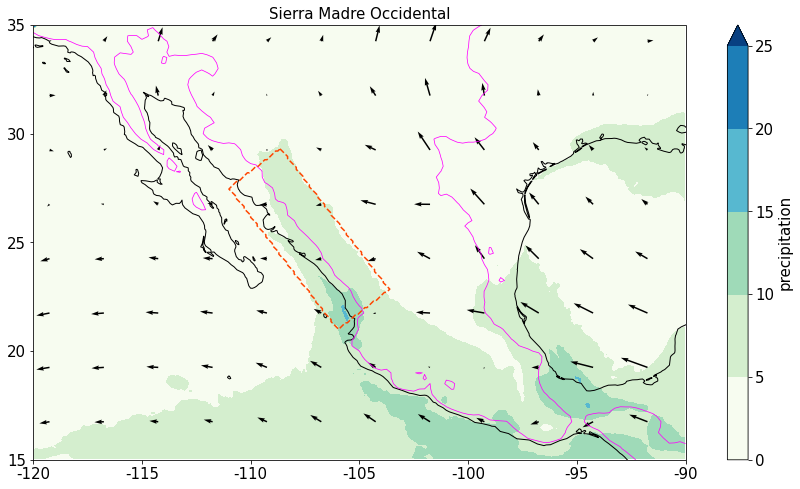

In [14]:
fig,ax = plt.subplots(1,1,figsize=(15,8),subplot_kw={'projection':ccrs.PlateCarree()})
MR=SMO
ax.set_anchor('W')
ax.coastlines()

box=MR.box
pr=sel_months(sel_box(gpm_pr_seasmean,box),MR.months).mean('month')
pr[0,0]=26.
pr.plot.contourf(ax=ax,transform=ccrs.PlateCarree(),levels=np.arange(0.,26.,5.),cmap=plt.cm.GnBu)#,cbar_kwargs={'shrink':0.8,'label':'mm/day'})

sel_box(orogm,box).plot.contour(ax=ax,transform=ccrs.PlateCarree(),levels=[500.],linewidths=[0.75],colors=['magenta'])
tilted_rect(pr,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['orangered'])

u=MR.vars['UL_DAILY'].mean('time')
v=MR.vars['VL_DAILY'].mean('time')
X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
Y = u.longitude.expand_dims({"latitude":u.latitude})
n=len(u.latitude)//8
m=n
ibeg=3
iend=-1
Q=ax.quiver(np.array(Y)[ibeg:iend:n,ibeg:iend:n],np.array(X)[ibeg:iend:n,ibeg:iend:n], np.array(u)[ibeg:iend:n,ibeg:iend:n], np.array(v)[ibeg:iend:n,ibeg:iend:n],color="k",transform=ccrs.PlateCarree(),scale=100,scale_units='height',width=1.5,units='dots')
       
dl=5
lons=np.arange(dl*(1+(int(box[0])-1)//dl),dl*(int(box[1])//dl)+1,dl)-360
ax.set_xticks(lons)
ax.set_xticklabels(lons)
lats=range(dl*(1+(int(box[2])-1)//dl),dl*(int(box[3])//dl)+1,dl)
ax.set_yticks(lats)
ax.set_yticklabels(lats)
ax.set_xlabel("")
ax.set_ylabel("")
ax.set_title(MR.Lname,fontsize=15)


In [20]:
from scipy.optimize import curve_fit
def fit(pred,dep,model='linear'):
    predrange = np.linspace(np.min(pred),np.max(pred),41)
    if model=='linear':
        func = lambda x,a,b : a*x+b
    elif model=='exponential':
        func = lambda x,a,b : np.exp(a*x+b)
    elif model=='softplus':
        func = lambda x,a,b : np.log(1+np.exp(a*x+b))
    popt,_ = curve_fit(func,pred,dep)
    fitrange = func(predrange,*popt)
    residual = dep - func(pred,*popt)
    rss = np.sum(residual**2)
    tss = len(dep)*np.var(dep)
    rsq = 1-rss/tss
    return predrange,fitrange,rsq

CPU times: user 103 ms, sys: 2.48 ms, total: 105 ms
Wall time: 103 ms


Text(0.5, 0, '$B_Ldeep$ (m s$^{-2}$)')

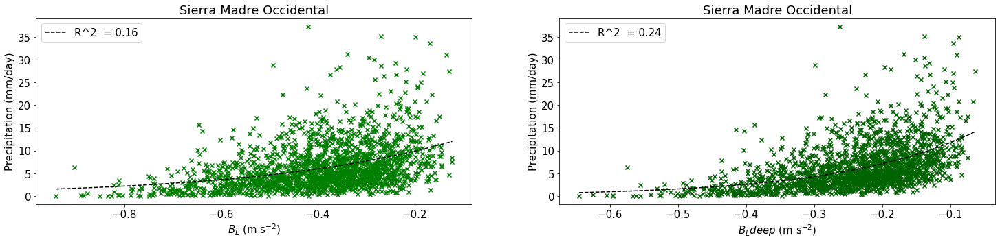

In [10]:
%%time
fig,ax = plt.subplots(1,2,figsize=(25,5))
pr = MR.vars['GPM_PR_ABOVE_DAILY']
Bl = MR.vars['BL_ABOVE_DAILY']
Bldeep = MR.vars['BLDEEP_ABOVE_DAILY']

for i,(pred,c,model) in enumerate(zip((Bl,Bldeep),('green','darkgreen'),('exponential','exponential'))):
    ax[i].scatter(pred,pr,marker='x',color=c)
    x,y,rsq = fit(pred,pr,model)
    ax[i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    ax[i].set_ylabel("Precipitation (mm/day)")
    ax[i].set_title(MR.Lname)
    ax[i].legend()
ax[0].set_xlabel(r"$B_L$ (m s$^{-2}$)")
ax[1].set_xlabel(r"$B_Ldeep$ (m s$^{-2}$)")


In [29]:
def resample_monthly(ds):
    """performs the same job as resample(time="1M") but keeps missing months out"""
    dsm = ds.resample(time='1M').mean()
    return dsm.dropna('time')

CPU times: user 168 ms, sys: 0 ns, total: 168 ms
Wall time: 166 ms


Text(0.5, 0, '$B_Ldeep$ (m s$^{-2}$)')

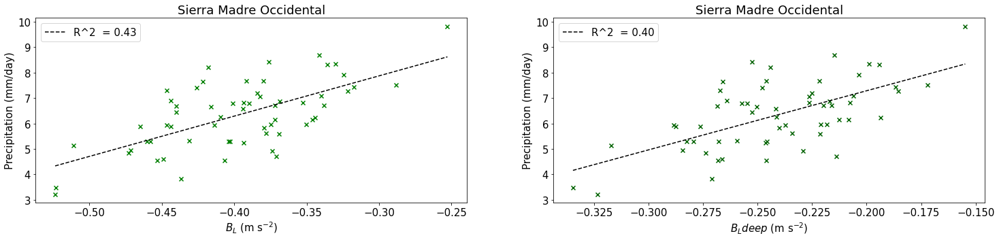

In [29]:
%%time
fig,ax = plt.subplots(1,2,figsize=(25,5))
pr = resample_monthly(MR.vars['GPM_PR_ABOVE_DAILY'])
Bl = resample_monthly(MR.vars['BL_ABOVE_DAILY'])
Bldeep = resample_monthly(MR.vars['BLDEEP_ABOVE_DAILY'])


for i,(pred,c,model) in enumerate(zip((Bl,Bldeep),('green','darkgreen'),('linear','linear'))):
    ax[i].scatter(pred,pr,marker='x',color=c)
    x,y,rsq = fit(pred,pr,model)
    ax[i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    ax[i].set_ylabel("Precipitation (mm/day)")
    ax[i].set_title(MR.Lname)
    ax[i].legend()
ax[0].set_xlabel(r"$B_L$ (m s$^{-2}$)")
ax[1].set_xlabel(r"$B_Ldeep$ (m s$^{-2}$)")


In [21]:
# Evaluating slopes theoretically
alpha = 20.6/3600*2.5e6
dBLdqL = 1/(11.3*3600)*1004*8000/alpha
dBLdTL = -1/(2.7*3600)*1004*8000/alpha
dBLdeb = 1/(11.5*3600)*1004*8000/alpha

In [22]:
from scipy.optimize import curve_fit
def linfit(pred,dep):
    predrange = np.linspace(np.min(pred),np.max(pred),41)
    func = lambda x,a,b : a*x+b
    popt,_ = curve_fit(func,pred,dep)
    fitrange = func(predrange,*popt)
    residual = dep - func(pred,*popt)
    rss = np.sum(residual**2)
    tss = len(dep)*np.var(dep)
    rsq = 1-rss/tss
    return predrange,fitrange,popt[0],rsq

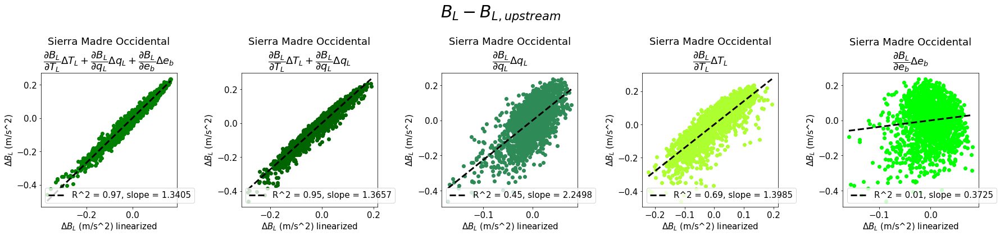

In [25]:
fig,axs = plt.subplots(1,5,figsize=(25,6))
MR=SMO
Bl_above = MR.vars['BLSIMPLE_ABOVE_DAILY']
Bl_rce = MR.vars['BLSIMPLE_ABOVE_DAILY'].mean('time')

predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time'))
predeb = dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_ABOVE_DAILY'].mean('time'))

for j,(pred,c) in enumerate(zip((predqL+predTL+predeb,predqL+predTL,predqL,predTL,predeb),('g','darkgreen','seagreen','greenyellow','lime'))):
    x,y,slope,rsq = linfit(pred,Bl_above-Bl_rce)
    axs[j].scatter(pred,Bl_above-Bl_rce,color=c)
    axs[j].plot(x,y,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(rsq,slope))
    axs[j].set_xlabel("$\Delta B_L$ (m/s^2) linearized")
    axs[j].set_ylabel(r"$\Delta B_L$ (m/s^2)")
    axs[j].legend()
axs[0].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
axs[1].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[2].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[3].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L$")
axs[4].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

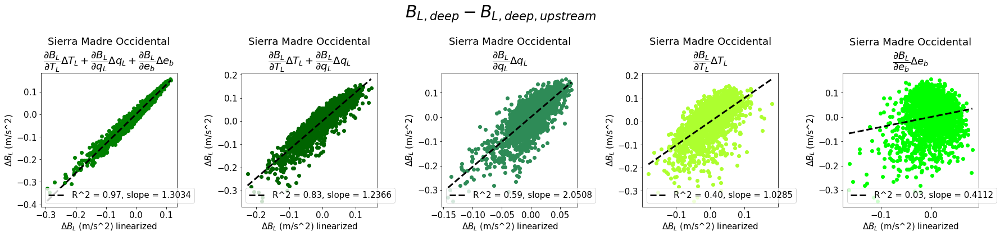

In [27]:
fig,axs = plt.subplots(1,5,figsize=(25,6))
MR=SMO
Bl_above = MR.vars['BLDEEPSIMPLE_ABOVE_DAILY']
Bl_rce = MR.vars['BLDEEPSIMPLE_ABOVE_DAILY'].mean('time')

predqL = dBLdqL*(MR.vars['QLDEEP_ABOVE_DAILY']-MR.vars['QLDEEP_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTL = dBLdTL*(MR.vars['TLDEEP_ABOVE_DAILY']-MR.vars['TLDEEP_ABOVE_DAILY'].mean('time'))
predeb = dBLdeb*(MR.vars['EBDEEP_ABOVE_DAILY']-MR.vars['EBDEEP_ABOVE_DAILY'].mean('time'))

for j,(pred,c) in enumerate(zip((predqL+predTL+predeb,predqL+predTL,predqL,predTL,predeb),('g','darkgreen','seagreen','greenyellow','lime'))):
    x,y,slope,rsq = linfit(pred,Bl_above-Bl_rce)
    axs[j].scatter(pred,Bl_above-Bl_rce,color=c)
    axs[j].plot(x,y,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(rsq,slope))
    axs[j].set_xlabel("$\Delta B_L$ (m/s^2) linearized")
    axs[j].set_ylabel(r"$\Delta B_L$ (m/s^2)")
    axs[j].legend()
axs[0].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
axs[1].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[2].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[3].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L$")
axs[4].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    
fig.suptitle(r"$B_{L,deep}-B_{L,deep,upstream}$",fontsize=30)
fig.tight_layout()

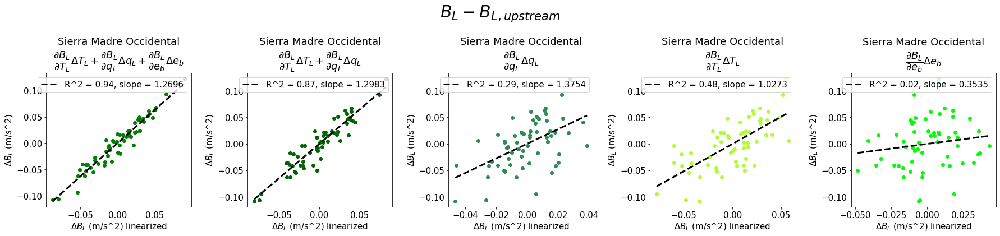

In [30]:
fig,axs = plt.subplots(1,5,figsize=(25,6))
MR=SMO
Bl_above = resample_monthly(MR.vars['BLSIMPLE_ABOVE_DAILY'])
Bl_rce = MR.vars['BLSIMPLE_ABOVE_DAILY'].mean('time')

predqL = resample_monthly(dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. )
predTL = resample_monthly(dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time')))
predeb = resample_monthly(dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_ABOVE_DAILY'].mean('time')))

for j,(pred,c) in enumerate(zip((predqL+predTL+predeb,predqL+predTL,predqL,predTL,predeb),('g','darkgreen','seagreen','greenyellow','lime'))):
    x,y,slope,rsq = linfit(pred,Bl_above-Bl_rce)
    axs[j].scatter(pred,Bl_above-Bl_rce,color=c)
    axs[j].plot(x,y,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(rsq,slope))
    axs[j].set_xlabel("$\Delta B_L$ (m/s^2) linearized")
    axs[j].set_ylabel(r"$\Delta B_L$ (m/s^2)")
    axs[j].legend()
axs[0].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
axs[1].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[2].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[3].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L$")
axs[4].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

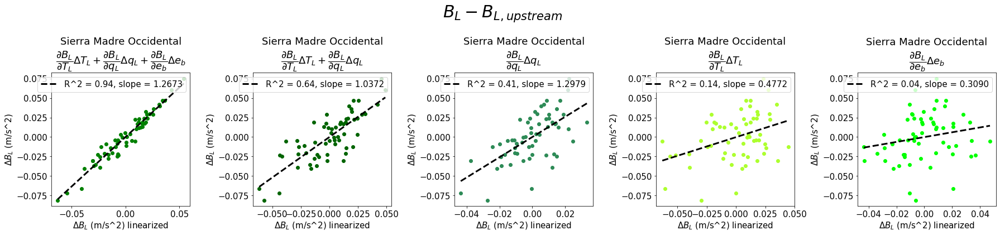

In [31]:
fig,axs = plt.subplots(1,5,figsize=(25,6))
MR=SMO
Bl_above = resample_monthly(MR.vars['BLDEEPSIMPLE_ABOVE_DAILY'])
Bl_rce = MR.vars['BLDEEPSIMPLE_ABOVE_DAILY'].mean('time')

predqL = resample_monthly(dBLdqL*(MR.vars['QLDEEP_ABOVE_DAILY']-MR.vars['QLDEEP_ABOVE_DAILY'].mean('time'))*2.5e6/1004. )
predTL = resample_monthly(dBLdTL*(MR.vars['TLDEEP_ABOVE_DAILY']-MR.vars['TLDEEP_ABOVE_DAILY'].mean('time')))
predeb = resample_monthly(dBLdeb*(MR.vars['EBDEEP_ABOVE_DAILY']-MR.vars['EBDEEP_ABOVE_DAILY'].mean('time')))

for j,(pred,c) in enumerate(zip((predqL+predTL+predeb,predqL+predTL,predqL,predTL,predeb),('g','darkgreen','seagreen','greenyellow','lime'))):
    x,y,slope,rsq = linfit(pred,Bl_above-Bl_rce)
    axs[j].scatter(pred,Bl_above-Bl_rce,color=c)
    axs[j].plot(x,y,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(rsq,slope))
    axs[j].set_xlabel("$\Delta B_L$ (m/s^2) linearized")
    axs[j].set_ylabel(r"$\Delta B_L$ (m/s^2)")
    axs[j].legend()
axs[0].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
axs[1].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[2].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
axs[3].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L$")
axs[4].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

CPU times: user 119 ms, sys: 0 ns, total: 119 ms
Wall time: 117 ms


Text(0.5, 0, '$B_Ldeep$ (m s$^{-2}$)')

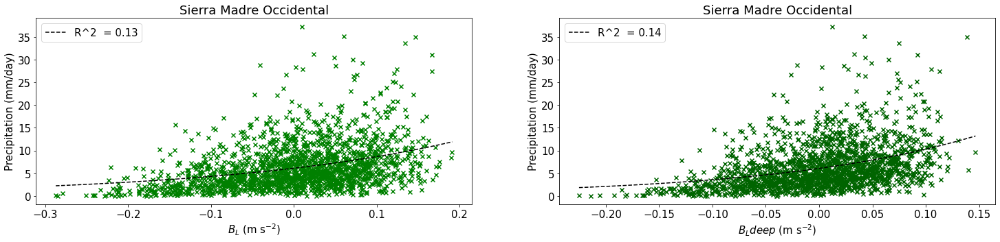

In [33]:
%%time
fig,ax = plt.subplots(1,2,figsize=(25,5))
pr = MR.vars['GPM_PR_ABOVE_DAILY']
predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time'))
predqLdeep = dBLdqL*(MR.vars['QLDEEP_ABOVE_DAILY']-MR.vars['QLDEEP_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTLdeep = dBLdTL*(MR.vars['TLDEEP_ABOVE_DAILY']-MR.vars['TLDEEP_ABOVE_DAILY'].mean('time'))

dBl = predqL+predTL
dBldeep = predqLdeep+predTLdeep

for i,(pred,c,model) in enumerate(zip((dBl,dBldeep),('green','darkgreen'),('exponential','exponential'))):
    ax[i].scatter(pred,pr,marker='x',color=c)
    x,y,rsq = fit(pred,pr,model)
    ax[i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    ax[i].set_ylabel("Precipitation (mm/day)")
    ax[i].set_title(MR.Lname)
    ax[i].legend()
ax[0].set_xlabel(r"$B_L$ (m s$^{-2}$)")
ax[1].set_xlabel(r"$B_Ldeep$ (m s$^{-2}$)")


CPU times: user 133 ms, sys: 0 ns, total: 133 ms
Wall time: 131 ms


Text(0.5, 0, '$\\dfrac{\\partial B_L}{\\partial T_L}\\Delta T_L+\\dfrac{\\partial B_L}{\\partial q_L}\\Delta q_L$$deep$ (m s$^{-2}$)')

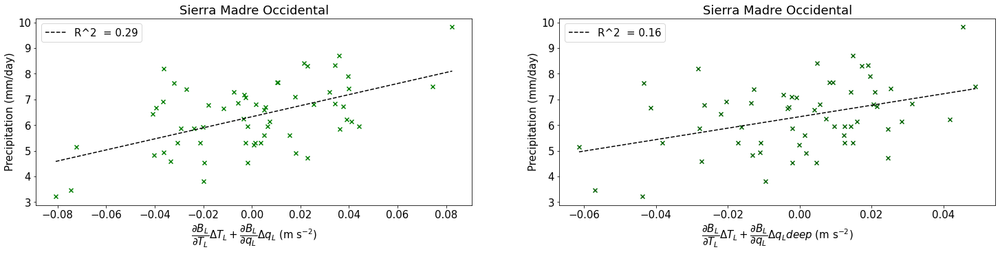

In [36]:
%%time
fig,ax = plt.subplots(1,2,figsize=(25,5))
pr = resample_monthly(MR.vars['GPM_PR_ABOVE_DAILY'])
predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time'))
predqLdeep = dBLdqL*(MR.vars['QLDEEP_ABOVE_DAILY']-MR.vars['QLDEEP_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTLdeep = dBLdTL*(MR.vars['TLDEEP_ABOVE_DAILY']-MR.vars['TLDEEP_ABOVE_DAILY'].mean('time'))

dBl = resample_monthly(predqL+predTL)
dBldeep = resample_monthly(predqLdeep+predTLdeep)

for i,(pred,c,model) in enumerate(zip((dBl,dBldeep),('green','darkgreen'),('linear','linear'))):
    ax[i].scatter(pred,pr,marker='x',color=c)
    x,y,rsq = fit(pred,pr,model)
    ax[i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    ax[i].set_ylabel("Precipitation (mm/day)")
    ax[i].set_title(MR.Lname)
    ax[i].legend()
lbl = "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$"
ax[0].set_xlabel(lbl+r" (m s$^{-2}$)")
ax[1].set_xlabel(lbl+ r"$deep$ (m s$^{-2}$)")


CPU times: user 174 ms, sys: 4.87 ms, total: 178 ms
Wall time: 177 ms


Text(0.5, 0, '$\\dfrac{\\partial B_L}{\\partial T_L}\\Delta T_L+\\dfrac{\\partial B_L}{\\partial q_L}\\Delta q_L+\\dfrac{\\partial B_L}{\\partial e_b}\\Delta e_b$$deep$ (m s$^{-2}$)')

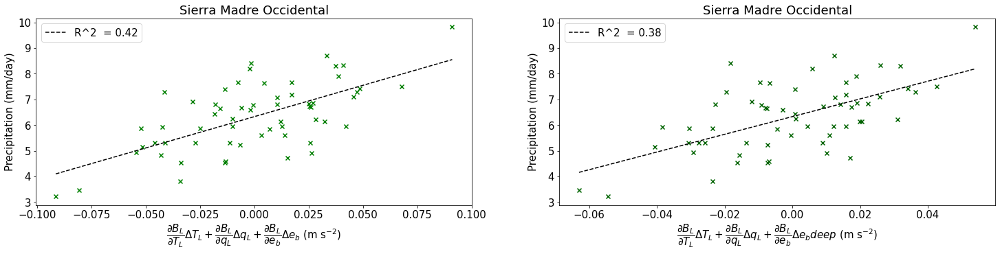

In [39]:
%%time
fig,ax = plt.subplots(1,2,figsize=(25,5))
pr = resample_monthly(MR.vars['GPM_PR_ABOVE_DAILY'])
predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time'))
predeb = dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_ABOVE_DAILY'].mean('time'))

predqLdeep = dBLdqL*(MR.vars['QLDEEP_ABOVE_DAILY']-MR.vars['QLDEEP_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
predTLdeep = dBLdTL*(MR.vars['TLDEEP_ABOVE_DAILY']-MR.vars['TLDEEP_ABOVE_DAILY'].mean('time'))
predebdeep = dBLdeb*(MR.vars['EBDEEP_ABOVE_DAILY']-MR.vars['EBDEEP_ABOVE_DAILY'].mean('time'))


dBl = resample_monthly(predqL+predTL+predebdeep)
dBldeep = resample_monthly(predqLdeep+predTLdeep+predebdeep)

for i,(pred,c,model) in enumerate(zip((dBl,dBldeep),('green','darkgreen'),('linear','linear'))):
    ax[i].scatter(pred,pr,marker='x',color=c)
    x,y,rsq = fit(pred,pr,model)
    ax[i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    ax[i].set_ylabel("Precipitation (mm/day)")
    ax[i].set_title(MR.Lname)
    ax[i].legend()
lbl = "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$"
ax[0].set_xlabel(lbl+r" (m s$^{-2}$)")
ax[1].set_xlabel(lbl+ r"$deep$ (m s$^{-2}$)")
